In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.lines as mlines
import seaborn as sns
import missingno as msno
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.compose import ColumnTransformer
from sklearn.tree import DecisionTreeClassifier, DecisionTreeRegressor
from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor
from sklearn.metrics import mean_absolute_error as mae
from sklearn.metrics import mean_squared_error as mse
from sklearn.metrics import r2_score as r2
from sklearn.metrics import make_scorer
from sklearn.tree import plot_tree
from sklearn.model_selection import GridSearchCV
from lightgbm import LGBMRegressor, LGBMClassifier
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from math import floor
from sklearn.metrics import precision_score, recall_score, f1_score
from sklearn.metrics import roc_auc_score, roc_curve, confusion_matrix, classification_report
import warnings

In [2]:
warnings.filterwarnings("ignore")

# Regression problem

Below, we will outline the data preparation and preprocessing process, following the same approach as in the Air Quality Dataset Regression task. Applying a consistent data preparation methodology is advantageous as the dataset has been well-prepared previously. Additionally, using a similar data preparation process makes it easier to compare model results in this analysis, ensuring a fair comparison across models with similarly processed data.

In [3]:
df = pd.read_csv("data/AirQualityUCI.csv", sep=";")

In [4]:
df.head().T

,0,1,2,3,4
Date,10/03/2004,10/03/2004,10/03/2004,10/03/2004,10/03/2004
Time,18.00.00,19.00.00,20.00.00,21.00.00,22.00.00
CO(GT),"2,6",2,"2,2","2,2","1,6"
PT08.S1(CO),1360.0,1292.0,1402.0,1376.0,1272.0
NMHC(GT),150.0,112.0,88.0,80.0,51.0
C6H6(GT),"11,9","9,4","9,0","9,2","6,5"
PT08.S2(NMHC),1046.0,955.0,939.0,948.0,836.0
NOx(GT),166.0,103.0,131.0,172.0,131.0
PT08.S3(NOx),1056.0,1174.0,1140.0,1092.0,1205.0
NO2(GT),113.0,92.0,114.0,122.0,116.0


## Data Preprocessing and Preparation

### Droping unnamed features

In [5]:
def drop_features(features):
    df.drop(columns=features, inplace=True)  

In [6]:
drop_features(["Unnamed: 15", "Unnamed: 16"])

### Replacing "-200.0" as NaN values

In [7]:
df.replace(-200, np.NaN, inplace=True)
df.replace("-200", np.NaN, inplace=True)
df.replace("-200,0", np.NaN, inplace=True)
df.replace("-200.0", np.NaN, inplace=True)

### Features names modifications

In [8]:
for feature in ["C6H6(GT)", "CO(GT)", "T", "RH", "AH"]:
    df[feature] = df[feature].str.replace(",", ".")
    df[feature] = df[feature].astype(np.float64)

### Drop instances with all NaN values

In [9]:
df.dropna(how="all", inplace=True)

### Count number of missing values per feature

In [10]:
df.T

,0,1,2,3,4,5,6,7,8,9,...,9347,9348,9349,9350,9351,9352,9353,9354,9355,9356
Date,10/03/2004,10/03/2004,10/03/2004,10/03/2004,10/03/2004,10/03/2004,11/03/2004,11/03/2004,11/03/2004,11/03/2004,...,04/04/2005,04/04/2005,04/04/2005,04/04/2005,04/04/2005,04/04/2005,04/04/2005,04/04/2005,04/04/2005,04/04/2005
Time,18.00.00,19.00.00,20.00.00,21.00.00,22.00.00,23.00.00,00.00.00,01.00.00,02.00.00,03.00.00,...,05.00.00,06.00.00,07.00.00,08.00.00,09.00.00,10.00.00,11.00.00,12.00.00,13.00.00,14.00.00
CO(GT),2.6,2.0,2.2,2.2,1.6,1.2,1.2,1.0,0.9,0.6,...,0.5,1.1,4.0,5.0,3.9,3.1,2.4,2.4,2.1,2.2
PT08.S1(CO),1360.0,1292.0,1402.0,1376.0,1272.0,1197.0,1185.0,1136.0,1094.0,1010.0,...,888.0,1031.0,1384.0,1446.0,1297.0,1314.0,1163.0,1142.0,1003.0,1071.0
NMHC(GT),150.0,112.0,88.0,80.0,51.0,38.0,31.0,31.0,24.0,19.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
C6H6(GT),11.9,9.4,9.0,9.2,6.5,4.7,3.6,3.3,2.3,1.7,...,1.3,4.4,17.4,22.4,13.6,13.5,11.4,12.4,9.5,11.9
PT08.S2(NMHC),1046.0,955.0,939.0,948.0,836.0,750.0,690.0,672.0,609.0,561.0,...,528.0,730.0,1221.0,1362.0,1102.0,1101.0,1027.0,1063.0,961.0,1047.0
NOx(GT),166.0,103.0,131.0,172.0,131.0,89.0,62.0,62.0,45.0,NaN,...,77.0,182.0,594.0,586.0,523.0,472.0,353.0,293.0,235.0,265.0
PT08.S3(NOx),1056.0,1174.0,1140.0,1092.0,1205.0,1337.0,1462.0,1453.0,1579.0,1705.0,...,1077.0,760.0,470.0,415.0,507.0,539.0,604.0,603.0,702.0,654.0
NO2(GT),113.0,92.0,114.0,122.0,116.0,96.0,77.0,76.0,60.0,NaN,...,53.0,93.0,155.0,174.0,187.0,190.0,179.0,175.0,156.0,168.0


<Axes: >

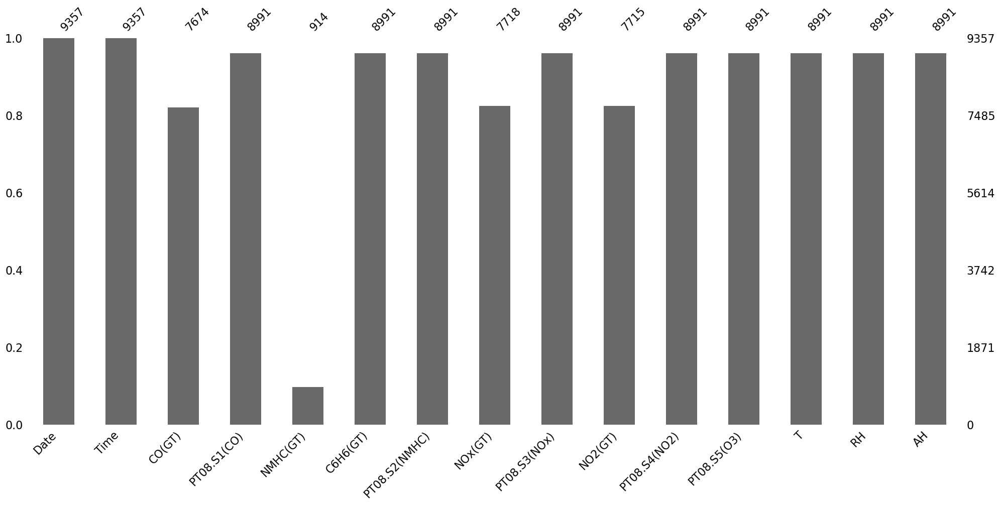

In [11]:
msno.bar(df)

### Drop 'NMHC(GT)' feature

Due to the fact that only slightly less than 10% of the data in the NMHC(GT) feature is non-NaN, we can consider removing it entirely.

In [12]:
drop_features(["NMHC(GT)"])

### Drop rows containing missing values in the target feature

In [13]:
df = df[df["C6H6(GT)"].notna()]

### Create 'Hour' and 'Month' features

We can extract two new features, Hour and Month, which will be needed in model analysis.

In [14]:
df["Hour"] = df["Time"].apply(lambda x: int(x.split(".")[0]))
drop_features(["Time"])
df["Date"] = pd.to_datetime(df["Date"], format="%d/%m/%Y")
df.set_index("Date", inplace=True)
df["Month"] = df.index.month

### Fill NaN values using Forward Fill

We can impute the remaining features by utilizing a method that carries forward the last valid observation to the next valid one. It is crucial to arrange the data chronologically by date before applying this technique. This method proves effective in dealing with missing values as it avoids relying on global averages or medians for the entire dataset. 

In [15]:
df = df.sort_values(by=["Date", "Hour"])

In [16]:
df.fillna(method="ffill", inplace=True)

### Drop 'Date' feature

In [17]:
df.reset_index(inplace=True)
drop_features(["Date"])

### Feature Division

In [18]:
target = "C6H6(GT)"
target_feature = [target]
categorical_features = ["Month", "Hour"]
numerical_features = [col for col in df.columns if col not in (categorical_features + target_feature)]

In [19]:
df[target_feature]

,C6H6(GT)
0,11.9
1,9.4
2,9.0
3,9.2
4,6.5
...,...
8986,13.5
8987,11.4
8988,12.4
8989,9.5


In [20]:
df[categorical_features]

,Month,Hour
0,3,18
1,3,19
2,3,20
3,3,21
4,3,22
...,...,...
8986,4,10
8987,4,11
8988,4,12
8989,4,13


In [21]:
df[numerical_features]

,CO(GT),PT08.S1(CO),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH
0,2.6,1360.0,1046.0,166.0,1056.0,113.0,1692.0,1268.0,13.6,48.9,0.7578
1,2.0,1292.0,955.0,103.0,1174.0,92.0,1559.0,972.0,13.3,47.7,0.7255
2,2.2,1402.0,939.0,131.0,1140.0,114.0,1555.0,1074.0,11.9,54.0,0.7502
3,2.2,1376.0,948.0,172.0,1092.0,122.0,1584.0,1203.0,11.0,60.0,0.7867
4,1.6,1272.0,836.0,131.0,1205.0,116.0,1490.0,1110.0,11.2,59.6,0.7888
...,...,...,...,...,...,...,...,...,...,...,...
8986,3.1,1314.0,1101.0,472.0,539.0,190.0,1374.0,1729.0,21.9,29.3,0.7568
8987,2.4,1163.0,1027.0,353.0,604.0,179.0,1264.0,1269.0,24.3,23.7,0.7119
8988,2.4,1142.0,1063.0,293.0,603.0,175.0,1241.0,1092.0,26.9,18.3,0.6406
8989,2.1,1003.0,961.0,235.0,702.0,156.0,1041.0,770.0,28.3,13.5,0.5139


<Axes: >

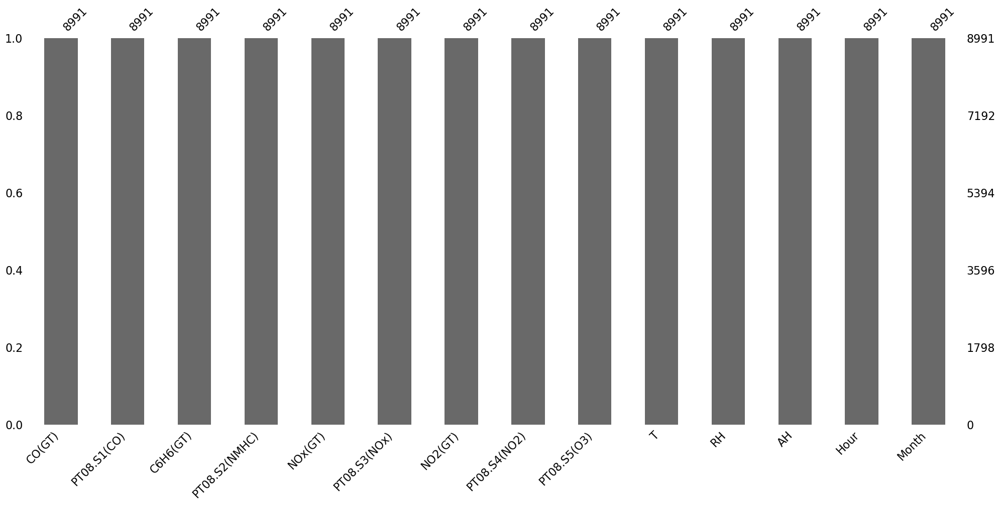

In [22]:
msno.bar(df)

### Nonlinear Transformations

In [23]:
def get_extended_description(df):
    extended_describe = df.describe().T
    extended_describe["IQR"] = extended_describe["75%"] - extended_describe["25%"]
    extended_describe["lower_limit"] = extended_describe["25%"] - 1.5*extended_describe["IQR"]
    extended_describe["upper_limit"] = extended_describe["75%"] + 1.5*extended_describe["IQR"]
    return extended_describe


def descriptive_plots(df, include_target=True, n_rows=4, n_cols=3):
    fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(15, 12))
    axes = axes.flatten()
    numerical = numerical_features + target_feature if include_target else numerical_features
    extended_describe = get_extended_description(df[numerical])
    
    for i, feature in enumerate(numerical):
        g = sns.histplot(data=df, x=feature, ax=axes[i], kde=True)

        axes[i].axvline(extended_describe.loc[feature, "upper_limit"], linewidth=2 , color="red")
        axes[i].axvline(extended_describe.loc[feature, "lower_limit"], linewidth=2 , color="red")
        axes[i].axvline(extended_describe.loc[feature, "mean"], linewidth=3 , color="yellow")
        axes[i].axvline(extended_describe.loc[feature, "50%"], linewidth=3 , color="magenta")
        g.set(ylabel=None)

    limits = mlines.Line2D([], [], color="red", linewidth=1, label="upper limit / lower limit")
    mean = mlines.Line2D([], [], color="yellow", linewidth=1, label="mean")
    median = mlines.Line2D([], [], color="magenta", linewidth=1, label="median")

    plt.legend(handles=[limits, mean, median], loc="center left", bbox_to_anchor=(1, 0.5))
    plt.suptitle("Numerical Features Histograms", fontsize=16)
    fig.text(0, 0.5, "Count", va="center", rotation="vertical", fontsize=16)

    plt.tight_layout()
    plt.show()

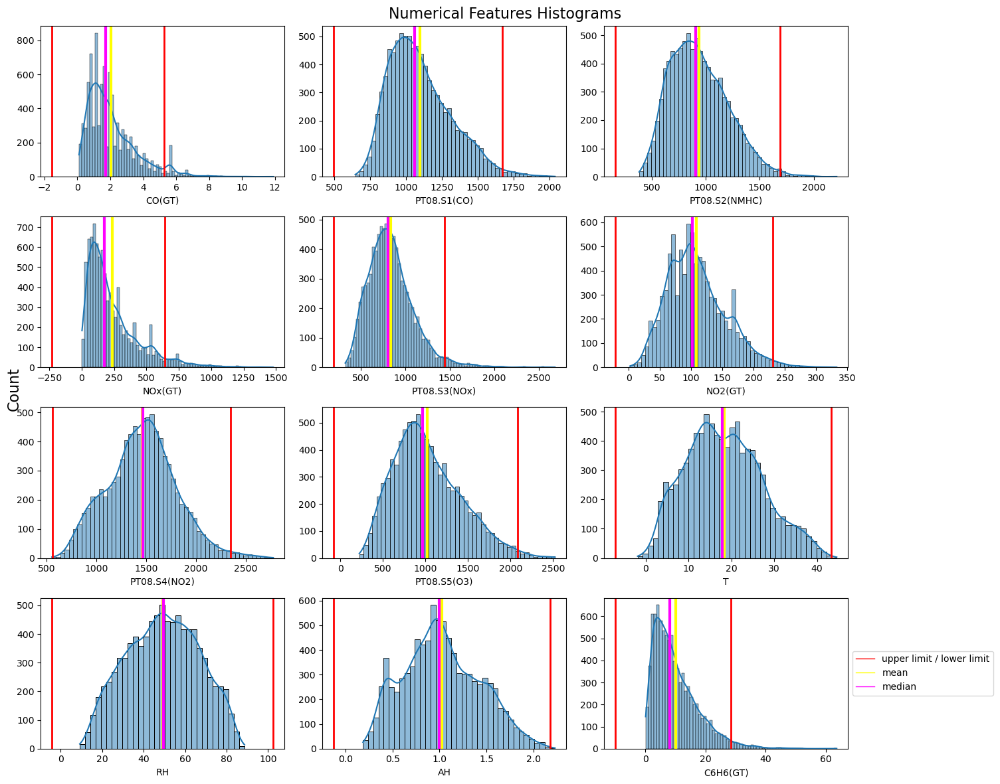

In [24]:
descriptive_plots(df)

Observing the histograms of numerical features, we can reduce skewness by applying a logarithmic transformation.

In [25]:
features_with_skewness = ["CO(GT)", "PT08.S1(CO)", "PT08.S2(NMHC)", "NOx(GT)", 
                          "PT08.S3(NOx)", "NO2(GT)", "PT08.S5(O3)", "C6H6(GT)"]
df[features_with_skewness] = df[features_with_skewness].apply(lambda x: np.log(x))

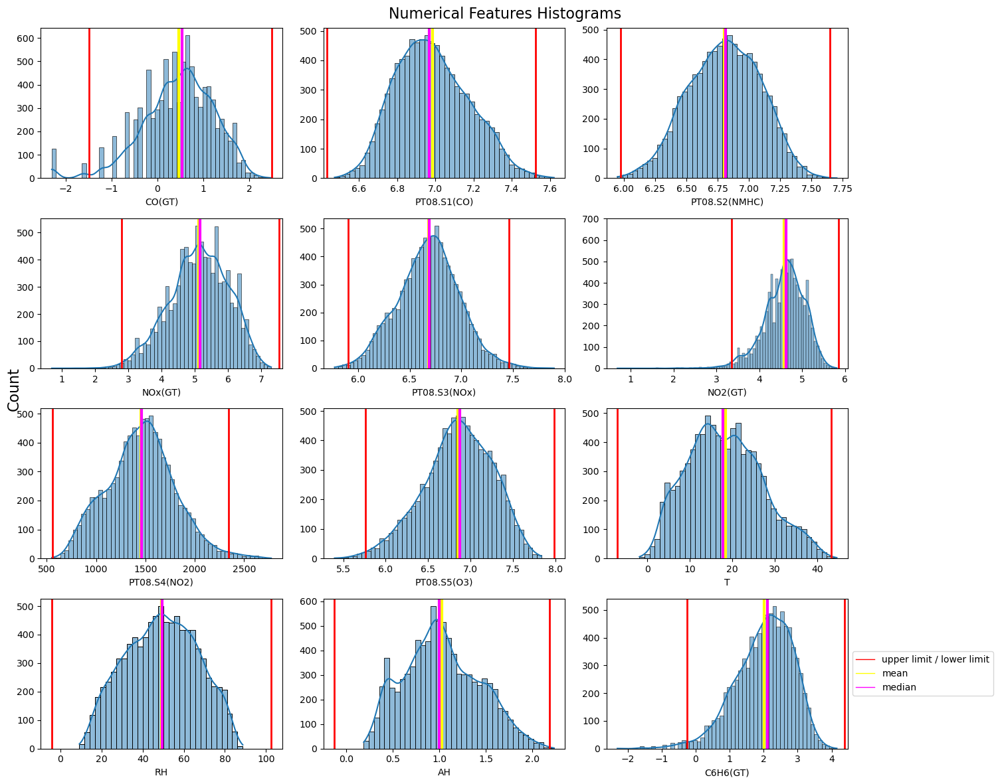

In [26]:
descriptive_plots(df)

### Train Test Split

In [27]:
y = df.pop("C6H6(GT)")

In [28]:
X_train, X_test, y_train, y_test = train_test_split(df, y, test_size=0.2, random_state=100)

In [29]:
X_train

,CO(GT),PT08.S1(CO),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH,Hour,Month
3844,0.530628,6.748760,6.523562,4.174387,6.938284,4.219508,1368.0,6.124683,29.0,34.1,1.3445,10,8
4191,0.955511,7.015712,7.003974,6.006353,6.496775,4.564348,1632.0,6.963190,29.6,27.7,1.1278,18,9
8727,0.693147,7.149132,6.895683,5.662960,6.333280,4.812184,1387.0,7.136483,24.1,33.3,0.9881,15,3
7890,0.336472,6.930495,6.647688,5.356586,6.693324,4.962845,982.0,6.599870,9.3,42.3,0.4974,17,2
6053,0.587787,7.029973,6.818924,6.146329,6.546785,4.663439,1281.0,7.094235,10.6,80.3,1.0252,3,11
...,...,...,...,...,...,...,...,...,...,...,...,...,...
350,0.993252,7.185387,6.942157,5.214936,6.804615,4.718499,1721.0,6.898715,8.7,74.6,0.8429,8,3
79,1.029619,7.302496,6.951772,5.159055,6.779922,4.779123,1624.0,7.333023,14.6,51.5,0.8536,1,3
8039,0.955511,7.043160,6.869014,5.968708,6.487684,5.420535,1212.0,7.083388,4.3,78.9,0.6621,22,2
6936,1.568616,7.368340,7.152269,6.739337,6.122493,5.153292,1567.0,7.572503,9.8,65.8,0.7967,10,1


In [30]:
X_test

,CO(GT),PT08.S1(CO),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH,Hour,Month
8448,-2.302585,6.924612,6.463029,5.056246,6.793466,4.672829,1044.0,6.177944,12.5,55.4,0.7999,0,3
5948,1.974081,7.327123,7.265430,6.538140,6.107023,5.231109,1907.0,7.473637,17.3,58.2,1.1435,18,11
5053,0.182322,6.854355,6.748760,5.638355,6.755769,4.276666,1283.0,6.732211,17.4,47.6,0.9387,11,10
4839,1.722767,7.156177,7.128496,6.291569,6.329721,5.129899,1829.0,7.158514,26.0,44.5,1.4731,13,10
8976,-0.105361,6.919684,6.526495,4.762174,6.685861,4.532599,1073.0,6.704414,14.2,51.4,0.8275,0,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
3923,0.530628,6.961296,6.831954,4.465908,6.629363,4.499810,1520.0,6.573680,36.9,20.9,1.2864,17,8
4876,1.722767,6.856462,6.610696,6.291569,6.734592,5.129899,1377.0,6.796824,19.3,68.4,1.5130,2,10
5733,1.308333,7.052721,7.097549,6.222576,6.419995,5.176150,1467.0,7.130899,10.6,59.3,0.7588,19,11
4214,0.832909,6.944087,6.928538,5.365976,6.616065,4.488636,1451.0,6.666957,31.7,20.3,0.9336,17,9


### Standardization

For such prepared numerical data, we can apply standardization. It's worth mentioning that there is no need to standardize the target feature since it's just a scaling of the data. It will be also easier to apply only the inverse transformation when evaluating the results.

In [31]:
std_scaler = StandardScaler().fit(X_train[numerical_features])
X_train_scaled = std_scaler.transform(X_train[numerical_features])
X_test_scaled = std_scaler.transform(X_test[numerical_features])

X_train_num = pd.DataFrame(X_train_scaled, columns=numerical_features, index=X_train.index)
X_test_num = pd.DataFrame(X_test_scaled, columns=numerical_features, index=X_test.index)
X_train = pd.concat([X_train_num, X_train[categorical_features]], axis=1)
X_test = pd.concat([X_test_num, X_test[categorical_features]], axis=1)

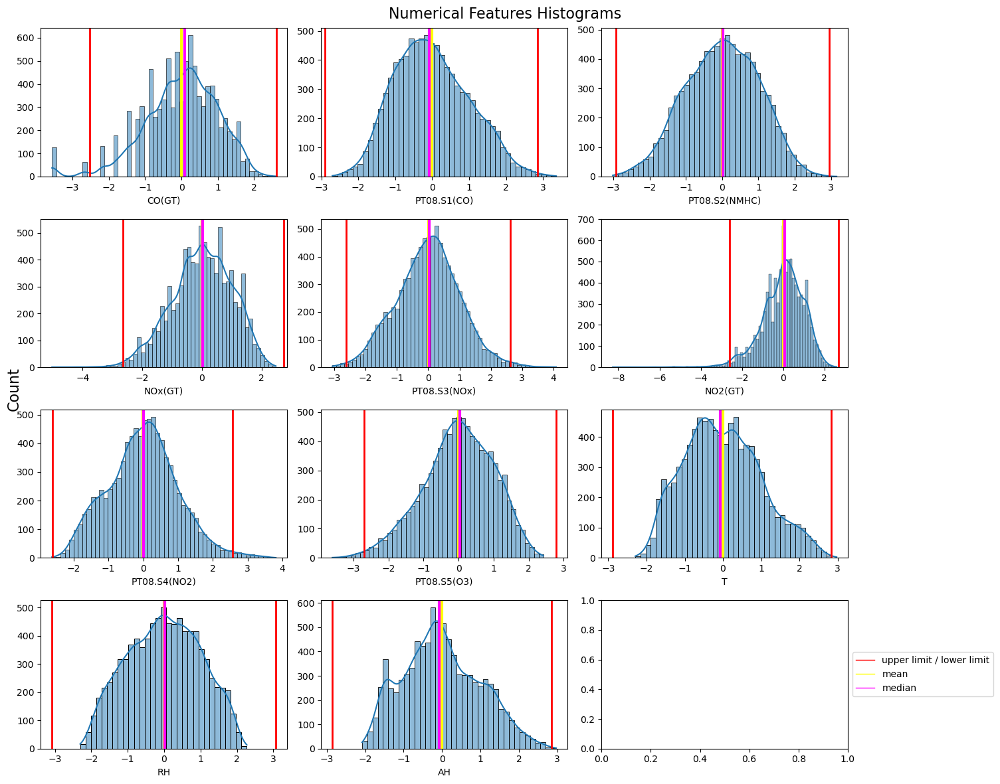

In [32]:
descriptive_plots(pd.concat([X_train, X_test], axis=0, ignore_index=True), include_target=False)

- transformed (w/o standardization) target feature histogram

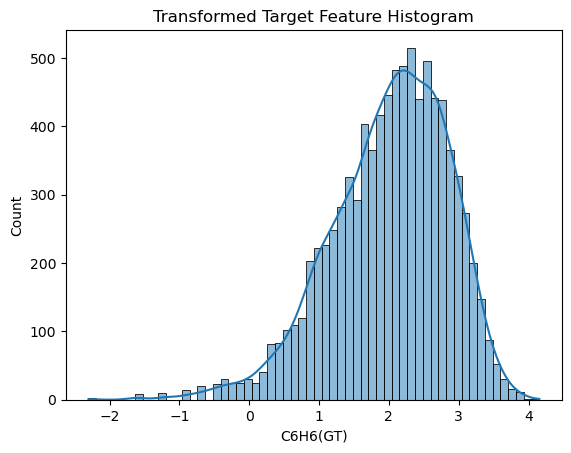

In [33]:
sns.histplot(y, kde=True)
plt.title("Transformed Target Feature Histogram")
plt.show()

### Categorical Data Encoding

In [34]:
oh_encoder = OneHotEncoder(drop="first", sparse=False)

preprocessor = ColumnTransformer(
    transformers=[
        ("cat", oh_encoder, categorical_features)
    ])

X_train_cat_enc = preprocessor.fit_transform(X_train)
X_test_cat_enc = preprocessor.transform(X_test)

oh_feature_names = preprocessor.named_transformers_["cat"].get_feature_names_out(input_features=categorical_features)

X_train_cat_enc = pd.DataFrame(X_train_cat_enc, columns=oh_feature_names, index=X_train.index)
X_test_cat_enc = pd.DataFrame(X_test_cat_enc, columns=oh_feature_names, index=X_test.index)

X_train = pd.concat([X_train_num, X_train_cat_enc], axis=1)
X_test = pd.concat([X_test_num, X_test_cat_enc], axis=1)

In [35]:
X_train.T

,3844,4191,8727,7890,6053,6106,6657,5302,1361,2908,...,4376,802,5646,7906,4149,350,79,8039,6936,5640
CO(GT),0.088771,0.636599,0.298317,-0.161566,0.162469,1.285281,0.478520,1.223871,0.162469,-1.055282,...,-1.055282,1.159389,-0.360321,0.586029,1.671112,0.685260,0.732151,0.636599,1.427111,0.162469
PT08.S1(CO),-1.243354,0.163999,0.867374,-0.285261,0.239179,1.760478,-0.357907,1.417439,-1.019498,-1.865841,...,-0.731344,1.432342,-1.237177,0.498618,1.364944,1.058509,1.675900,0.308700,2.023020,-0.053381
PT08.S2(NMHC),-0.993468,0.696633,0.315661,-0.556789,0.045622,1.488679,0.087663,1.089272,0.177681,-1.050757,...,-0.836861,1.131881,-0.896659,0.250976,1.918034,0.479157,0.512985,0.221841,1.218337,-0.024275
NOx(GT),-1.071729,1.010606,0.620283,0.272037,1.169712,1.869039,1.228988,1.152545,-0.433137,-1.369950,...,-0.473737,0.517066,-0.605036,1.193795,1.010606,0.111028,0.047510,0.967815,1.843764,0.454889
PT08.S3(NOx),0.863896,-0.625159,-1.176570,0.037730,-0.456491,-1.603897,-0.029809,-1.444530,0.552248,0.989121,...,0.626765,-0.594774,0.692796,-0.824223,-1.764032,0.413075,0.329796,-0.655819,-1.887479,-0.305099
NO2(GT),-0.780671,-0.048529,0.477660,0.797532,0.161854,0.706527,1.049250,0.371481,0.059267,-1.803678,...,-1.391459,-0.093228,-1.192890,1.499143,-0.048529,0.278753,0.407468,1.769270,1.201876,-0.357461
PT08.S4(NO2),-0.258491,0.505335,-0.203518,-1.375297,-0.510206,0.895928,-1.279818,1.144750,0.007691,-0.267171,...,0.120529,1.341493,-0.886332,-0.819787,1.720512,0.762837,0.482189,-0.709842,0.317272,-0.270064
PT08.S5(O3),-1.807061,0.268576,0.697546,-0.630784,0.592964,1.243210,0.321862,0.990637,-0.916037,-0.794362,...,-0.276777,0.969554,-0.878530,0.588852,1.373970,0.108974,1.184060,0.566114,1.776868,0.126397
T,1.205387,1.273338,0.650451,-1.025682,-0.878454,-0.946406,-1.195561,0.367320,0.163466,-0.198941,...,0.254068,-0.855804,-0.153640,-1.127609,1.092134,-1.093634,-0.425445,-1.591943,-0.969056,0.084190
RH,-0.872496,-1.241058,-0.918566,-0.400276,1.788061,1.482845,-0.417552,1.062454,-1.125883,0.434747,...,1.551951,0.849379,0.175602,-0.267824,-1.160435,1.459810,0.129532,1.707438,0.953037,0.572958


In [36]:
X_test.T

,8448,5948,5053,4839,8976,3417,2631,3335,7470,6105,...,8190,3304,5530,3461,1389,3923,4876,5733,4214,4017
CO(GT),-3.564261,1.949902,-0.360321,1.625867,-0.731247,-3.564261,0.162469,-0.883112,-0.072609,0.088771,...,-1.776828,-0.883112,0.982488,-3.564261,-1.489116,0.088771,1.625867,1.091513,0.478520,-0.472510
PT08.S1(CO),-0.316273,1.805731,-0.686666,0.904514,-0.342255,0.317900,-0.009182,-0.759461,-0.931386,0.182895,...,-1.555242,0.078120,1.042509,0.817442,-0.259557,-0.122880,-0.675556,0.359105,-0.213603,0.020080
PT08.S2(NMHC),-1.206424,1.616440,-0.201218,1.134703,-0.983151,0.354613,0.389653,-0.288913,-0.668040,0.045622,...,-2.158637,0.622362,1.326843,0.800528,0.218182,0.091460,-0.686929,1.025831,0.431246,0.287059
NOx(GT),-0.069350,1.615070,0.592314,1.334801,-0.403611,0.060501,-0.374834,-0.821592,0.329536,0.973614,...,-0.879157,-0.423210,1.467745,-0.864490,-2.070348,-0.740367,1.334801,1.256379,0.282710,-1.392913
PT08.S3(NOx),0.375475,-1.939654,0.248336,-1.188573,0.012561,-0.456491,-0.133724,0.046079,0.494347,-0.295859,...,1.545739,-0.379946,-1.329759,-1.212706,0.453956,-0.177985,0.176913,-0.884110,-0.222835,-0.544734
NO2(GT),0.181790,1.367092,-0.659316,1.152210,-0.115936,1.009315,0.545606,-0.516771,0.737297,-0.070761,...,-0.630031,0.675304,-0.306908,-0.749676,-2.315697,-0.185553,1.152210,1.250407,-0.209275,-0.909385
PT08.S4(NO2),-1.195913,1.300987,-0.504419,1.075311,-1.112008,0.956687,0.788876,0.314379,-1.757209,-0.487060,...,-2.196988,0.412750,1.165003,1.613461,0.129209,0.181288,-0.232451,0.027944,-0.018349,0.566094
PT08.S5(O3),-1.675220,1.532136,-0.303189,0.752081,-0.371997,-0.088539,-0.461572,-0.490043,-0.783592,0.273255,...,-1.012368,-0.417924,0.848426,0.942947,-0.938817,-0.695616,-0.143247,0.683722,-0.464719,-0.066991
T,-0.663275,-0.119664,-0.108339,0.865630,-0.470746,1.850924,2.202006,0.831654,-1.286162,-1.025682,...,-2.226156,2.156705,-0.142315,0.673101,-0.063038,2.100079,0.106840,-0.878454,1.511168,1.499842
RH,0.354124,0.515370,-0.095061,-0.273583,0.123773,-0.987672,-1.528997,-0.141131,-0.907049,1.592262,...,-0.169925,-1.793901,1.356152,0.503853,-0.619110,-1.632655,1.102766,0.578717,-1.667208,-0.837943


---

## Modeling

Now, let's proceed with modeling our regression model. We will utilize the Decision Tree Regressor, Random Forest Regressor, and LightGBM Regressor. Below, functions for evaluating the models will be implemented.

In [37]:
def target_feature_values(model, X_train_copy, X_test_copy, y_train, y_test):
    y_train_pred = model.predict(X_train_copy)
    y_test_pred = model.predict(X_test_copy)

    # back to nominal value unit for the target feature (exponential transformation)
    y_train = np.exp(y_train)
    y_test = np.exp(y_test)
    y_train_pred = np.exp(y_train_pred)
    y_test_pred = np.exp(y_test_pred)
    
    return y_train, y_train_pred, y_test, y_test_pred

In [38]:
def plot_error_distribution(y_test, y_test_pred):
    errors = y_test - y_test_pred
    plt.figure(figsize=(10, 5))
    sns.scatterplot(x=y_test_pred, y=errors)
    plt.axhline(y=0, color="magenta")
    plt.xlabel("Predicted Values in Test Data")
    plt.ylabel("Errors")
    plt.title(f"Error Distribution")
    plt.grid()
    plt.tight_layout()
    plt.show()

In [39]:
def decision_tree_evaluation(model, X_train, X_test, y_train, y_test, nmhc_feature=True, print_tree=True):
    X_train_copy = X_train.copy(deep=True)
    X_test_copy = X_test.copy(deep=True)
    num_features = numerical_features[::]
    n_rows = 6
    n_cols = 2
    
    if not nmhc_feature:
        X_train_copy.pop("PT08.S2(NMHC)")
        X_test_copy.pop("PT08.S2(NMHC)")
        num_features.remove("PT08.S2(NMHC)")
        n_rows = 5
    
    model.fit(X_train_copy, y_train)
    y_train, y_train_pred, y_test, y_test_pred = target_feature_values(model, X_train_copy, X_test_copy, y_train, y_test)
    
    rmse_train = mse(y_train, y_train_pred, squared=False)
    rmse_test = mse(y_test, y_test_pred, squared=False)
    print(f"Train RMSE: {rmse_train:.2f}")
    print(f"Test RMSE: {rmse_test:.2f}", end="\n\n")
    
    mae_train = mae(y_train, y_train_pred)
    mae_test = mae(y_test, y_test_pred)
    print(f"Train MAE: {mae_train:.2f}")
    print(f"Test MAE: {mae_test:.2f}", end="\n\n")
    
    r2_train = r2(y_train, y_train_pred)
    r2_test = r2(y_test, y_test_pred)
    print(f"Train R-squared: {r2_train:.2f}")
    print(f"Test R-squared: {r2_test:.2f}", end="\n\n")
    
    fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(15, 20))
    axes = axes.flatten()
    for i, feature in enumerate(num_features):
        df_pred = pd.DataFrame(np.linspace(X_test_copy.iloc[:, i].min(), X_test_copy.iloc[:, i].max(), num=X_test_copy.iloc[:, i].shape[0], endpoint=True),
                               columns=[X_test_copy.columns[i]])
        sns.scatterplot(x=X_test_copy.iloc[:, i], y=y_test, color="blue", alpha=0.2, ax=axes[i], label="Actual value")
        sns.scatterplot(x=X_test_copy.iloc[:, i], y=y_test_pred, color="orange", alpha=0.15, ax=axes[i], label="Predicted value")
        axes[i].legend()
        
    plt.tight_layout()
    plt.show()
    
    print()
    
    plot_error_distribution(y_test, y_test_pred)
    
    print()
    
    if print_tree:
        _, ax = plt.subplots(figsize=(20, 12))
        _ = plot_tree(model, ax=ax, feature_names=X_train_copy.columns.tolist())

In [40]:
def plot_feature_importance(model, head, model_name):
    columns = X_train.columns
    importance_values = np.abs(model.coef_)
    indices = np.argsort(importance_values)[::-1][:head]
    
    plt.figure(figsize=(10, 7))
    sns.barplot(x=np.array(columns)[indices], y=importance_values[indices])
    plt.xticks(rotation=90)
    plt.xlabel("Feature Name")
    plt.ylabel("Feature Importance")
    plt.title(f"Top most important features for {model_name}")
    plt.tight_layout()
    plt.show()

### Decision Tree Regressor 

For this model, an analysis will be presented for various hyperparameters, demonstrating how the results change with different settings.

**IMPORTANT:** Analyses will be conducted separately for the dataset with the feature 'PT08.S2(NMHC)' and without it, similar to the investigations conducted in the regression task.

#### max_depth = 2 with feature 'PT08.S2(NMHC)'

In [41]:
tree_regressor = DecisionTreeRegressor(max_depth=2, random_state=0)

Train RMSE: 3.44
Test RMSE: 3.66

Train MAE: 2.11
Test MAE: 2.19

Train R-squared: 0.78
Test R-squared: 0.77



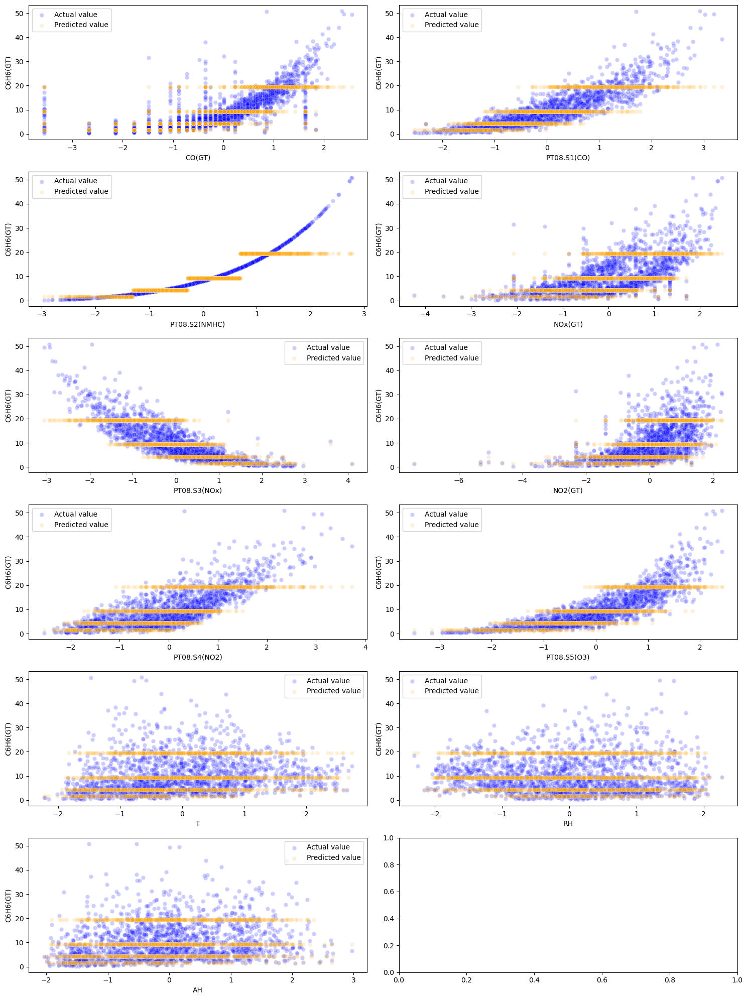

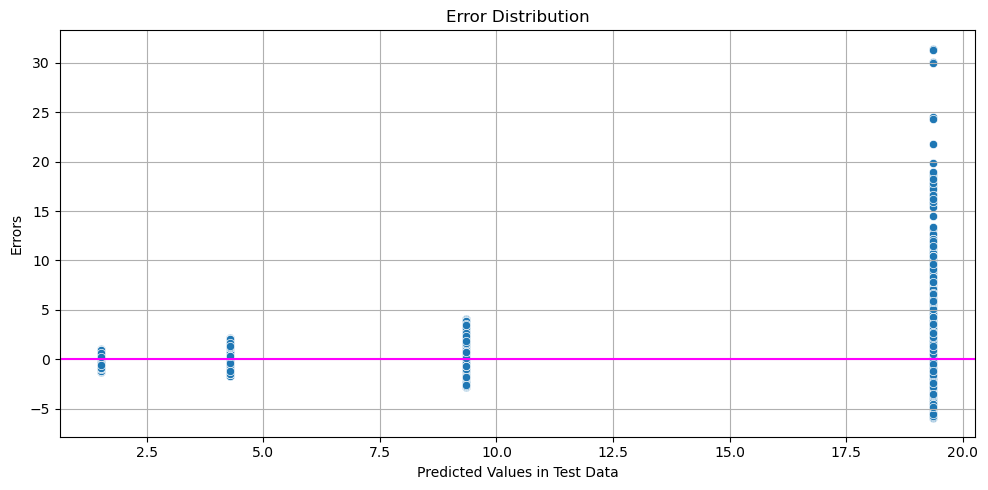

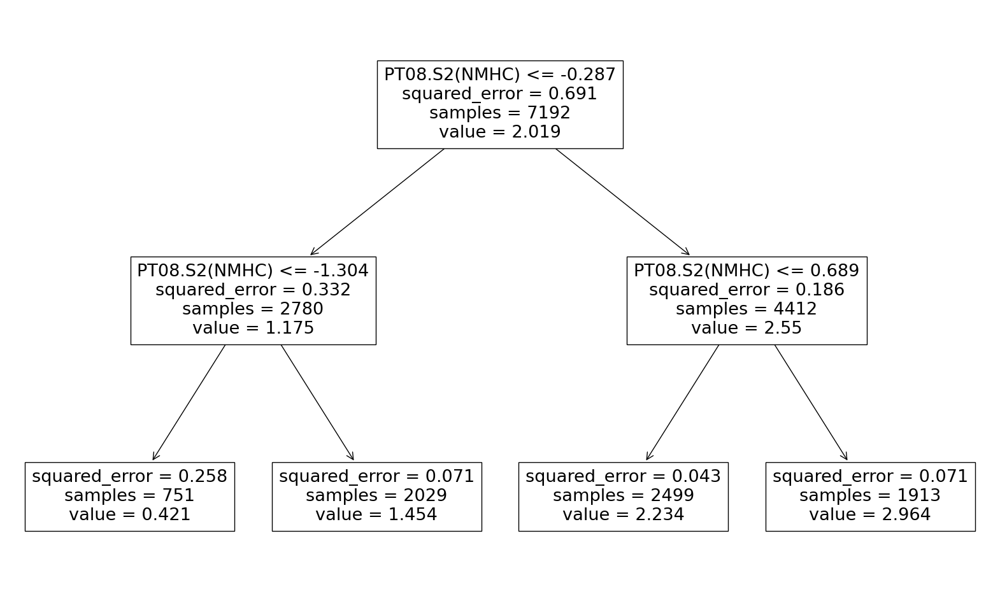

In [42]:
decision_tree_evaluation(tree_regressor, X_train, X_test, y_train, y_test)

We can observe that the results are weaker than those obtained in the regression models from the previous task. This can be attributed to the fact that the feature importance of 'PT08.S2(NMHC)' was very high back then, whereas now it has a lower value. Another reason for this is that the model relies on a tree-based approach, which differs from implementations like linear regression.

However, the feature 'PT08.S2(NMHC)' still holds the greatest power in shaping the model. It appears in the root node and all other nodes because it best separates the data based on certain criteria, often employing measures such as information gain, Gini impurity, or entropy. We can see that the mean squared error (MSE) value is quite acceptable despite the very shallow depth of the tree and the low number of nodes.

The four distinct levels of values (orange color) are clearly visible, which are obtained through the presence of four leaf nodes. Increasing the number of leaves or the depth of the tree would likely result in a significantly greater number of levels, thereby improving the precision of the model.

#### max_depth = 2 without feature 'PT08.S2(NMHC)'

Train RMSE: 4.38
Test RMSE: 4.50

Train MAE: 2.98
Test MAE: 3.01

Train R-squared: 0.65
Test R-squared: 0.65



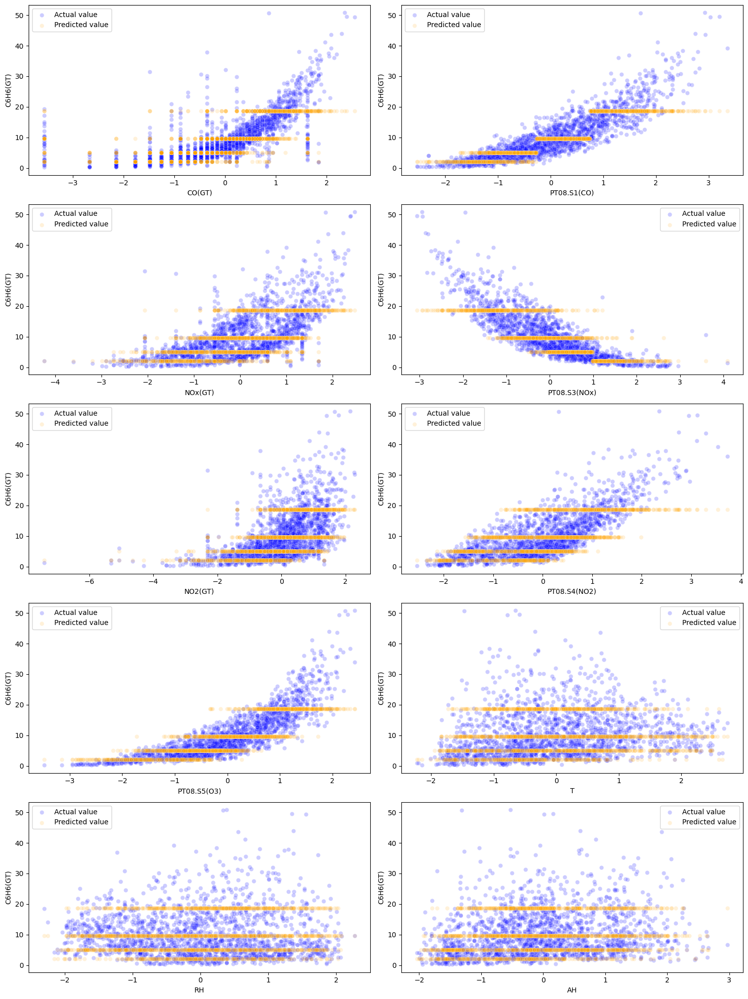

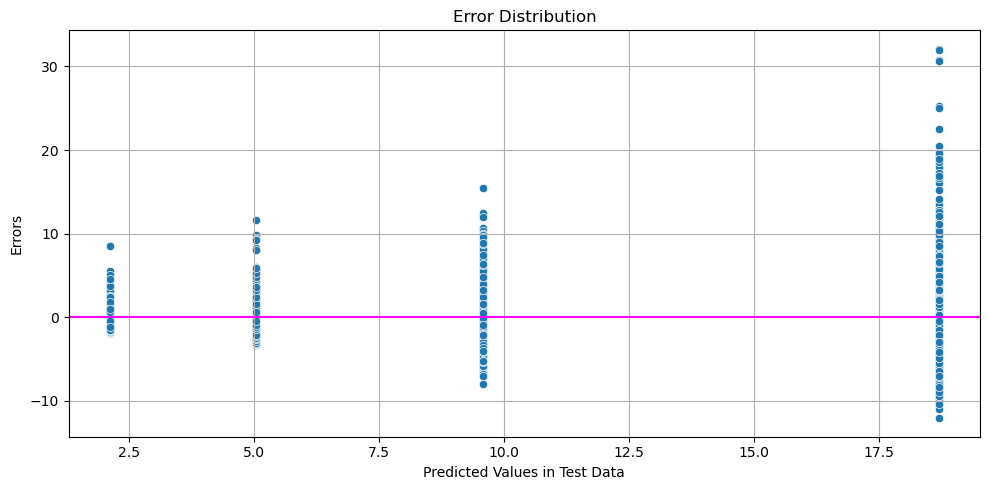

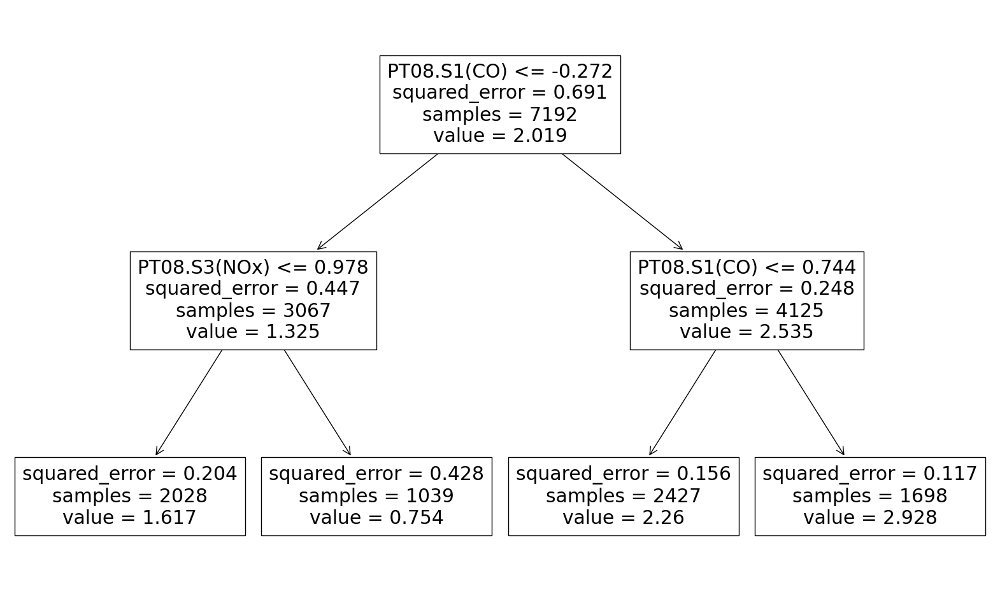

In [43]:
decision_tree_evaluation(tree_regressor, X_train, X_test, y_train, y_test, nmhc_feature=False)

In this case (without the 'PT08.S2(NMHC)' feature), we can observe several other features that play a significant role in shaping the model. Of course, the model performs worse than the one without the removal of this feature. However, we can notice a different split, and that the information gain for features PT08.S1(C) and PT08.S3(NOx) is valuable for the model, with respective values of approximately <=-0.27, <=0.9, and <=0.7. Additionally, we can observe an increase in mean squared error (MSE).

#### max_depth = 4 with feature 'PT08.S2(NMHC)'

In [44]:
tree_regressor = DecisionTreeRegressor(max_depth=4, random_state=0)

Train RMSE: 1.17
Test RMSE: 1.29

Train MAE: 0.62
Test MAE: 0.66

Train R-squared: 0.97
Test R-squared: 0.97



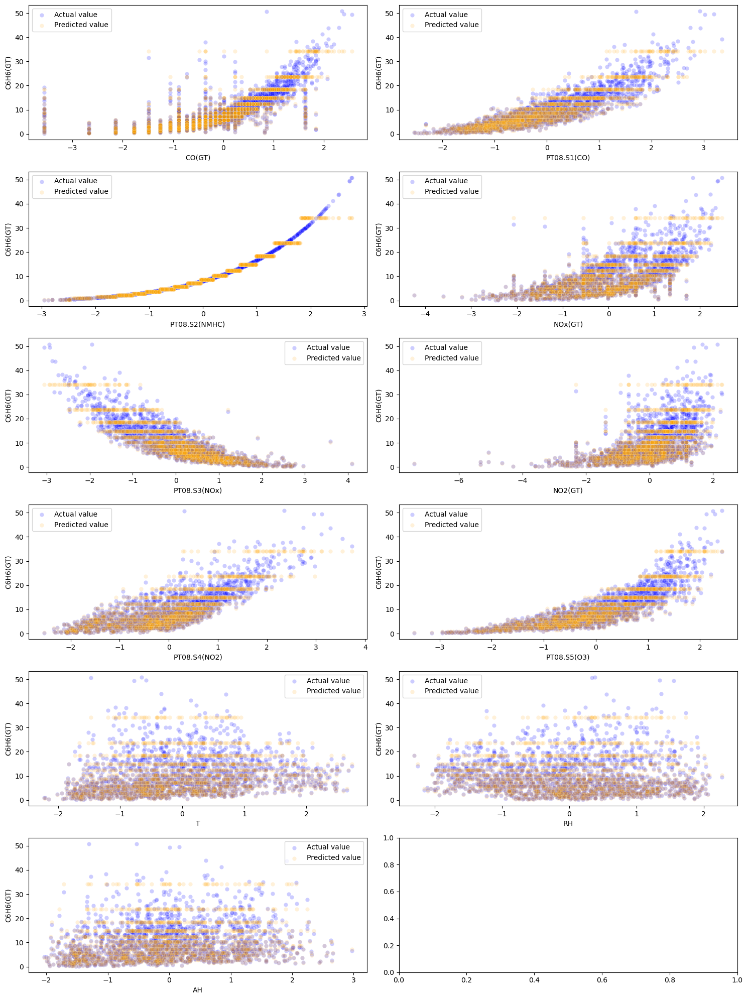

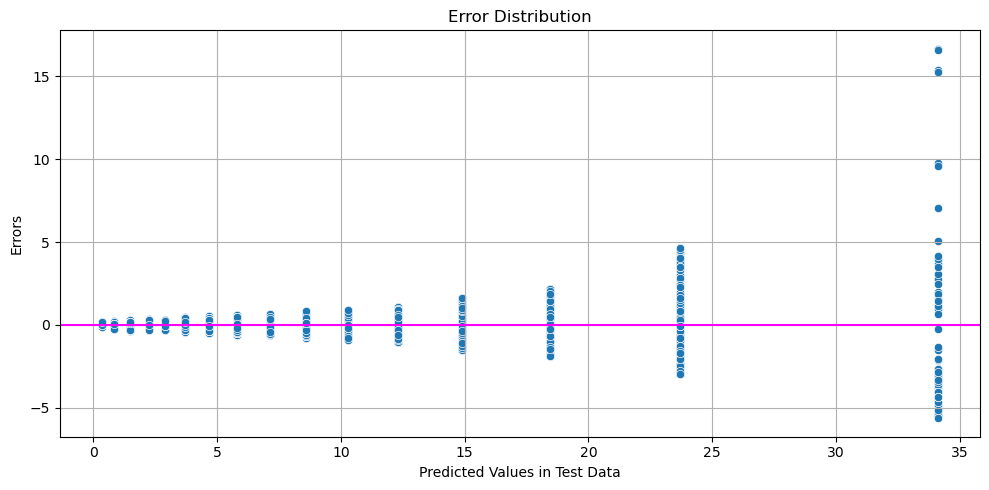

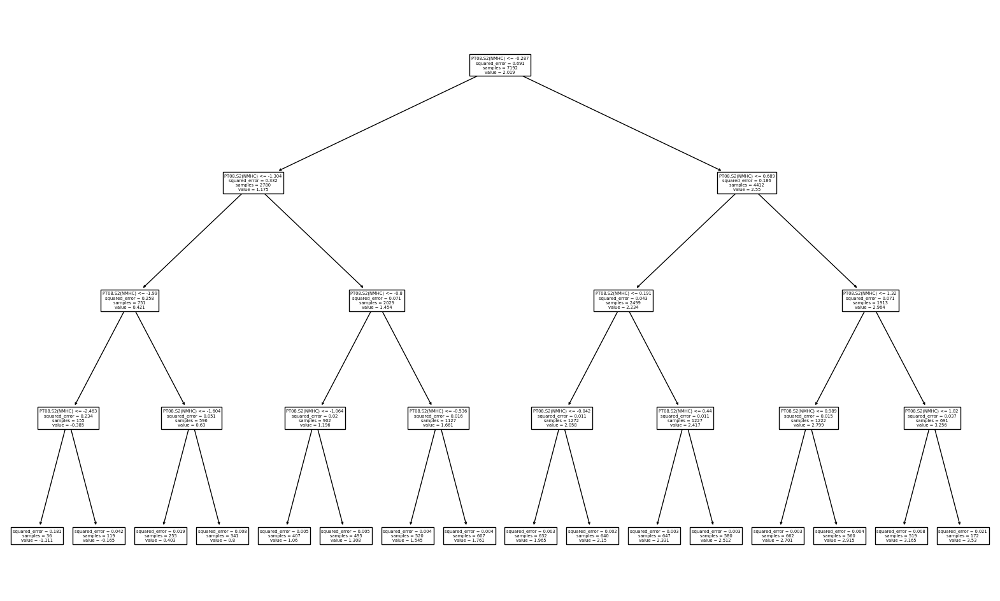

In [45]:
decision_tree_evaluation(tree_regressor, X_train, X_test, y_train, y_test)

By increasing the value of max_depth, we can observe a greater number of nodes and edges in the decision tree. The model-predicted values progressively align more closely with the input data, and the error gradually decreases.

#### max_depth = 10 with feature 'PT08.S2(NMHC)'

In [47]:
tree_regressor = DecisionTreeRegressor(max_depth=10, random_state=0)

Train RMSE: 0.02
Test RMSE: 0.31

Train MAE: 0.01
Test MAE: 0.02

Train R-squared: 1.00
Test R-squared: 1.00



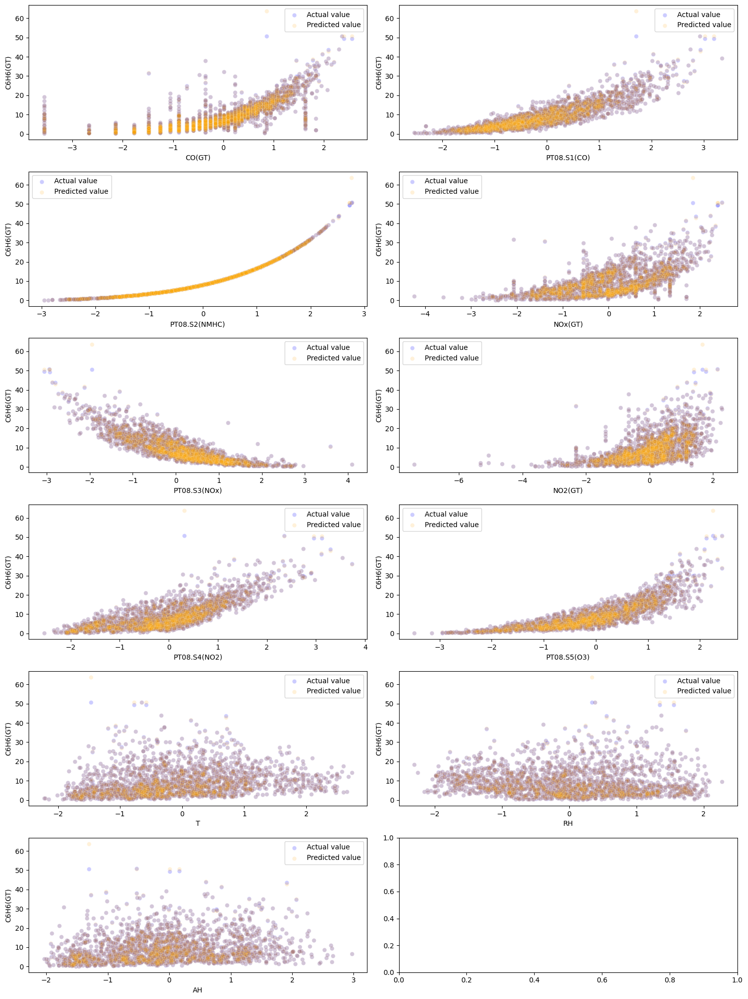

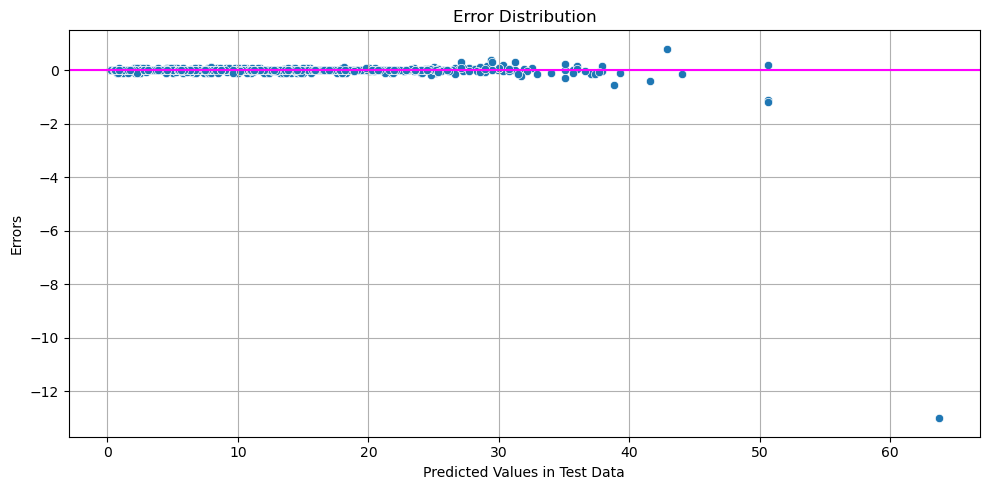

In [48]:
decision_tree_evaluation(tree_regressor, X_train, X_test, y_train, y_test, print_tree=False)

By increasing max_depth, we can reach a point where R2 equals 1, and the data predicted by the model is almost identical to the input data. However, such a model is not entirely desirable as it may lead to overfitting, and it might not generalize well to new, unseen data.

#### max_leaf_nodes = 4 with feature 'PT08.S2(NMHC)'

In [50]:
tree_regressor = DecisionTreeRegressor(max_leaf_nodes=4, random_state=0)

Train RMSE: 3.44
Test RMSE: 3.66

Train MAE: 2.11
Test MAE: 2.19

Train R-squared: 0.78
Test R-squared: 0.77



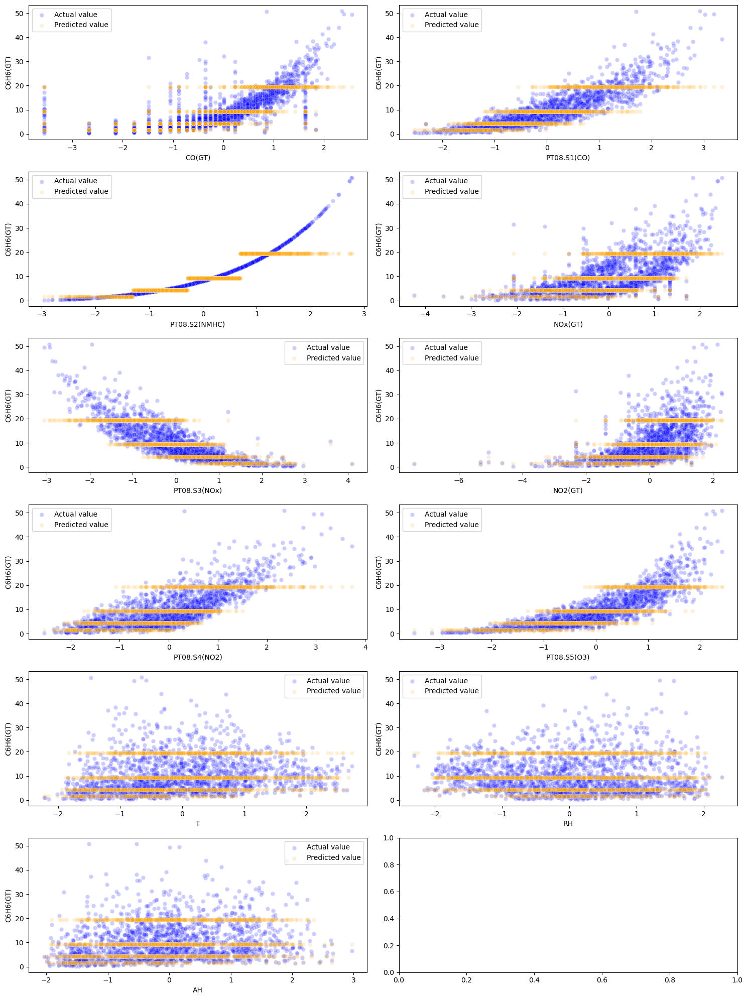

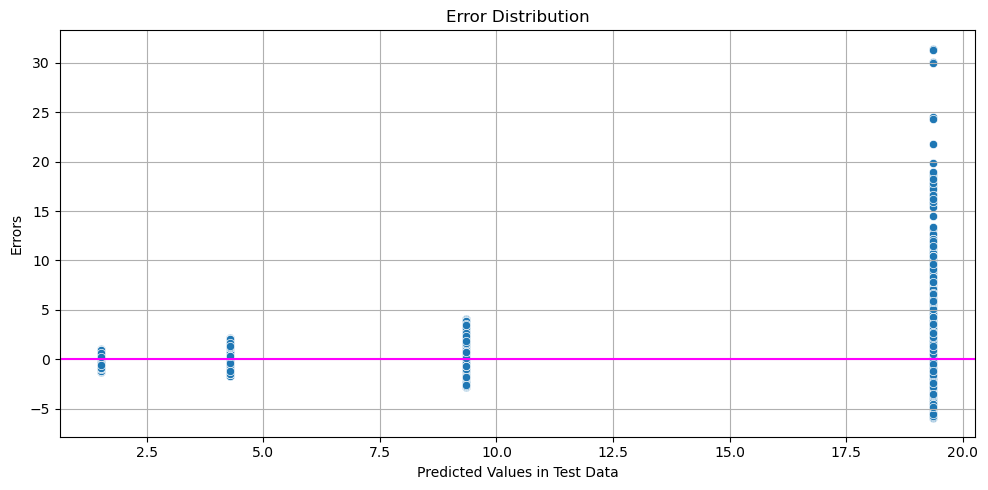

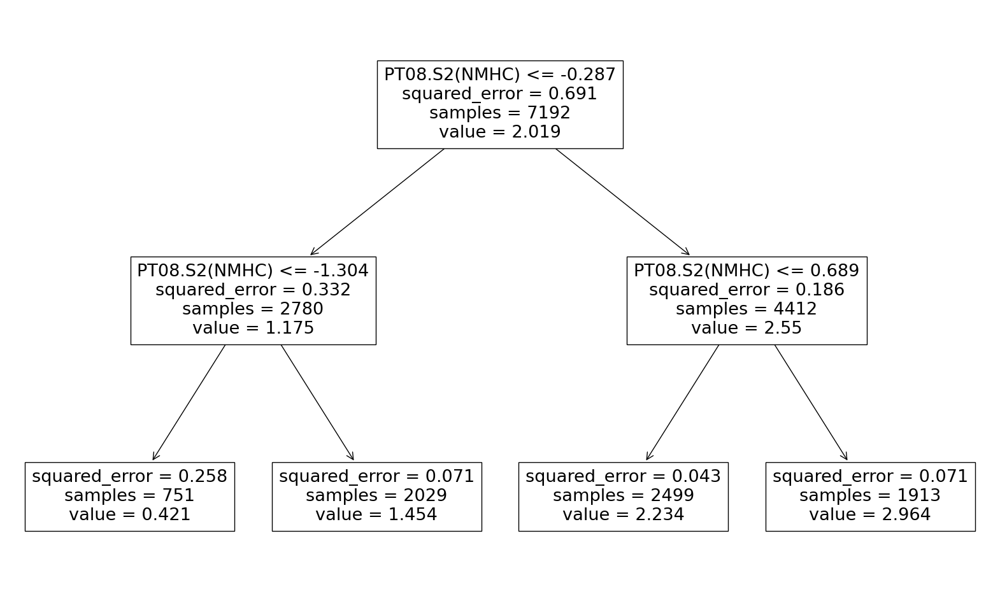

In [51]:
decision_tree_evaluation(tree_regressor, X_train, X_test, y_train, y_test, print_tree=True)

As anticipated, the results are similar to those of the model with max_depth=2. The four distinct levels of values (orange color) are clearly visible.

#### max_leaf_nodes = 20 with feature 'PT08.S2(NMHC)'

In [53]:
tree_regressor = DecisionTreeRegressor(max_leaf_nodes=20, random_state=0)

Train RMSE: 1.05
Test RMSE: 1.21

Train MAE: 0.55
Test MAE: 0.60

Train R-squared: 0.98
Test R-squared: 0.97



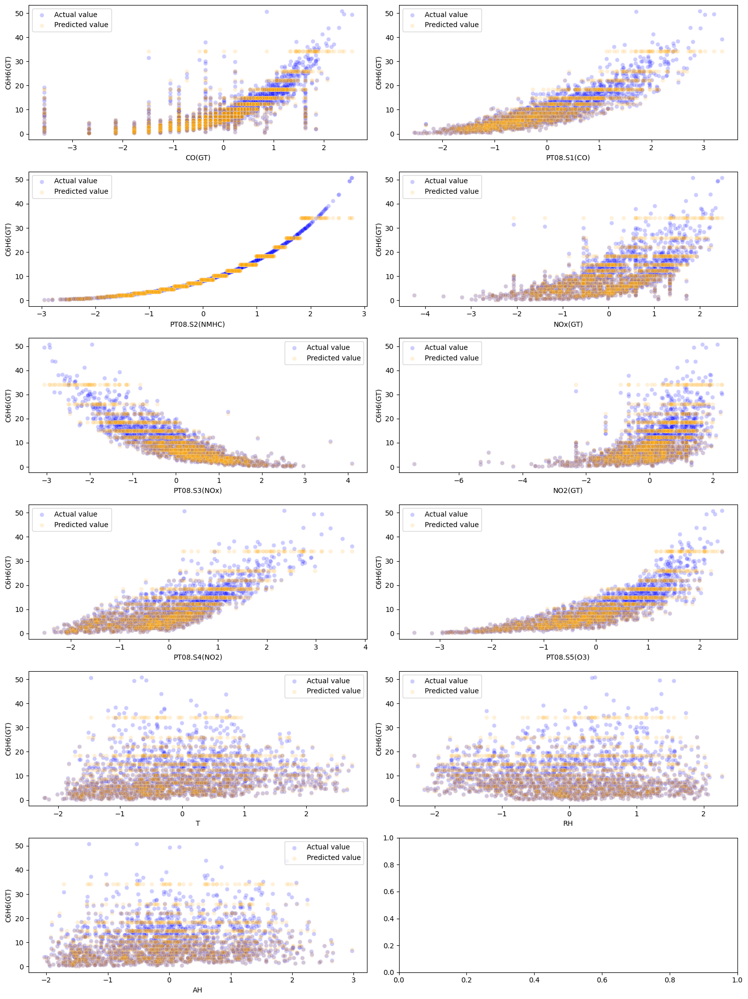

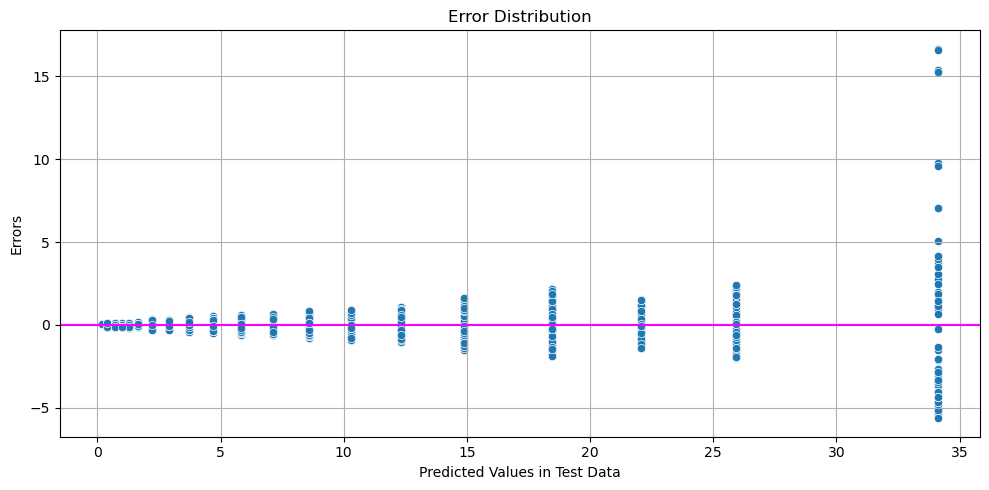

In [54]:
decision_tree_evaluation(tree_regressor, X_train, X_test, y_train, y_test, print_tree=False)

#### max_leaf_nodes = 20 without feature 'PT08.S2(NMHC)'

Train RMSE: 2.97
Test RMSE: 3.13

Train MAE: 1.99
Test MAE: 2.05

Train R-squared: 0.84
Test R-squared: 0.83



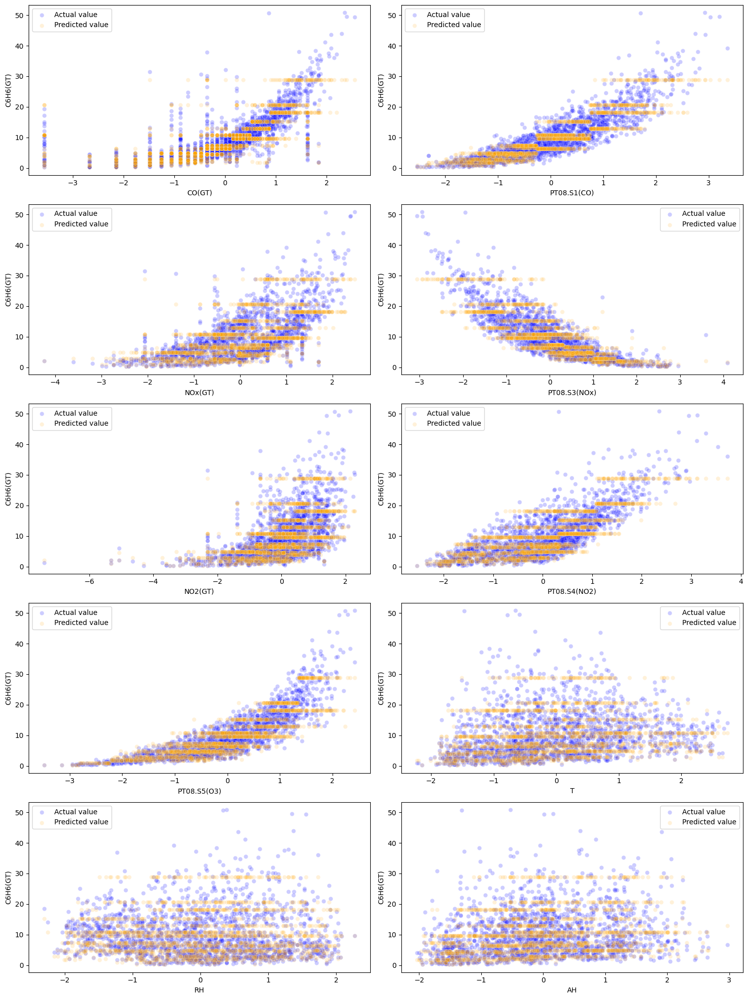

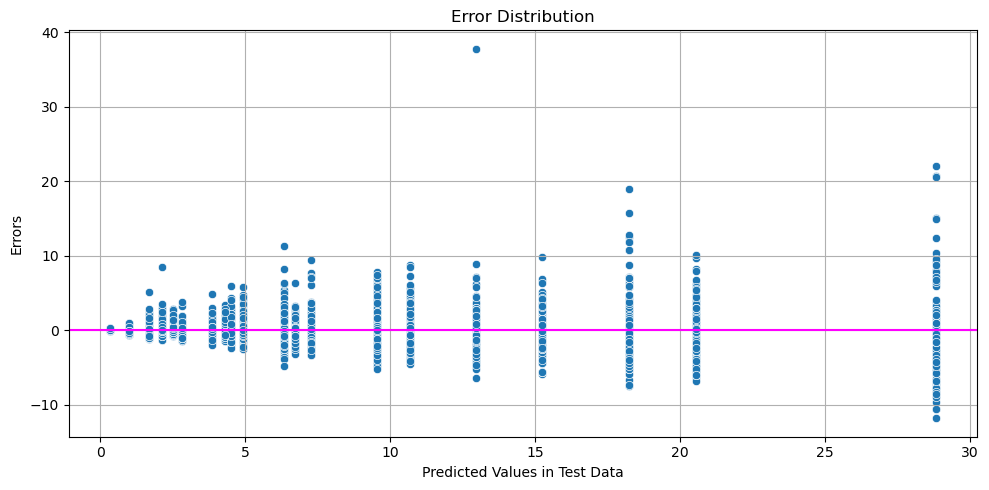

In [55]:
decision_tree_evaluation(tree_regressor, X_train, X_test, y_train, y_test, nmhc_feature=False, print_tree=False)

By increasing the number of max_leaf_nodes to 20, an improvement in the model's accuracy can be observed. The R2 parameter is quite good and comparable to the trained and tuned regression models from the previous task. Twenty vertical bands are visible in the error distribution, indicating the impact of the increased leaf nodes on the model's performance.

The impact of increasing the number of leaf nodes is beneficial for a model as it allows for improvement in R2 results, reduction of errors such as MAE, and better representation of reality. This holds true similarly to the effects of adjusting parameters like max_depth and many others, which will not be presented in this analysis.

### Decision Tree Regressor - Hyperparameters Tuning - w/o 'PT08.S2(NMHC)' feature

For the purpose of further training models, we create copies of the training and testing data on which the model operates.

In [56]:
X_train_copy = X_train.copy(deep=True)
X_test_copy = X_test.copy(deep=True)

X_train_copy.pop("PT08.S2(NMHC)")
X_test_copy.pop("PT08.S2(NMHC)")

8448   -1.206424
5948    1.616440
5053   -0.201218
4839    1.134703
8976   -0.983151
          ...   
3923    0.091460
4876   -0.686929
5733    1.025831
4214    0.431246
4017    0.287059
Name: PT08.S2(NMHC), Length: 1799, dtype: float64

In [57]:
tree_regressor = DecisionTreeRegressor(random_state=0)

The selected hyperparameters for tuning in the DecisionTreeRegressor model were chosen to comprehensively explore a range of configurations and find the combination that optimizes the model's performance. The "splitter" parameter, offering options for "best" and "random," is included to assess the impact of different splitting strategies at each node. Regarding the "max_depth" parameter, values of 2, 4, 6, and 8 were considered to evaluate the trade-off between capturing complex relationships in the data and preventing overfitting.

The "min_samples_leaf" parameter, with values of 1, 3, 5, and 7, allows for testing different minimum sample requirements at leaf nodes. This aids in controlling the granularity of the model and mitigating the risk of overfitting by setting a threshold for the minimum number of samples at a leaf node.

Finally, the "max_leaf_nodes" parameter is explored with values ranging from 10 to 100. This parameter influences the total number of terminal nodes in the decision tree, offering insights into how changes in this aspect affect the model's generalization.

In [58]:
parameters={"splitter": ["best", "random"],
            "max_depth" : [2, 4, 6, 8],
            "min_samples_leaf": [1, 3, 5, 7],
            "max_leaf_nodes": [10, 20, 30, 40, 50, 60, 70, 80, 90, 100]
           }

scoring = make_scorer(r2, greater_is_better=True)

In [59]:
tuning_model = GridSearchCV(tree_regressor, param_grid=parameters, 
                            scoring=scoring, cv=5, n_jobs=-1, refit=True)

In [60]:
tuning_model.fit(X_train_copy, y_train)
tuning_model.best_params_

{'max_depth': 8,
 'max_leaf_nodes': 100,
 'min_samples_leaf': 7,
 'splitter': 'best'}

In [61]:
tree_best_model = tuning_model.best_estimator_

In [62]:
y_train, y_train_pred, y_test, y_test_pred = target_feature_values(tree_best_model, X_train_copy, X_test_copy, y_train, y_test)
    
rmse_train = mse(y_train, y_train_pred, squared=False)
rmse_test = mse(y_test, y_test_pred, squared=False)
print(f"Train RMSE: {rmse_train:.2f}")
print(f"Test RMSE: {rmse_test:.2f}", end="\n\n")

mae_train = mae(y_train, y_train_pred)
mae_test = mae(y_test, y_test_pred)
print(f"Train MAE: {mae_train:.2f}")
print(f"Test MAE: {mae_test:.2f}", end="\n\n")

r2_train = r2(y_train, y_train_pred)
r2_test = r2(y_test, y_test_pred)
print(f"Train R-squared: {r2_train:.2f}")
print(f"Test R-squared: {r2_test:.2f}", end="\n\n")

Train RMSE: 2.13
Test RMSE: 2.39

Train MAE: 1.38
Test MAE: 1.55

Train R-squared: 0.92
Test R-squared: 0.90



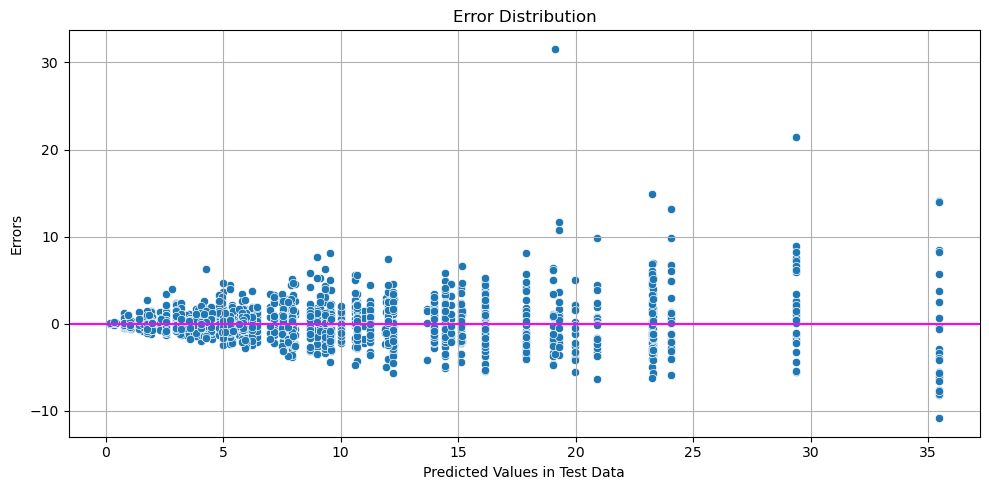

In [63]:
plot_error_distribution(y_test, y_test_pred)

Despite achieving good results with the tuned model, and its reasonably accurate representation of reality, these outcomes are still inferior to those obtained, for instance, through linear regression with regularization. This discrepancy can be attributed, in part, to the methodology of the model and the ease with which linear regression with regularization can handle correlated data.

The hyperparameter values chosen during model tuning were aimed at preventing overfitting. Despite this precaution, the model exhibits a slight overfitting tendency, which is, however, influenced by the characteristics of the dataset.

### Decision Tree Regressor - Features Importance - for best tree model

- helper function

In [64]:
def plot_feature_importance(model, X_train):
    feature_importance = pd.DataFrame({"Feature": X_train.columns, "Importance": model.feature_importances_})
    feature_importance = feature_importance.sort_values("Importance", ascending=False)
    
    plt.figure(figsize=(20, 20))
    sns.barplot(data=feature_importance[feature_importance["Importance"] > 0.01],
                y="Feature", x="Importance")
    plt.ylabel("Feature", fontsize=20)
    plt.title("Features Importance", fontsize=40)
    plt.xticks(rotation=90)
    plt.show()

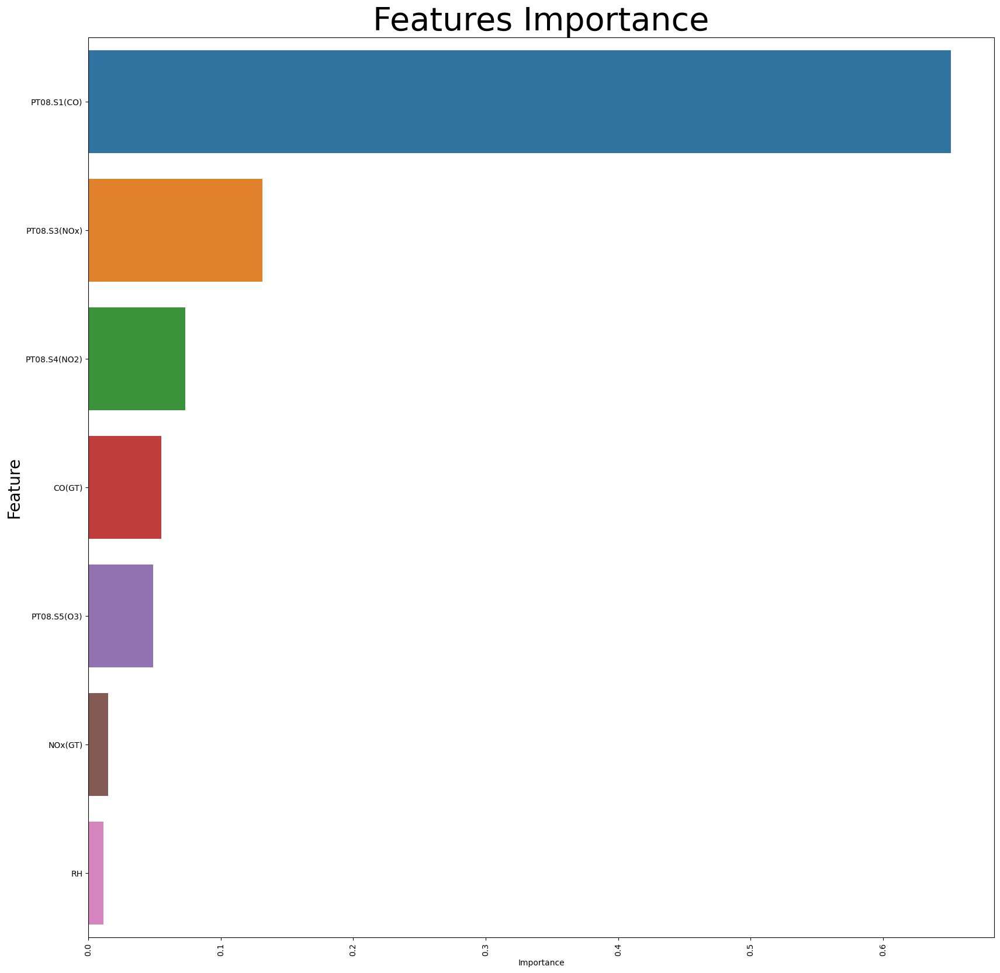

In [65]:
plot_feature_importance(tree_best_model, X_train_copy)

We can observe that for data without the 'PT08.S2(NMHC)' feature, the predominant importance is attributed to PT08.S1 and PT08.S3, as mentioned earlier in the analysis of nodes in the decision tree. Features with importance lower than 0.01 were not plotted.

---

### Random Forest Regressor 

It is important to note that no inverse transformation was applied to the target feature (previously logarithmized). This leads to significant numerical instability, resulting in large errors in the outcomes. Consequently, the comparison of the model for this dataset between Random Forest and Decision Tree shows different values and may be similarly evaluated based on the visualization of results.

In [66]:
def target_feature_values_forest(model, X_train_copy, X_test_copy, y_train, y_test):
    y_train_pred = model.predict(X_train_copy)
    y_test_pred = model.predict(X_test_copy)
    
    # IMPORTANT !!!
    # without exponential transformation due to numerical instability
    # even with np.log1p and np.expm1:
    
    # y_train = np.exp(y_train)
    # y_test = np.exp(y_test)
    # y_train_pred = np.exp(y_train_pred)
    # y_test_pred = np.exp(y_test_pred)
    
    return y_train, y_train_pred, y_test, y_test_pred

In [67]:
def forest_evaluation(model, X_train, X_test, y_train, y_test, nmhc_feature=True):
    X_train_copy = X_train.copy(deep=True)
    X_test_copy = X_test.copy(deep=True)
    num_features = numerical_features[::]
    n_rows = 6
    n_cols = 2
    
    if not nmhc_feature:
        X_train_copy.pop("PT08.S2(NMHC)")
        X_test_copy.pop("PT08.S2(NMHC)")
        num_features.remove("PT08.S2(NMHC)")
        n_rows = 5
    
    model.fit(X_train_copy, y_train)
    y_train, y_train_pred, y_test, y_test_pred = target_feature_values_forest(model, X_train_copy, X_test_copy, y_train, y_test)
    
    rmse_train = mse(y_train, y_train_pred, squared=False)
    rmse_test = mse(y_test, y_test_pred, squared=False)
    print(f"Train RMSE: {rmse_train:.2f}")
    print(f"Test RMSE: {rmse_test:.2f}", end="\n\n")
    
    mae_train = mae(y_train, y_train_pred)
    mae_test = mae(y_test, y_test_pred)
    print(f"Train MAE: {mae_train:.2f}")
    print(f"Test MAE: {mae_test:.2f}", end="\n\n")
    
    r2_train = r2(y_train, y_train_pred)
    r2_test = r2(y_test, y_test_pred)
    print(f"Train R-squared: {r2_train:.2f}")
    print(f"Test R-squared: {r2_test:.2f}", end="\n\n")
    
    fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(15, 20))
    axes = axes.flatten()
    for i, feature in enumerate(num_features):
        df_pred = pd.DataFrame(np.linspace(X_test_copy.iloc[:, i].min(), X_test_copy.iloc[:, i].max(), num=X_test_copy.iloc[:, i].shape[0], endpoint=True),
                               columns=[X_test_copy.columns[i]])
        sns.scatterplot(x=X_test_copy.iloc[:, i], y=y_test, color="blue", alpha=0.2, ax=axes[i], label="Actual value")
        sns.scatterplot(x=X_test_copy.iloc[:, i], y=y_test_pred, color="orange", alpha=0.15, ax=axes[i], label="Predicted value")
        axes[i].legend()
        
    plt.tight_layout()
    plt.show()
    
    print()
    
    plot_error_distribution(y_test, y_test_pred)

#### n_estimators=2, max_depth=4 with feature 'PT08.S2(NMHC)'

In [68]:
forest_regressor = RandomForestRegressor(n_estimators=2, max_depth=4, random_state=0, n_jobs=-1)

Train RMSE: 0.60
Test RMSE: 0.64

Train MAE: 0.39
Test MAE: 0.42

Train R-squared: 0.99
Test R-squared: 0.99



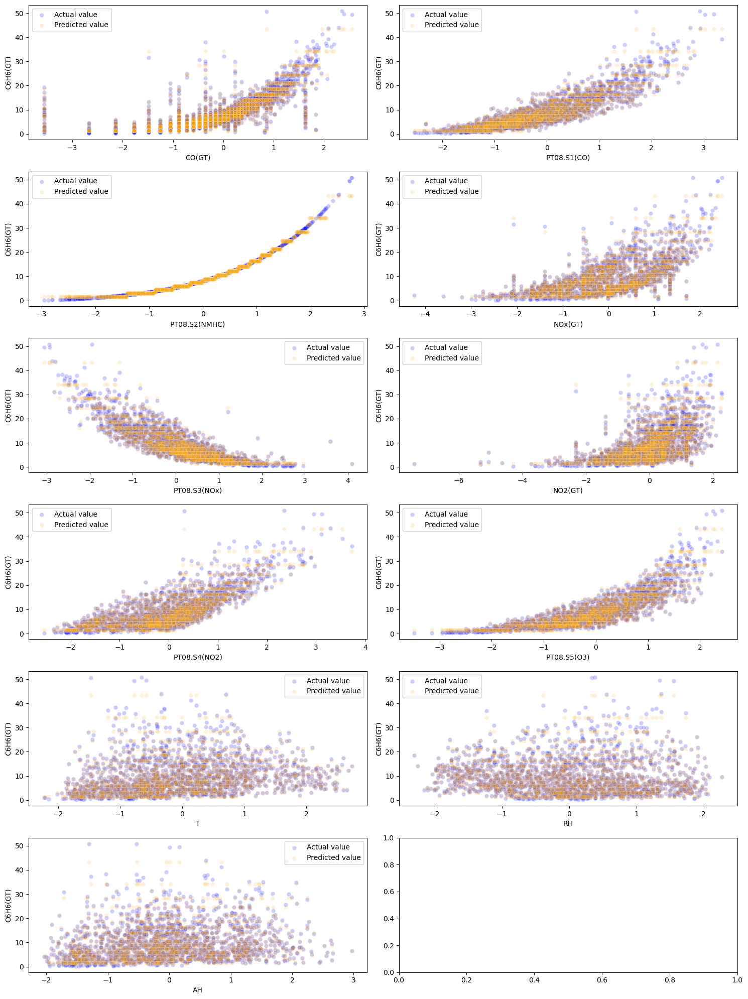

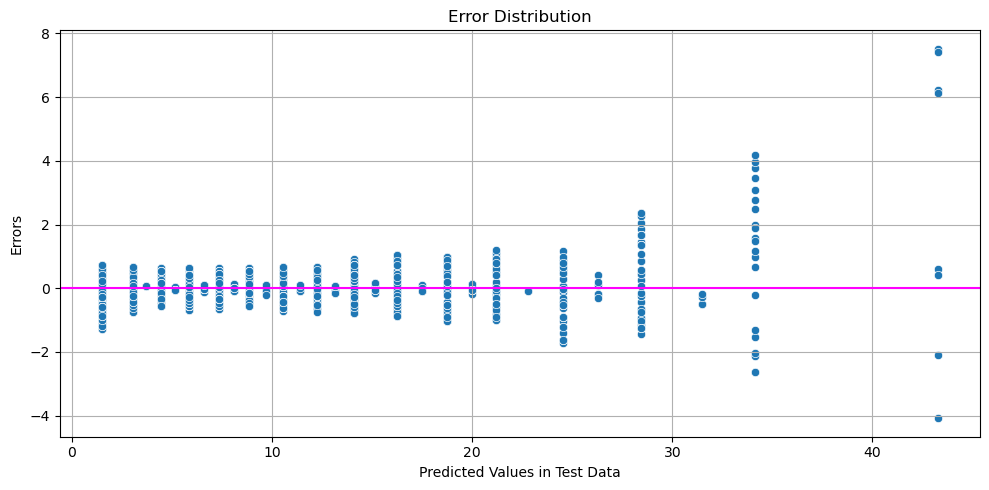

In [69]:
forest_evaluation(forest_regressor, X_train, X_test, y_train, y_test)

#### n_estimators=2, max_depth=4 without feature 'PT08.S2(NMHC)'

Train RMSE: 2.49
Test RMSE: 2.66

Train MAE: 1.78
Test MAE: 1.88

Train R-squared: 0.89
Test R-squared: 0.88



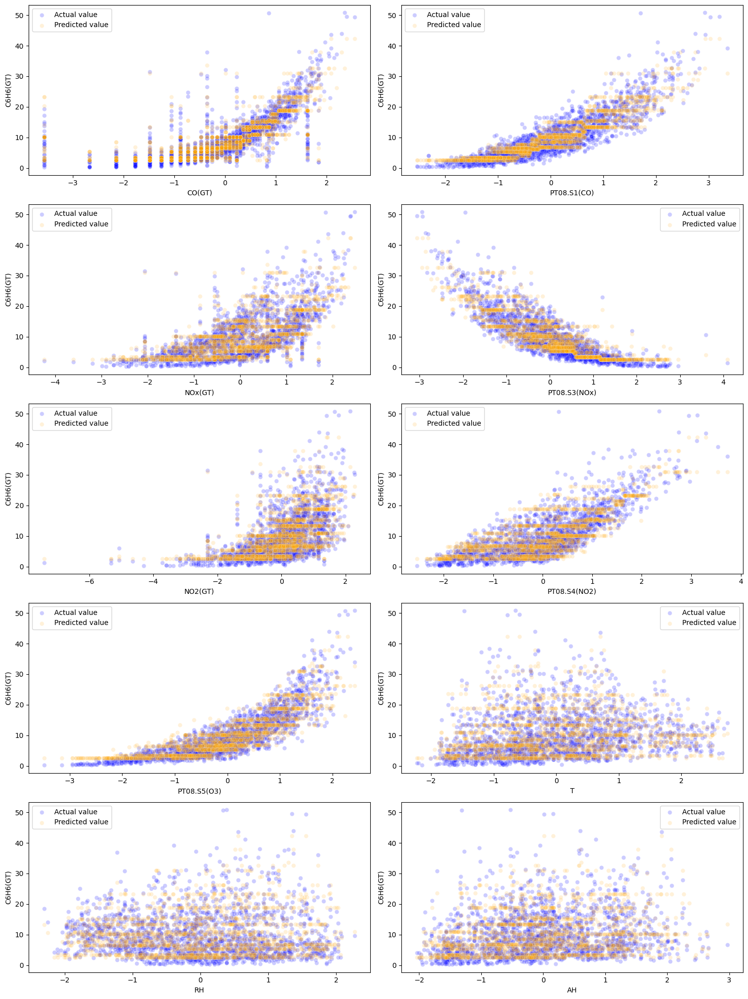

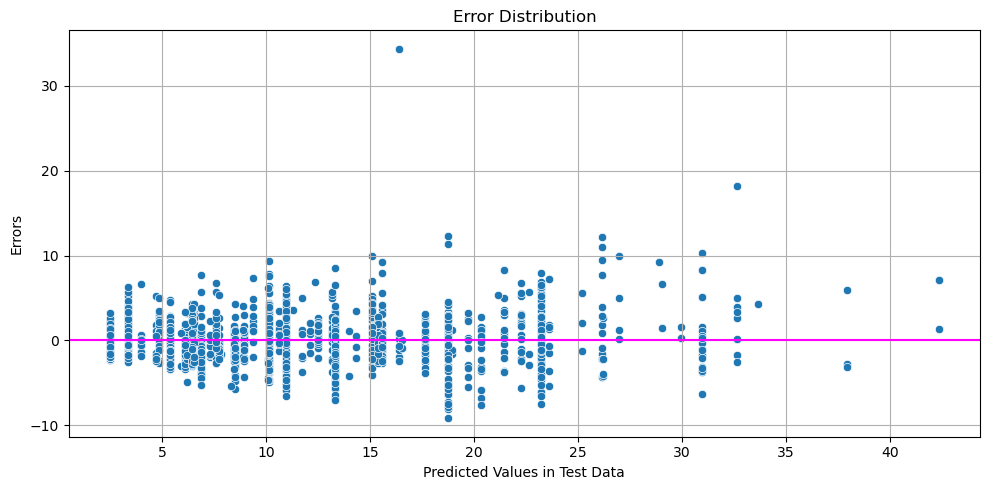

In [70]:
forest_evaluation(forest_regressor, X_train, X_test, y_train, y_test, nmhc_feature=False)

#### n_estimators=6, max_depth=6 with feature 'PT08.S2(NMHC)'

In [71]:
forest_regressor = RandomForestRegressor(n_estimators=6, max_depth=6, random_state=0, n_jobs=-1)

Train RMSE: 0.17
Test RMSE: 0.13

Train MAE: 0.06
Test MAE: 0.07

Train R-squared: 1.00
Test R-squared: 1.00



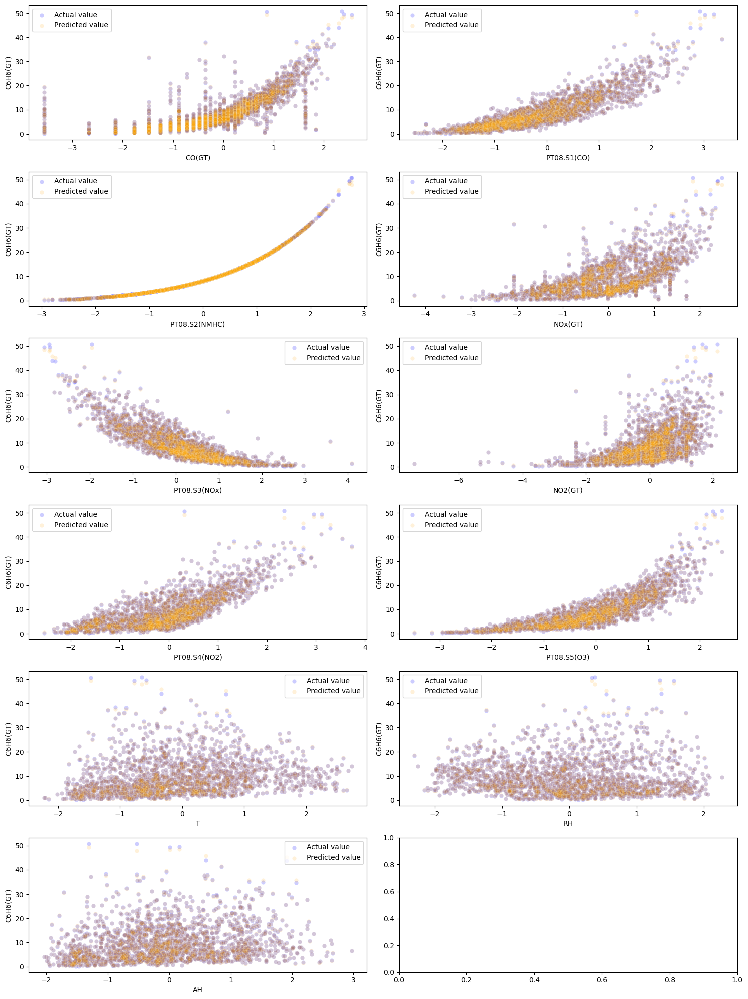

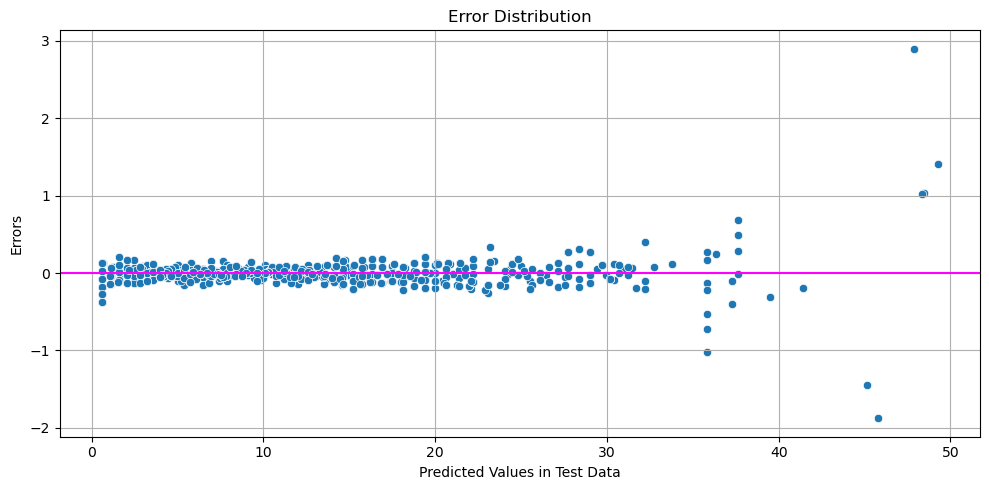

In [72]:
forest_evaluation(forest_regressor, X_train, X_test, y_train, y_test)

#### n_estimators=6, max_depth=6 without feature 'PT08.S2(NMHC)'

Train RMSE: 1.69
Test RMSE: 1.86

Train MAE: 1.19
Test MAE: 1.30

Train R-squared: 0.95
Test R-squared: 0.94



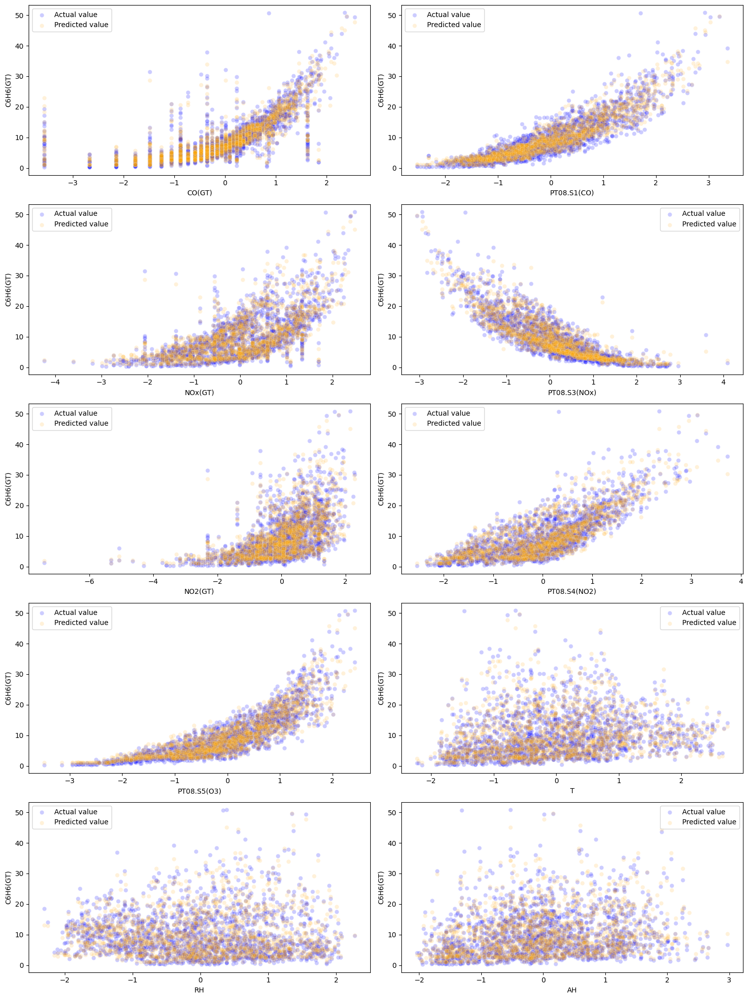

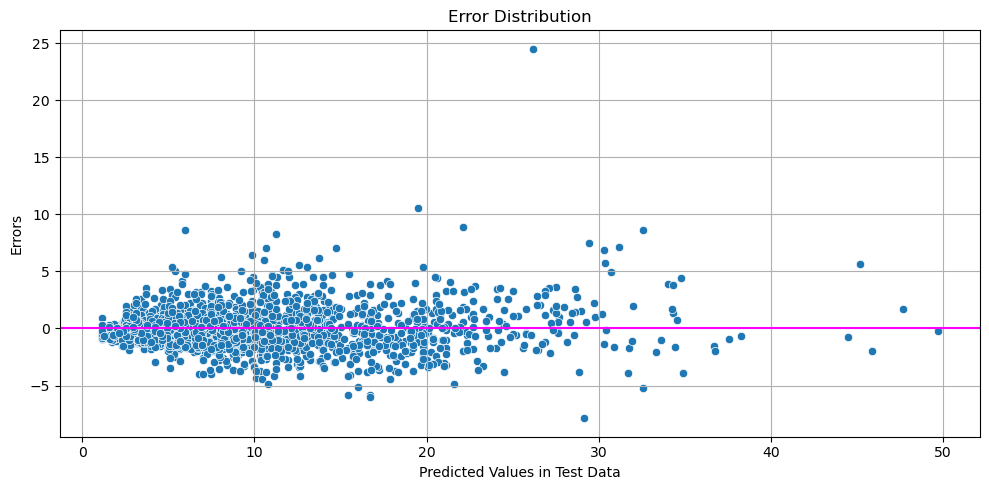

In [73]:
forest_evaluation(forest_regressor, X_train, X_test, y_train, y_test, nmhc_feature=False)

It can be observed that increasing the number of estimators and max depth leads to an improvement in the model's performance. It is important to note that the results for RMSE, MAE, and R2 are somewhat inflated due to the inability to apply an inverse transformation to the target feature. However, the plots demonstrate the quality of the model, and it can be said that the model generalizes quite well. There is not significant overfitting, and the predicted data closely reflects reality.

The error distribution appears similar to that of a model employing Lasso regularization and cross-validation as in the previous task.

### Random Forest Regressor - Hyperparameters Tuning - w/o 'PT08.S2(NMHC)' feature

In [74]:
X_train_copy = X_train.copy(deep=True)
X_test_copy = X_test.copy(deep=True)

X_train_copy.pop("PT08.S2(NMHC)")
X_test_copy.pop("PT08.S2(NMHC)")

8448   -1.206424
5948    1.616440
5053   -0.201218
4839    1.134703
8976   -0.983151
          ...   
3923    0.091460
4876   -0.686929
5733    1.025831
4214    0.431246
4017    0.287059
Name: PT08.S2(NMHC), Length: 1799, dtype: float64

In [75]:
forest_regressor = RandomForestRegressor(random_state=0)

In [76]:
parameters={"n_estimators": [100, 150, 200, 250, 300],
            "max_depth": [1, 2, 3, 4],
            "bootstrap": [True, False]
           }

scoring = make_scorer(r2, greater_is_better=True)

The chosen hyperparameters for the RandomForestRegressor model were selected based on a systematic exploration of various configurations. The parameter "n_estimators" was varied across values of 100, 150, 200, 250, and 300 to assess the impact of the number of trees in the ensemble on the model's performance. Similarly, the "max_depth" parameter was tested with values of 1, 2, 3, and 4 to evaluate the influence of tree depth on model complexity.

Additionally, the "bootstrap" parameter was explored with both True and False values, allowing the model to be trained with and without bootstrapping. This helps to investigate whether bootstrapping, the random sampling with replacement, has a significant effect on the model's predictive ability.

In [77]:
tuning_model = GridSearchCV(forest_regressor, param_grid=parameters, 
                            scoring=scoring, cv=5, n_jobs=-1, refit=True)

In [78]:
tuning_model.fit(X_train_copy, y_train)
tuning_model.best_params_

{'bootstrap': True, 'max_depth': 4, 'n_estimators': 300}

In [79]:
forest_best_model = tuning_model.best_estimator_

In [80]:
y_train, y_train_pred, y_test, y_test_pred = target_feature_values_forest(forest_best_model, X_train_copy, X_test_copy, y_train, y_test)
    
rmse_train = mse(y_train, y_train_pred, squared=False)
rmse_test = mse(y_test, y_test_pred, squared=False)
print(f"Train RMSE: {rmse_train:.2f}")
print(f"Test RMSE: {rmse_test:.2f}", end="\n\n")

mae_train = mae(y_train, y_train_pred)
mae_test = mae(y_test, y_test_pred)
print(f"Train MAE: {mae_train:.2f}")
print(f"Test MAE: {mae_test:.2f}", end="\n\n")

r2_train = r2(y_train, y_train_pred)
r2_test = r2(y_test, y_test_pred)
print(f"Train R-squared: {r2_train:.2f}")
print(f"Test R-squared: {r2_test:.2f}", end="\n\n")

Train RMSE: 2.25
Test RMSE: 2.37

Train MAE: 1.63
Test MAE: 1.70

Train R-squared: 0.91
Test R-squared: 0.90



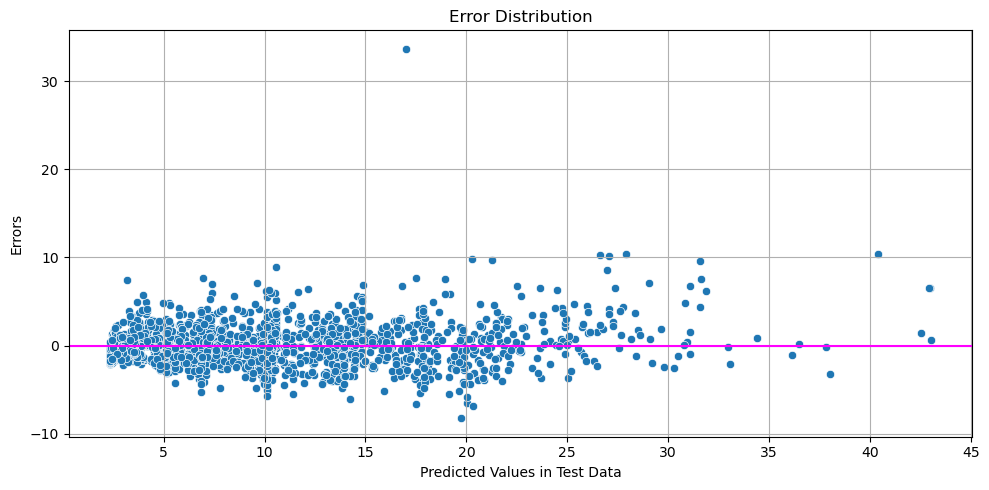

In [81]:
plot_error_distribution(y_test, y_test_pred)

### Random Forest Regressor - Features Importance - for best forest model

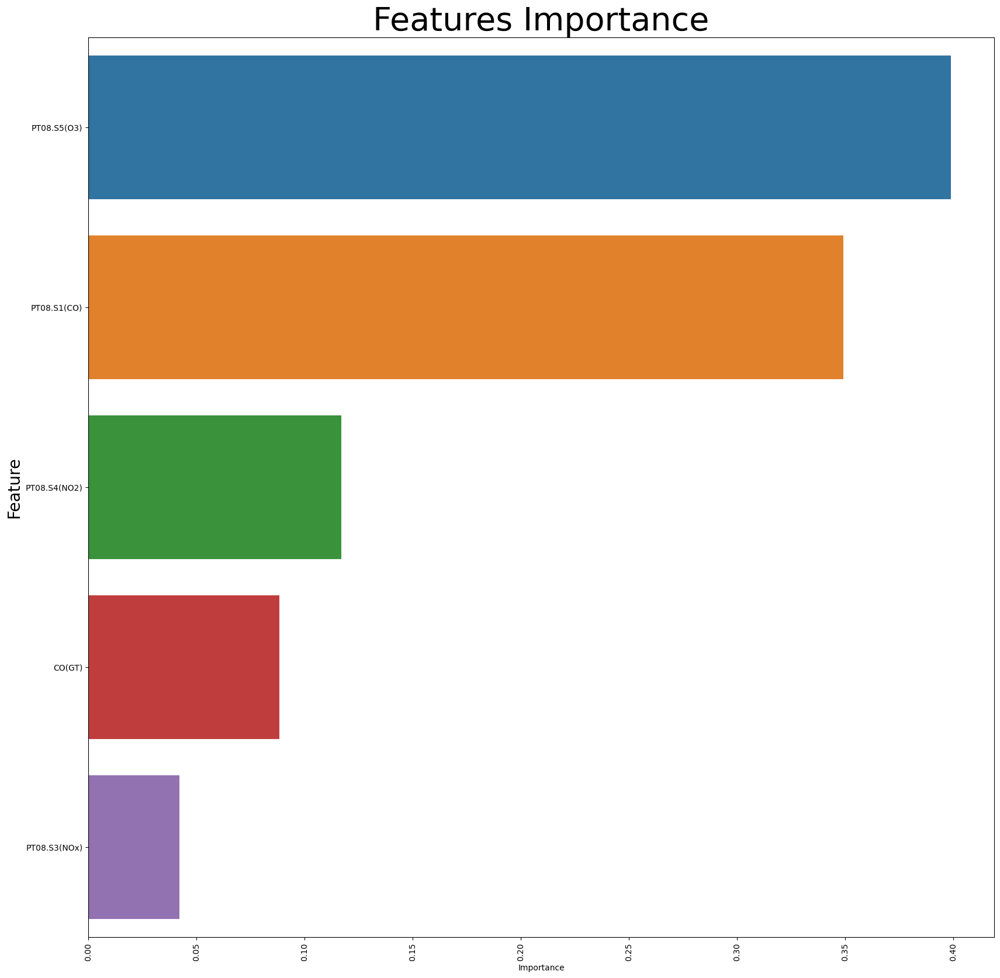

In [82]:
plot_feature_importance(forest_best_model, X_train_copy)

In the case of this model, the most significant feature importance is attributed to PT08.S5(O3), and the subsequent important features are consistent with those identified as crucial in the Decision Tree model. The presence of a limited number of significant variables suggests that the model is not overly complex. It demonstrates the ability to make reasonably accurate predictions based on a few sensors and parameters.

---

### Boosting Regressor 

In this case, we can start with parameters: n_estimators=6 and max_depth=4, and systematically increase these values to observe how the results are affected.

#### n_estimators=6, max_depth=4 with feature 'PT08.S2(NMHC)'

In [83]:
lgbm_regressor = LGBMRegressor(n_estimators=6, max_depth=4, random_state=0, n_jobs=-1)

In [84]:
params = {"verbose": -1}
lgbm_regressor.set_params(**params)

LGBMRegressor(max_depth=4, n_estimators=6, random_state=0, verbose=-1)

Train RMSE: 3.97
Test RMSE: 4.08

Train MAE: 3.07
Test MAE: 3.13

Train R-squared: 0.71
Test R-squared: 0.71



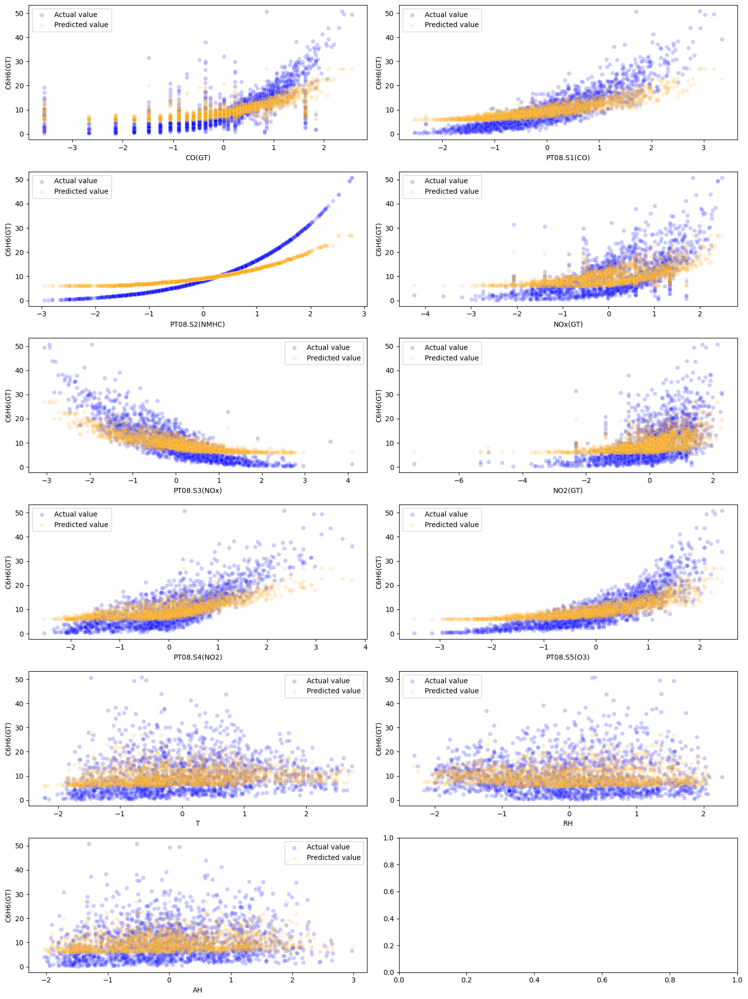

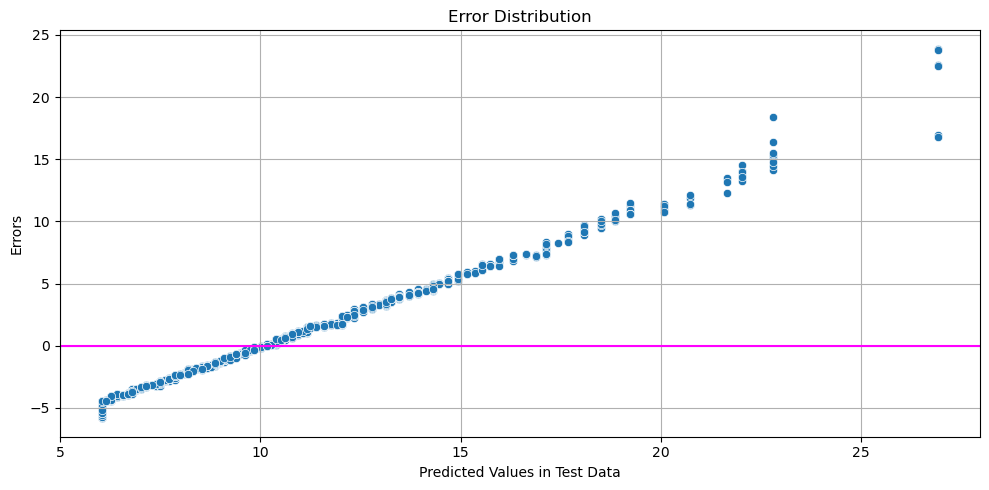

In [85]:
forest_evaluation(lgbm_regressor, X_train, X_test, y_train, y_test)

#### n_estimators=6, max_depth=4 without feature 'PT08.S2(NMHC)'

Train RMSE: 4.44
Test RMSE: 4.61

Train MAE: 3.41
Test MAE: 3.49

Train R-squared: 0.64
Test R-squared: 0.63



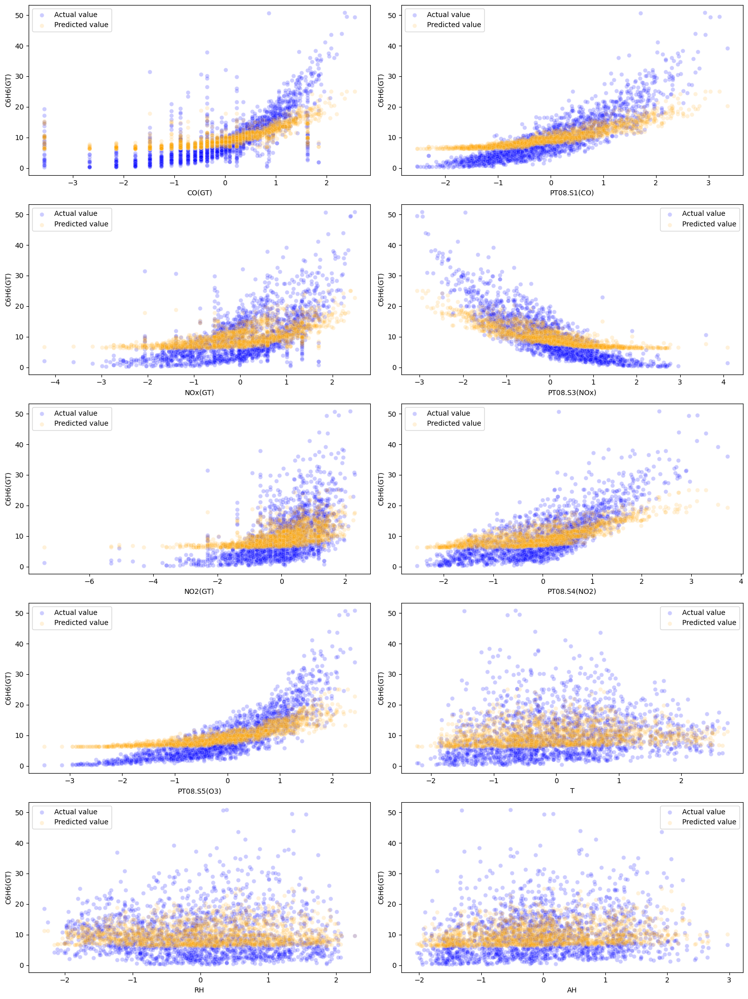

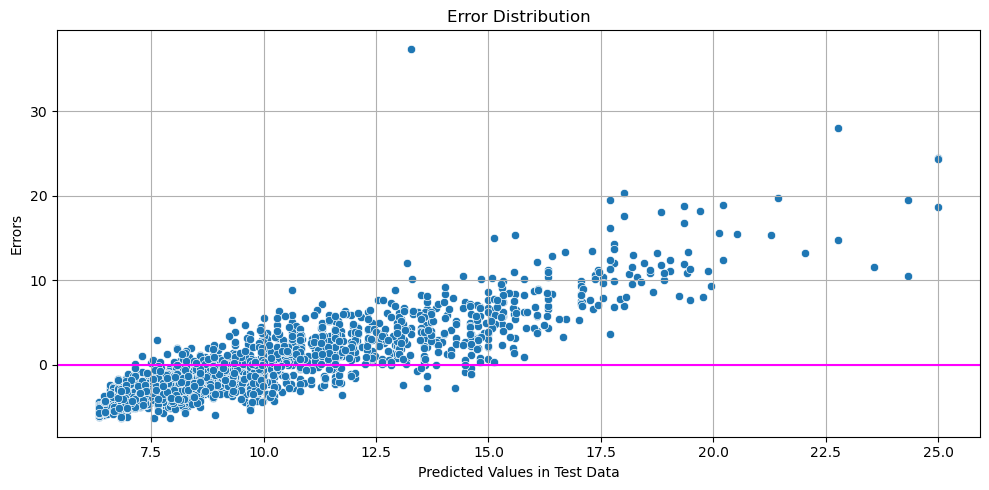

In [86]:
forest_evaluation(lgbm_regressor, X_train, X_test, y_train, y_test, nmhc_feature=False)

In both cases, we observe a certain bias and an unnatural error distribution. The pattern resembling a straight line in the error distribution plot indicates a less-than-ideal application of the model to this dataset. This is particularly noticeable in the case of data without removing the 'PT08.S2(NMHC)' feature.

#### n_estimators=10, max_depth=8 with feature 'PT08.S2(NMHC)'

In [87]:
lgbm_regressor = LGBMRegressor(n_estimators=10, max_depth=8, random_state=0, n_jobs=-1)

In [88]:
params = {"verbose": -1}
lgbm_regressor.set_params(**params)

LGBMRegressor(max_depth=8, n_estimators=10, random_state=0, verbose=-1)

Train RMSE: 2.60
Test RMSE: 2.67

Train MAE: 2.01
Test MAE: 2.05

Train R-squared: 0.88
Test R-squared: 0.88



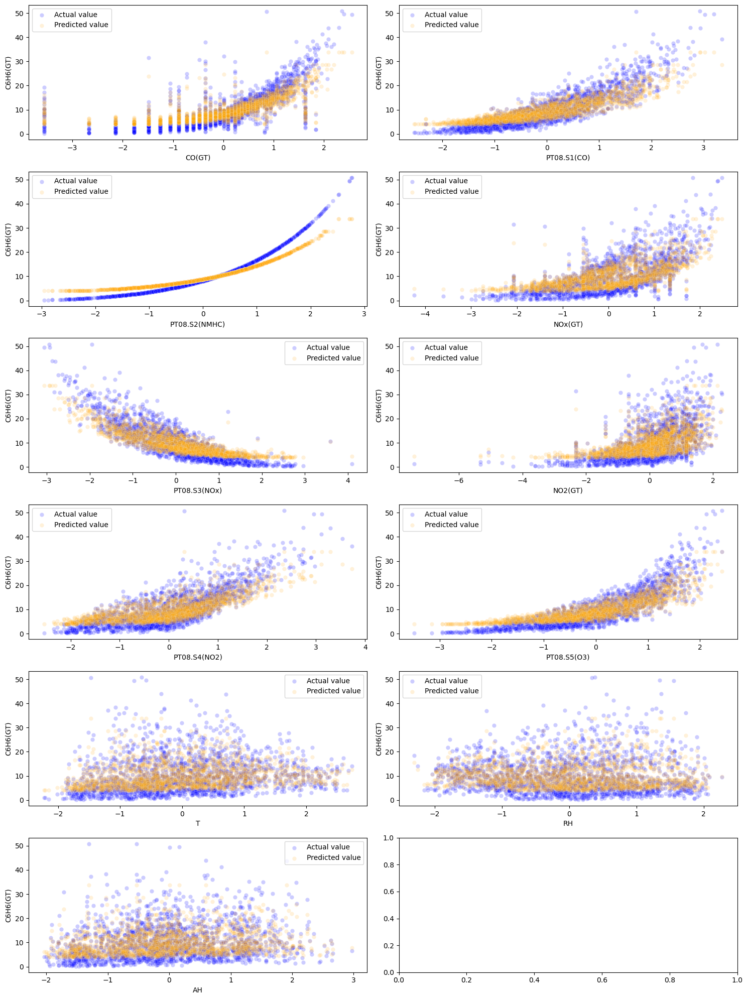

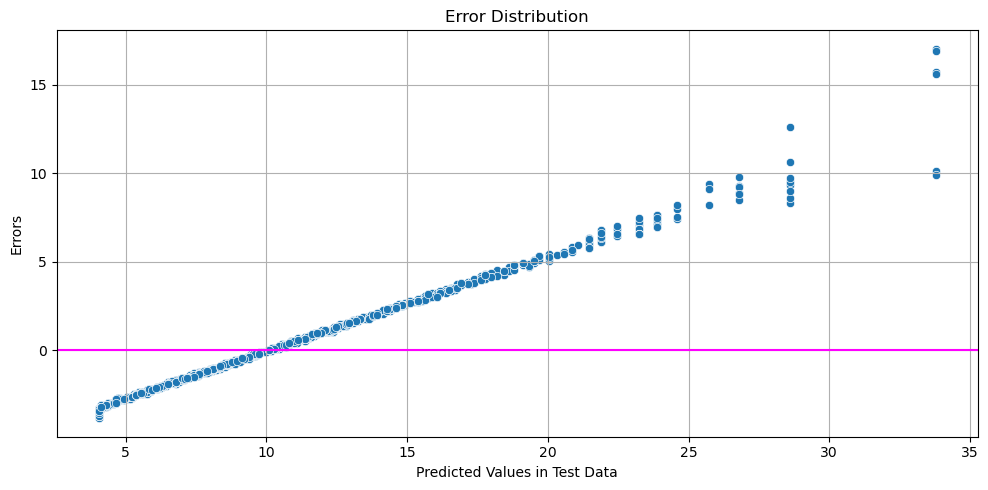

In [89]:
forest_evaluation(lgbm_regressor, X_train, X_test, y_train, y_test)

#### n_estimators=10, max_depth=8 without feature 'PT08.S2(NMHC)'

Train RMSE: 3.13
Test RMSE: 3.27

Train MAE: 2.37
Test MAE: 2.44

Train R-squared: 0.82
Test R-squared: 0.81



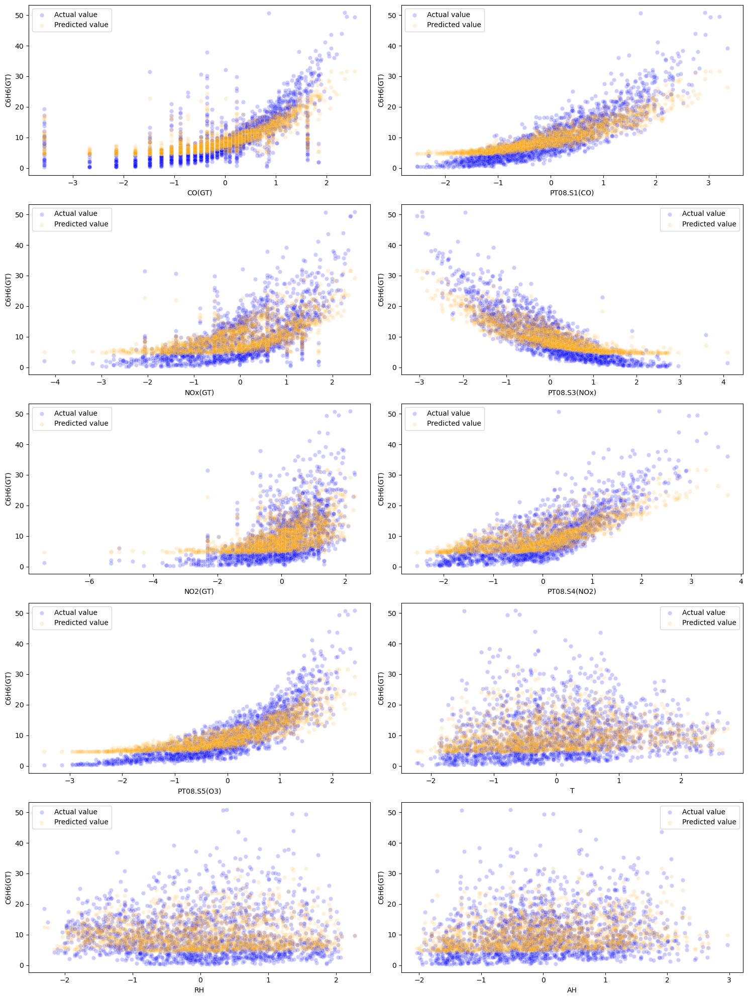

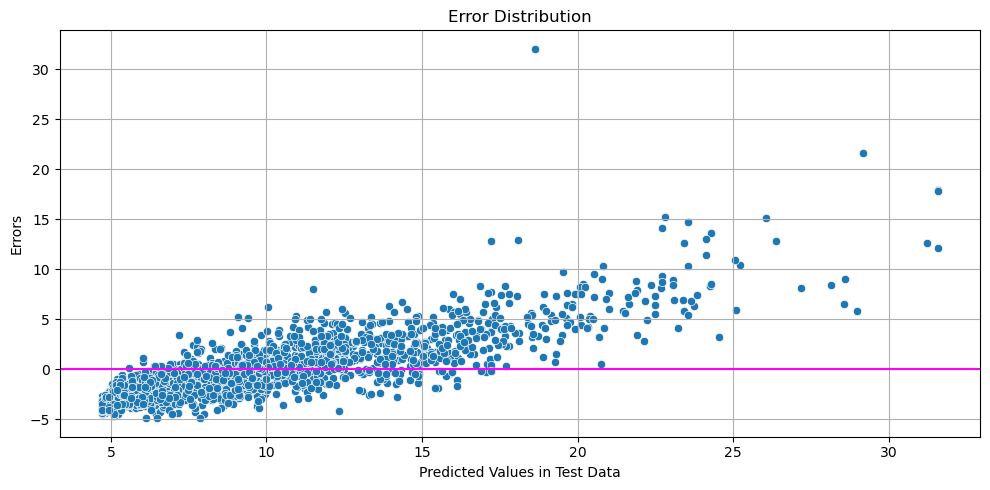

In [90]:
forest_evaluation(lgbm_regressor, X_train, X_test, y_train, y_test, nmhc_feature=False)

By increasing the values of these two hyperparameters (n_estimators and max_depth), we can observe an improvement in data prediction compared to when using small values for these parameters.

### LightGBM Regressor - Hyperparameters Tuning - w/o 'PT08.S2(NMHC)' feature

In [91]:
X_train_copy = X_train.copy(deep=True)
X_test_copy = X_test.copy(deep=True)

X_train_copy.pop("PT08.S2(NMHC)")
X_test_copy.pop("PT08.S2(NMHC)")

8448   -1.206424
5948    1.616440
5053   -0.201218
4839    1.134703
8976   -0.983151
          ...   
3923    0.091460
4876   -0.686929
5733    1.025831
4214    0.431246
4017    0.287059
Name: PT08.S2(NMHC), Length: 1799, dtype: float64

In [92]:
lgbm_regressor = LGBMRegressor(random_state=0)

In [93]:
parameters={"n_estimators": [50, 100, 150],
            "max_depth": [2, 3, 4],
            "learning_rate": [0.01, 0.05, 0.1, 0.2],
            "min_child_samples": [1, 5, 10, 20]
           }

scoring = make_scorer(r2, greater_is_better=True)

The selected hyperparameters for tuning the LGBMRegressor model were chosen to comprehensively explore various aspects of the model's configuration. The "n_estimators" parameter was examined across values of 50, 100, and 150 to assess the impact of the number of boosting rounds on the model's predictive performance.

The "max_depth" parameter, varying from 2 to 4, was chosen to investigate the influence of tree depth on the complexity of the model. Similarly, the "learning_rate" hyperparameter was tested with values of 0.01, 0.05, 0.1, and 0.2, representing the step size shrinkage at each iteration. This helps analyze the trade-off between model training speed and accuracy.

Additionally, the "min_child_samples" parameter was explored with values of 1, 5, 10, and 20, indicating the minimum number of data points required to split a node. This parameter contributes to controlling overfitting by ensuring a minimum amount of data is present in each leaf node.

In [94]:
params = {"verbose": -1}
lgbm_regressor.set_params(**params)

LGBMRegressor(random_state=0, verbose=-1)

In [95]:
tuning_model = GridSearchCV(lgbm_regressor, param_grid=parameters, 
                            scoring=scoring, cv=5, n_jobs=-1, refit=True)

In [96]:
tuning_model.fit(X_train_copy, y_train)
tuning_model.best_params_

{'learning_rate': 0.2,
 'max_depth': 4,
 'min_child_samples': 1,
 'n_estimators': 150}

In [97]:
lgbm_best_model = tuning_model.best_estimator_

In [98]:
y_train, y_train_pred, y_test, y_test_pred = target_feature_values_forest(lgbm_best_model, X_train_copy, X_test_copy, y_train, y_test)
    
rmse_train = mse(y_train, y_train_pred, squared=False)
rmse_test = mse(y_test, y_test_pred, squared=False)
print(f"Train RMSE: {rmse_train:.2f}")
print(f"Test RMSE: {rmse_test:.2f}", end="\n\n")

mae_train = mae(y_train, y_train_pred)
mae_test = mae(y_test, y_test_pred)
print(f"Train MAE: {mae_train:.2f}")
print(f"Test MAE: {mae_test:.2f}", end="\n\n")

r2_train = r2(y_train, y_train_pred)
r2_test = r2(y_test, y_test_pred)
print(f"Train R-squared: {r2_train:.2f}")
print(f"Test R-squared: {r2_test:.2f}", end="\n\n")

Train RMSE: 0.61
Test RMSE: 1.02

Train MAE: 0.47
Test MAE: 0.68

Train R-squared: 0.99
Test R-squared: 0.98



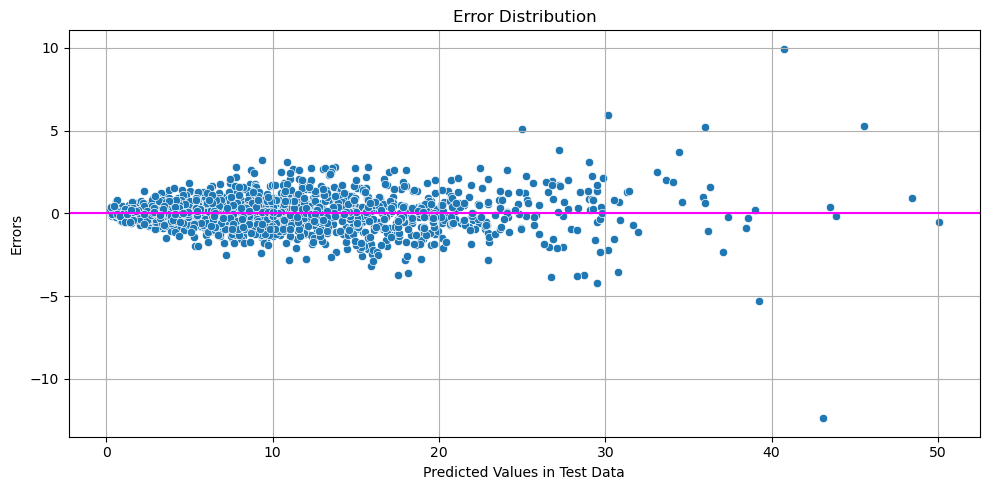

In [99]:
plot_error_distribution(y_test, y_test_pred)

We can observe that the model has a slight tendency to overfitting. The error distribution looks quite natural and resembles the distributions seen in regression tasks.

### LightGBM Regressor - Features Importance - for best lgbm model

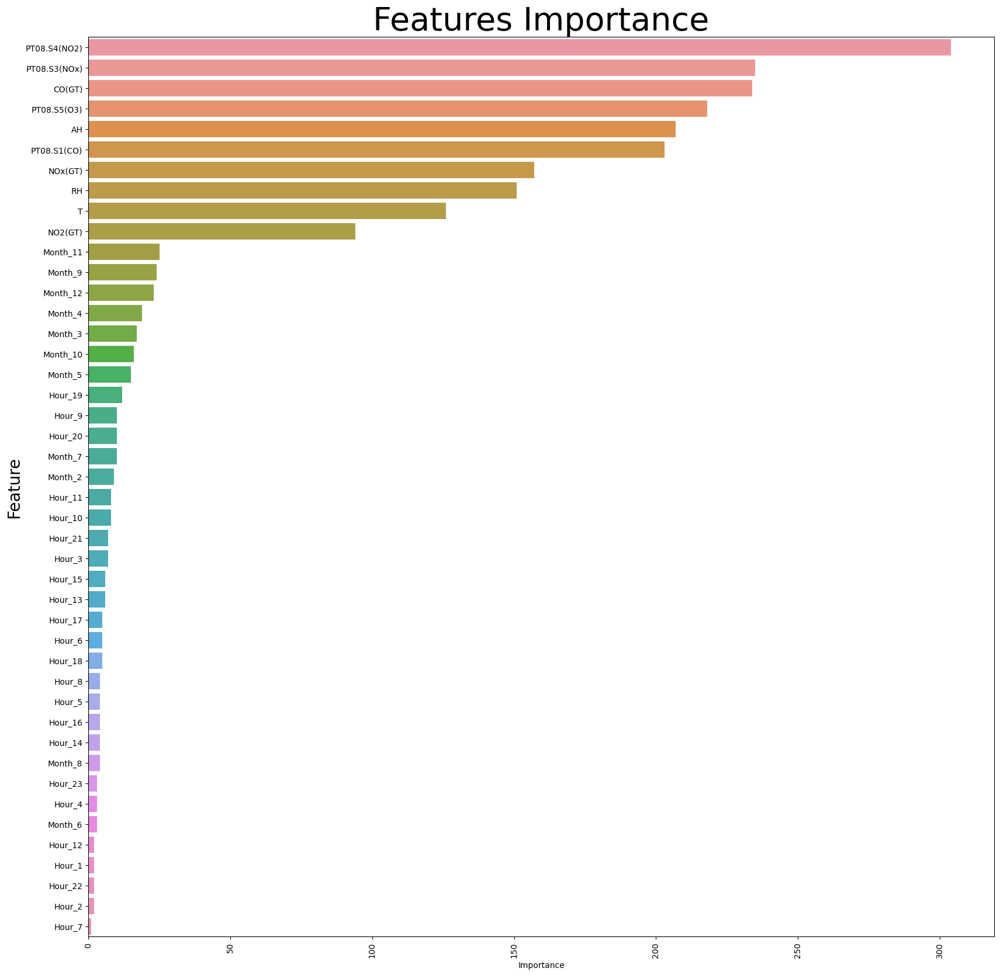

In [100]:
plot_feature_importance(lgbm_best_model, X_train_copy)

We can observe a greater number of features that contribute to the creation of the obtained model. The most significant ones include those that were also present in previous models, and additionally, parameters such as AH (Absolute Humidity), RH (Relative Humidity), and Temperature show notable importance.

---

## Models comparisons - from regression task and current tree-based models

In the context of comparing regression models, it can be observed that, in most cases, models from previous regression tasks tended to achieve better results, especially those incorporating regularization techniques. Models based on trees or forests are generally robust and serve as default choices in many scenarios. However, for this specific dataset, linear regression models outperformed others, and the best-performing models were based on Naive Bayes or simple linear regression.

---

# Classification problem

We're going to get the data ready for analysis, using the same method as we did for the Rain Prediction Australia Dataset Classification task. It helps to stick to a consistent process because the dataset has already been prepared well before. Plus, using a similar approach makes it simple to compare how different models perform with similarly preppered data in this analysis. It ensures a fair comparison across the board.

In [101]:
df = pd.read_csv("data/weatherAUS.csv")

In [102]:
df.head().T

,0,1,2,3,4
Date,2008-12-01,2008-12-02,2008-12-03,2008-12-04,2008-12-05
Location,Albury,Albury,Albury,Albury,Albury
MinTemp,13.4,7.4,12.9,9.2,17.5
MaxTemp,22.9,25.1,25.7,28.0,32.3
Rainfall,0.6,0.0,0.0,0.0,1.0
Evaporation,NaN,NaN,NaN,NaN,NaN
Sunshine,NaN,NaN,NaN,NaN,NaN
WindGustDir,W,WNW,WSW,NE,W
WindGustSpeed,44.0,44.0,46.0,24.0,41.0
WindDir9am,W,NNW,W,SE,ENE


## Data Preprocessing and Preparation

### Deleting rows with NaN values in RainTomorrow or RainToday features

It is acceptable to remove rows containing missing values in both our target feature and the 'RainToday' feature.

In [103]:
df = df[df["RainTomorrow"].notna()]
df = df[df["RainToday"].notna()]

### Replace Yes and No to 1 and 0 in Categorical Features

In [104]:
df["RainToday"].replace({"No": 0, "Yes": 1}, inplace = True)
df["RainTomorrow"].replace({"No": 0, "Yes": 1}, inplace = True)

### Change Date to Datetime type

In [105]:
df["Date"] = pd.to_datetime(df["Date"], format="%Y-%m-%d")

### Feature Names Division

In [106]:
target = "RainTomorrow"
target_feature = [target]
categorical_features = ["Date", "Location", "WindGustDir", "WindDir9am", "WindDir3pm", "RainToday"]
numerical_features = [col for col in df.columns if col not in (categorical_features + target_feature)]

In [107]:
df[categorical_features]

,Date,Location,WindGustDir,WindDir9am,WindDir3pm,RainToday
0,2008-12-01,Albury,W,W,WNW,0
1,2008-12-02,Albury,WNW,NNW,WSW,0
2,2008-12-03,Albury,WSW,W,WSW,0
3,2008-12-04,Albury,NE,SE,E,0
4,2008-12-05,Albury,W,ENE,NW,0
...,...,...,...,...,...,...
145454,2017-06-20,Uluru,E,ESE,E,0
145455,2017-06-21,Uluru,E,SE,ENE,0
145456,2017-06-22,Uluru,NNW,SE,N,0
145457,2017-06-23,Uluru,N,SE,WNW,0


In [108]:
df[numerical_features]

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm
0,13.4,22.9,0.6,NaN,NaN,44.0,20.0,24.0,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8
1,7.4,25.1,0.0,NaN,NaN,44.0,4.0,22.0,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3
2,12.9,25.7,0.0,NaN,NaN,46.0,19.0,26.0,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2
3,9.2,28.0,0.0,NaN,NaN,24.0,11.0,9.0,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5
4,17.5,32.3,1.0,NaN,NaN,41.0,7.0,20.0,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145454,3.5,21.8,0.0,NaN,NaN,31.0,15.0,13.0,59.0,27.0,1024.7,1021.2,NaN,NaN,9.4,20.9
145455,2.8,23.4,0.0,NaN,NaN,31.0,13.0,11.0,51.0,24.0,1024.6,1020.3,NaN,NaN,10.1,22.4
145456,3.6,25.3,0.0,NaN,NaN,22.0,13.0,9.0,56.0,21.0,1023.5,1019.1,NaN,NaN,10.9,24.5
145457,5.4,26.9,0.0,NaN,NaN,37.0,9.0,9.0,53.0,24.0,1021.0,1016.8,NaN,NaN,12.5,26.1


In [109]:
df[target_feature]

,RainTomorrow
0,0
1,0
2,0
3,0
4,0
...,...
145454,0
145455,0
145456,0
145457,0


### Removing NaN values in categorical features

<Axes: >

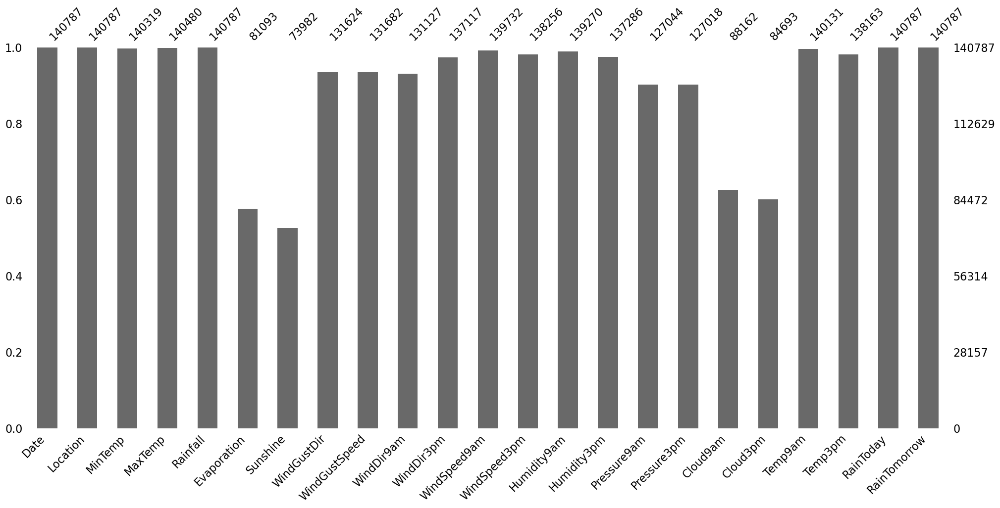

In [110]:
msno.bar(df)

Due to the relatively small number of NaN values compared to the total number of observations, we can safely remove all NaN values from categorical features.

In [111]:
df = df[df["WindDir9am"].notna()]
df = df[df["WindDir3pm"].notna()]
df = df[df["WindGustDir"].notna()]

<Axes: >

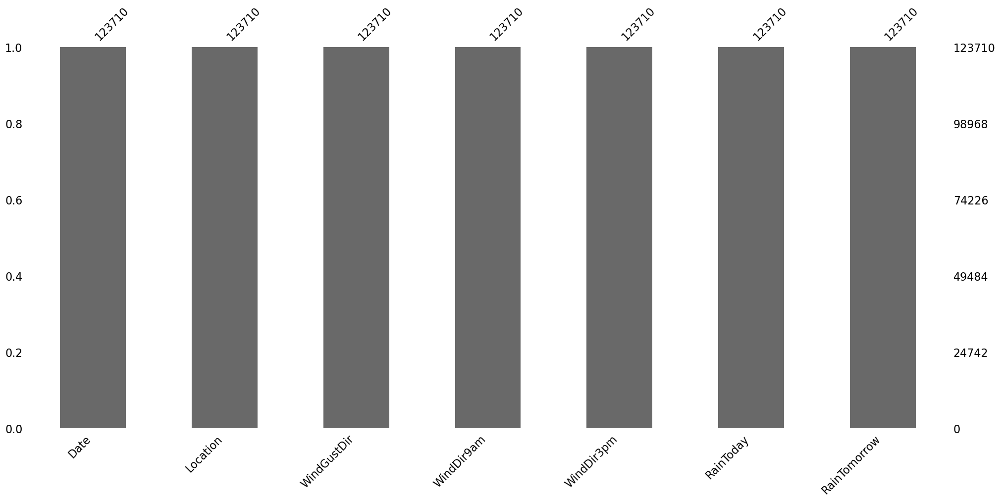

In [112]:
msno.bar(df[categorical_features+target_feature])

### Feature Engineering with 'Rainfall' Feature

Due to the fact that over half of the values are zero, it has been transformed into a categorical feature. The value 1 indicates that Rainfall had a non-zero value, while 0 indicates its absence.

In [113]:
df["Rainfall"].value_counts()

Rainfall
0.0      79552
0.2       7411
0.4       3289
0.6       2244
0.8       1762
         ...  
118.0        1
164.2        1
69.4         1
87.0         1
69.0         1
Name: count, Length: 647, dtype: int64

In [114]:
df["Rainfall"] = df["Rainfall"].apply(lambda x: 1 if x > 0 else 0)

In [115]:
df["Rainfall"].value_counts()

Rainfall
0    79552
1    44158
Name: count, dtype: int64

In [116]:
numerical_features.remove("Rainfall")
categorical_features.append("Rainfall")

### Train Test Split with Stratification

In [117]:
y = df.pop(target)

In [118]:
X_train, X_test, y_train, y_test = train_test_split(df, y, test_size=0.3, stratify=y, random_state=0)

In [119]:
X_train = X_train.sort_index()
X_test = X_test.sort_index()
y_train = y_train.sort_index()
y_test = y_test.sort_index()

In [120]:
X_train.head().T

,0,1,3,4,5
Date,2008-12-01 00:00:00,2008-12-02 00:00:00,2008-12-04 00:00:00,2008-12-05 00:00:00,2008-12-06 00:00:00
Location,Albury,Albury,Albury,Albury,Albury
MinTemp,13.4,7.4,9.2,17.5,14.6
MaxTemp,22.9,25.1,28.0,32.3,29.7
Rainfall,1,0,0,1,1
Evaporation,NaN,NaN,NaN,NaN,NaN
Sunshine,NaN,NaN,NaN,NaN,NaN
WindGustDir,W,WNW,NE,W,WNW
WindGustSpeed,44.0,44.0,24.0,41.0,56.0
WindDir9am,W,NNW,SE,ENE,W


In [121]:
X_test.head().T

,2,7,12,18,21
Date,2008-12-03 00:00:00,2008-12-08 00:00:00,2008-12-13 00:00:00,2008-12-19 00:00:00,2008-12-22 00:00:00
Location,Albury,Albury,Albury,Albury,Albury
MinTemp,12.9,7.7,15.9,11.2,17.1
MaxTemp,25.7,26.7,18.6,22.5,33.0
Rainfall,0,0,1,1,0
Evaporation,NaN,NaN,NaN,NaN,NaN
Sunshine,NaN,NaN,NaN,NaN,NaN
WindGustDir,WSW,W,W,SSE,NE
WindGustSpeed,46.0,35.0,61.0,43.0,43.0
WindDir9am,W,SSE,NNW,WSW,NE


### Numerical Features Imputation

With Iterative Imputer we can carry out the imputation process in several rounds until it reaches a stable state. This method is useful for grasping the connections and interdependencies between different features, enhancing the accuracy of imputations for missing values.

In [122]:
def join_test_train_cat_num(X_train_d, X_test_d, X_train, X_test):
    X_train_num = pd.DataFrame(X_train_d, columns=numerical_features, index=X_train.index)
    X_test_num = pd.DataFrame(X_test_d, columns=numerical_features, index=X_test.index)
    X_train = pd.concat([X_train_num, X_train[categorical_features]], axis=1)
    X_test = pd.concat([X_test_num, X_test[categorical_features]], axis=1)
    
    return X_train, X_test

In [123]:
iter_imputer = IterativeImputer(random_state=0).fit(X_train[numerical_features])
X_train_imputed = iter_imputer.transform(X_train[numerical_features])
X_test_imputed = iter_imputer.transform(X_test[numerical_features])

X_train, X_test = join_test_train_cat_num(X_train_imputed, X_test_imputed, X_train, X_test)

In [124]:
for feature in numerical_features:
    if feature not in ["MinTemp", "MaxTemp", "Temp9am", "Temp3pm"]:
        X_train = X_train[(X_train[feature] >= 0)]
        X_test = X_test[(X_test[feature] >= 0)]

y_train = y_train[X_train.index]
y_test = y_test[X_test.index]

In [125]:
for feature in ["Evaporation", "Sunshine", "WindSpeed9am", "WindSpeed3pm", "WindGustSpeed",
                "Humidity9am", "Humidity3pm", "Cloud9am", "Cloud3pm"]:
    X_train[feature] = X_train[feature].apply(lambda x: floor(x))
    X_test[feature] = X_test[feature].apply(lambda x: floor(x))

<Axes: >

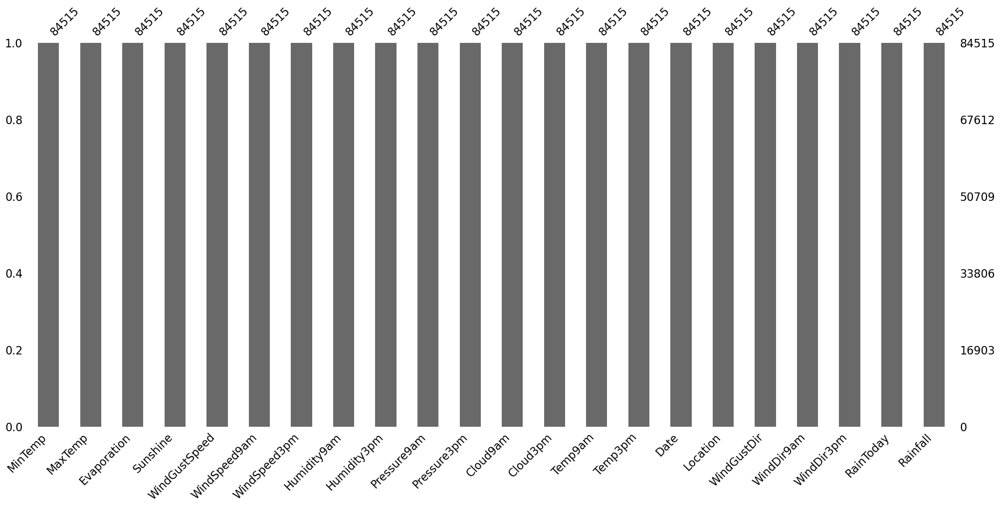

In [126]:
msno.bar(X_train)

<Axes: >

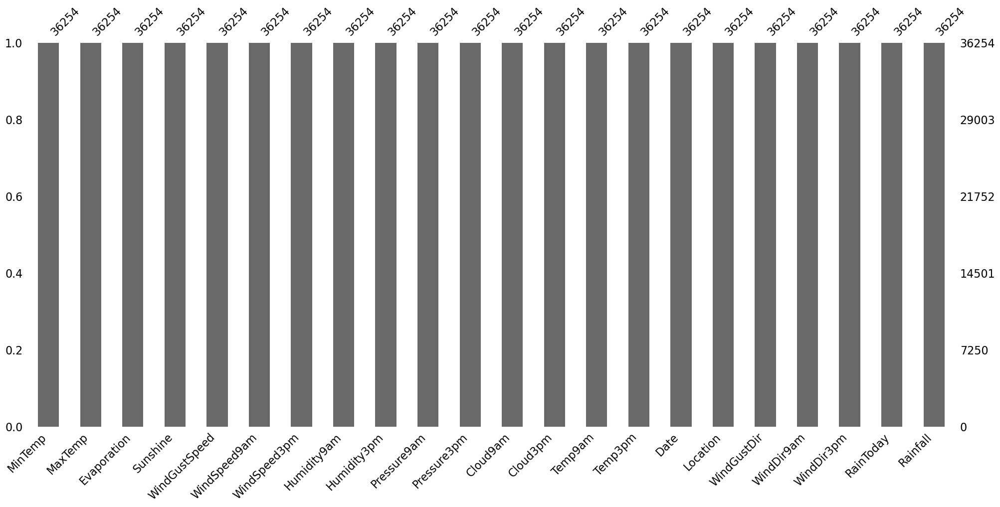

In [127]:
msno.bar(X_test)

In [128]:
def descriptive_plots(df, n_rows=8, n_cols=2):
    fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(12, 20))
    axes = axes.flatten()
    extended_describe = get_extended_description(df[numerical_features])

    for i, feature in enumerate(numerical_features):
        g = sns.histplot(data=df, x=feature, ax=axes[i], kde=True)

        axes[i].axvline(extended_describe.loc[feature, "upper_limit"], linewidth=2 , color="red")
        axes[i].axvline(extended_describe.loc[feature, "lower_limit"], linewidth=2 , color="red")
        axes[i].axvline(extended_describe.loc[feature, "mean"], linewidth=3 , color="yellow")
        axes[i].axvline(extended_describe.loc[feature, "50%"], linewidth=3 , color="magenta")
        g.set(ylabel=None)

    limits = mlines.Line2D([], [], color="red", linewidth=1, label="upper limit / lower limit")
    mean = mlines.Line2D([], [], color="yellow", linewidth=1, label="mean")
    median = mlines.Line2D([], [], color="magenta", linewidth=1, label="median")

    plt.legend(handles=[limits, mean, median], loc="center left", bbox_to_anchor=(1, 0.5))
    plt.suptitle("Numerical Features Histograms", fontsize=16)
    fig.text(0, 0.5, "Count", va="center", rotation="vertical", fontsize=16)

    plt.tight_layout()
    plt.show()

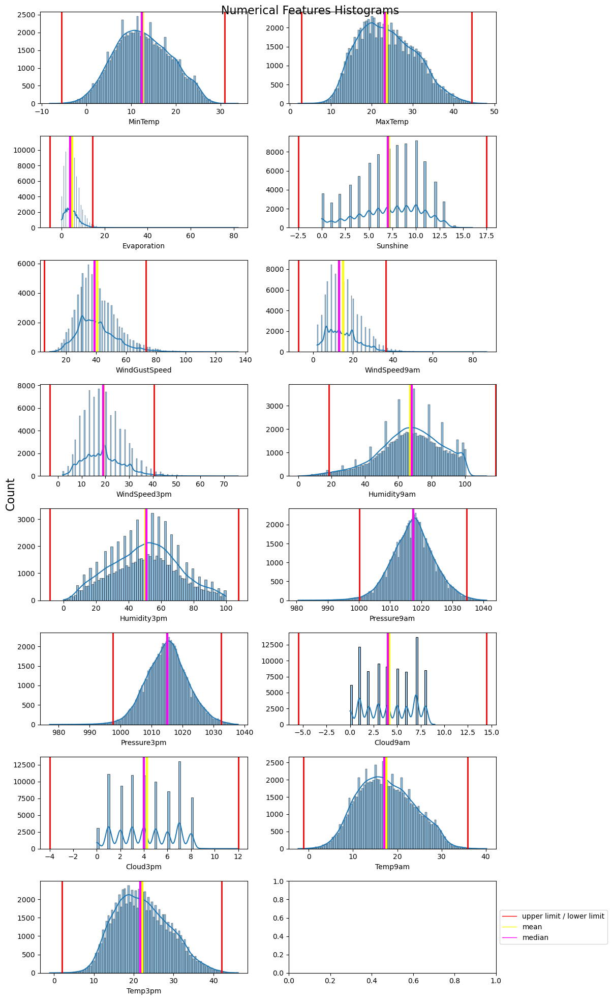

In [129]:
descriptive_plots(X_train)

### Numerical Features Standardization

Due to the distribution of our numerical features tending to be Gaussian, we can apply standardization to the numerical data.

In [130]:
std_scaler = StandardScaler().fit(X_train[numerical_features])
X_train_scaled = std_scaler.transform(X_train[numerical_features])
X_test_scaled = std_scaler.transform(X_test[numerical_features])

X_train, X_test = join_test_train_cat_num(X_train_scaled, X_test_scaled, X_train, X_test)

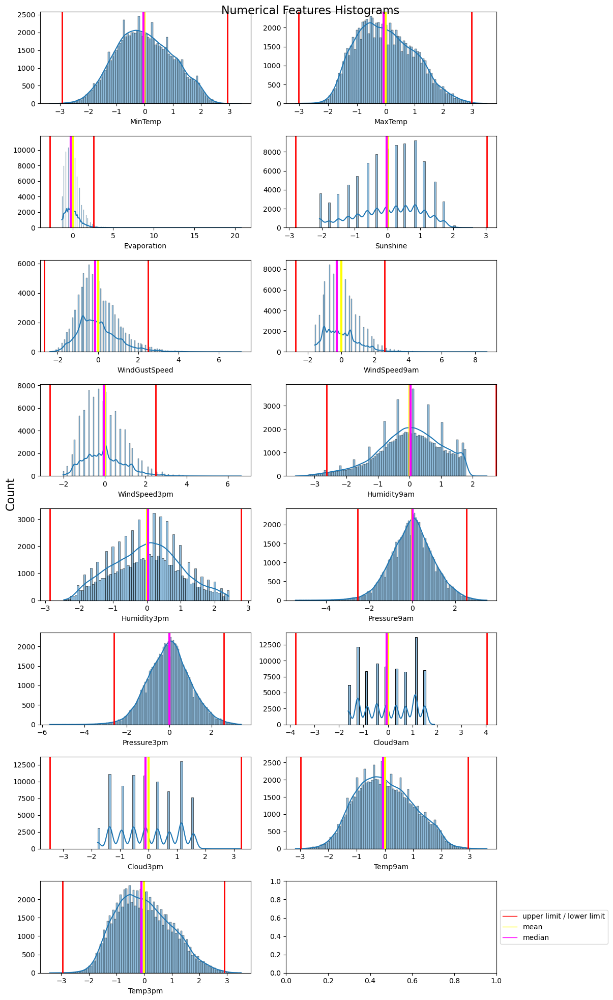

In [131]:
descriptive_plots(X_train)

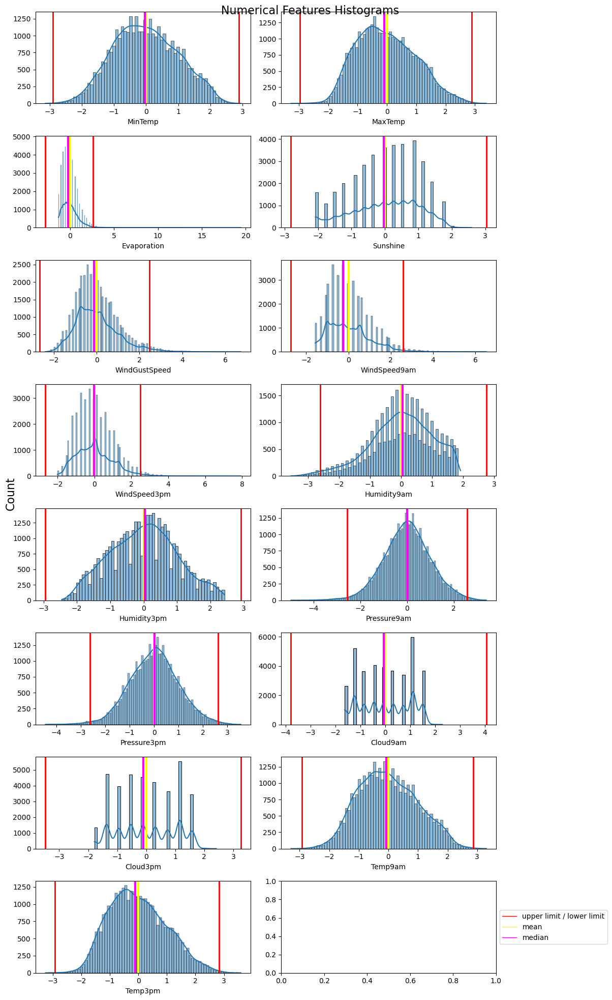

In [132]:
descriptive_plots(X_test)

### Feature Engineering with Categorical Feature 'Date'

Due to the small changes in data across days and years for a given month, we can extract the month and year from the 'Date' feature and subsequently remove the 'Date' column.

In [133]:
X_train["Month"] = X_train["Date"].dt.month
X_train["Year"] = X_train["Date"].dt.year
X_test["Month"] = X_test["Date"].dt.month
X_test["Year"] = X_test["Date"].dt.year

In [134]:
X_train.drop(columns=["Date"], inplace=True)
X_test.drop(columns=["Date"], inplace=True)

In [135]:
categorical_features.remove("Date")

In [136]:
categorical_features.extend(["Month", "Year"])

### Categorical Data Encoding

In [137]:
oh_encoder = OneHotEncoder(drop="first", sparse=False)

preprocessor = ColumnTransformer(
    transformers=[
        ("cat", oh_encoder, categorical_features)
    ])

X_train_cat_enc = preprocessor.fit_transform(X_train)
X_test_cat_enc = preprocessor.transform(X_test)

oh_feature_names = preprocessor.named_transformers_["cat"].get_feature_names_out(input_features=categorical_features)

X_train_cat_enc = pd.DataFrame(X_train_cat_enc, columns=oh_feature_names, index=X_train.index)
X_test_cat_enc = pd.DataFrame(X_test_cat_enc, columns=oh_feature_names, index=X_test.index)

X_train = pd.concat([X_train[numerical_features], X_train_cat_enc], axis=1)
X_test = pd.concat([X_test[numerical_features], X_test_cat_enc], axis=1)

---

## Modeling

In [138]:
def plot_conf_matrix(y_pred, X_test, y_test):    
    plt.figure(figsize=(8, 6))
    sns.heatmap(confusion_matrix(y_test, y_pred), annot=True, fmt="d", cmap="Purples",
                xticklabels=["False", "True"], yticklabels=["False", "True"])
    plt.xlabel("Predicted label")
    plt.ylabel("Actual label")
    plt.title("Confusion Matrix")
    plt.show()

In [139]:
def plot_roc_curve(y_pred_proba, X_test, y_test):
    with sns.axes_style("darkgrid"):
        y_pred_proba = pd.DataFrame(y_pred_proba)[1]
        fp_rate, tp_rate, threshold = roc_curve(y_test, y_pred_proba)
        plt.figure(figsize=(8, 6))
        plt.plot(fp_rate, tp_rate, color="red")
        plt.plot([0, 1], [0, 1], color="black", linestyle='--')
        plt.xlim([-0.01, 1])
        plt.ylim([0, 1.01])
        plt.xlabel("False Positive Rate")
        plt.ylabel("True Positive Rate")
        plt.title("ROC Curve")
        plt.show()

In [140]:
def get_results(model, y_pred, y_pred_proba, X_train, y_train, X_test, y_test):
    y_pred_proba = y_pred_proba[:, 1]
    
    print(f"Precision: {precision_score(y_test, y_pred):.4f}")
    print(f"Recall: {recall_score(y_test, y_pred):.4f}")
    print(f"F1 score: {f1_score(y_test, y_pred):.4f}")
    print(f"ROC-AUC score : {roc_auc_score(y_test, y_pred_proba):.4f}")
    print("-"*40)
    print(f"Train score: {model.score(X_train.values, y_train.values):.4f}")
    print(f"Test score: {model.score(X_test.values, y_test.values):.4f}")
    print("-"*40)
    print('\nClassification Report:\n', classification_report(y_test, y_pred))

In [141]:
def results(model, y_pred, y_pred_proba, X_train, y_train, X_test, y_test, print_tree=False):
    plot_conf_matrix(y_pred, X_test, y_test)
    print("-"*70)
    plot_roc_curve(y_pred_proba, X_test, y_test)
    print("-"*70)
    get_results(model, y_pred, y_pred_proba, X_train, y_train, X_test, y_test)
    print("-"*70)
    if print_tree:
        _, ax = plt.subplots(figsize=(20, 12))
        _ = plot_tree(model, ax=ax, feature_names=X_train_copy.columns.tolist())

### Mitigating Dataset Imbalance through Class Weighting

We should apply class weights to address the issue of dataset imbalance. A higher weight is assigned to the minority class '1' in this case, allowing the model to somewhat balance both classes that are inherently unbalanced.

The impact of using class weights on model results will be beneficial in further analysis. By assigning a higher weight to the minority class, the model is encouraged to pay more attention to the less frequent class during training. This helps mitigate the bias towards the majority class and improves the model's ability to correctly classify instances of the minority class. As a result, incorporating class weights will lead to more balanced and accurate predictions in this analysis.

In [142]:
class_counts = y_train.value_counts()
class_counts

RainTomorrow
0    66055
1    18460
Name: count, dtype: int64

In [143]:
class_weights = {cls: len(X_train)/(len(class_counts)*count) for cls, count in class_counts.items()}
class_weights

{0: 0.6397320414805844, 1: 2.289138678223185}

---

### Decision Tree Classifier 

Now, we will explore the impact of max_depth on classification.

#### max_depth=2

In [144]:
tree_clf = DecisionTreeClassifier(max_depth=2, random_state=0, class_weight=class_weights)

In [145]:
tree_clf.fit(X_train, y_train)

DecisionTreeClassifier(class_weight={0: 0.6397320414805844,
                                     1: 2.289138678223185},
                       max_depth=2, random_state=0)

In [146]:
y_pred = tree_clf.predict(X_test)
y_pred_proba = tree_clf.predict_proba(X_test)

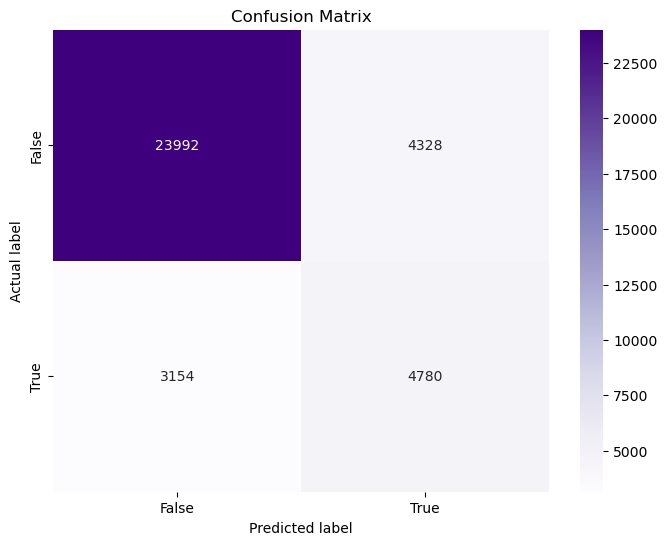

----------------------------------------------------------------------


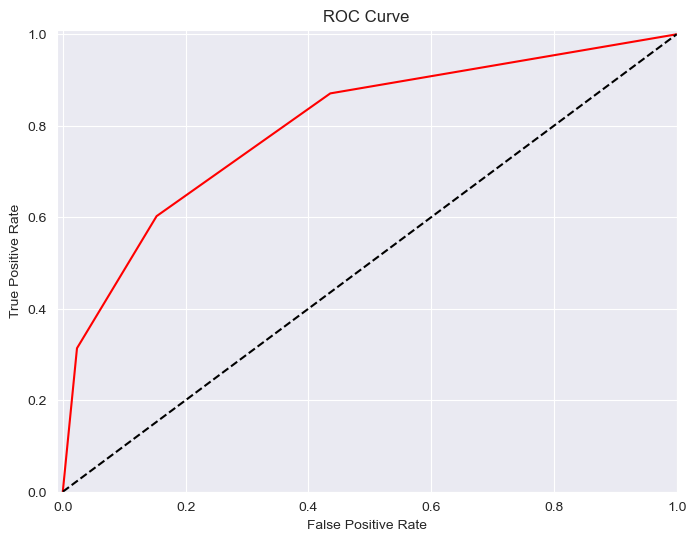

----------------------------------------------------------------------
Precision: 0.5248
Recall: 0.6025
F1 score: 0.5610
ROC-AUC score : 0.7993
----------------------------------------
Train score: 0.7960
Test score: 0.7936
----------------------------------------

Classification Report:
               precision    recall  f1-score   support

           0       0.88      0.85      0.87     28320
           1       0.52      0.60      0.56      7934

    accuracy                           0.79     36254
   macro avg       0.70      0.72      0.71     36254
weighted avg       0.81      0.79      0.80     36254

----------------------------------------------------------------------


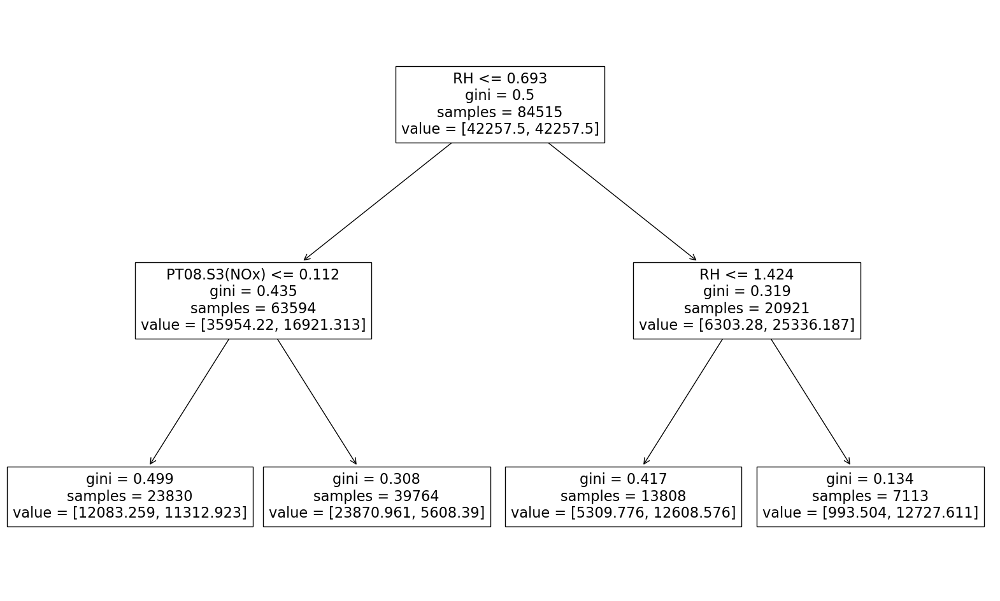

In [147]:
results(tree_clf, y_pred, y_pred_proba, X_train, y_train, X_test, y_test, print_tree=True)

We can observe that the dataset is best divided by the features RH (Relative Humidity) and PT08.S3(NOx). The number of samples in each branch node is predominant, indicating an optimal choice of splits by the model to fit within the specified constraints, such as maximum depth or maximum leaf nodes. In this case, three distinctive nodes can be identified, effectively partitioning the dataset.

#### max_depth=4

In [148]:
tree_clf = DecisionTreeClassifier(max_depth=4, random_state=0, class_weight=class_weights)

In [149]:
tree_clf.fit(X_train, y_train)

DecisionTreeClassifier(class_weight={0: 0.6397320414805844,
                                     1: 2.289138678223185},
                       max_depth=4, random_state=0)

In [150]:
y_pred = tree_clf.predict(X_test)
y_pred_proba = tree_clf.predict_proba(X_test)

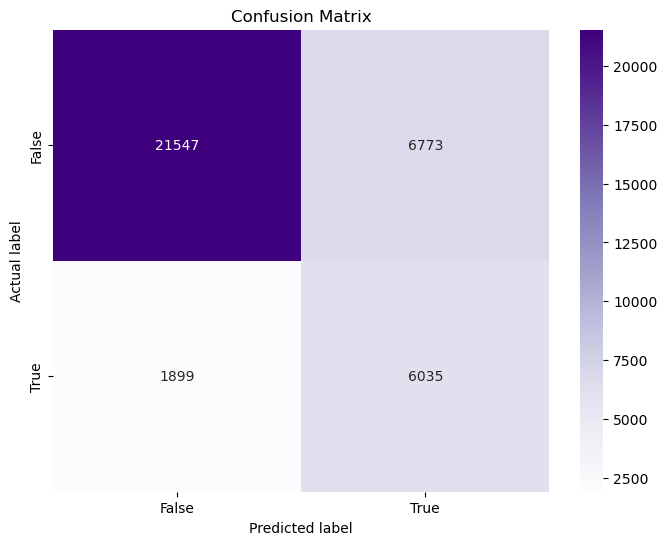

----------------------------------------------------------------------


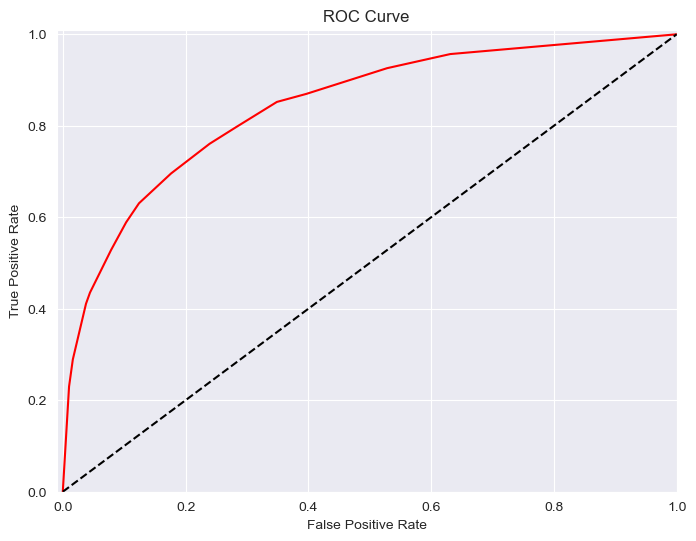

----------------------------------------------------------------------
Precision: 0.4712
Recall: 0.7607
F1 score: 0.5819
ROC-AUC score : 0.8419
----------------------------------------
Train score: 0.7616
Test score: 0.7608
----------------------------------------

Classification Report:
               precision    recall  f1-score   support

           0       0.92      0.76      0.83     28320
           1       0.47      0.76      0.58      7934

    accuracy                           0.76     36254
   macro avg       0.70      0.76      0.71     36254
weighted avg       0.82      0.76      0.78     36254

----------------------------------------------------------------------


In [151]:
results(tree_clf, y_pred, y_pred_proba, X_train, y_train, X_test, y_test)

#### max_depth=6

In [152]:
tree_clf = DecisionTreeClassifier(max_depth=6, random_state=0, class_weight=class_weights)

In [153]:
tree_clf.fit(X_train, y_train)

DecisionTreeClassifier(class_weight={0: 0.6397320414805844,
                                     1: 2.289138678223185},
                       max_depth=6, random_state=0)

In [154]:
y_pred = tree_clf.predict(X_test)
y_pred_proba = tree_clf.predict_proba(X_test)

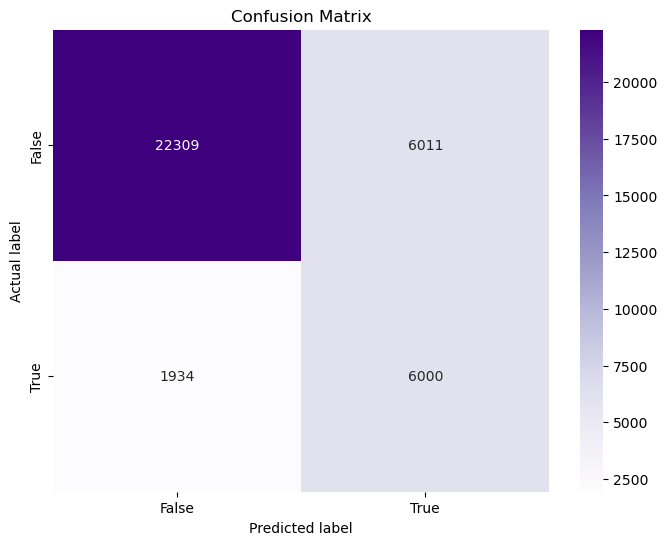

----------------------------------------------------------------------


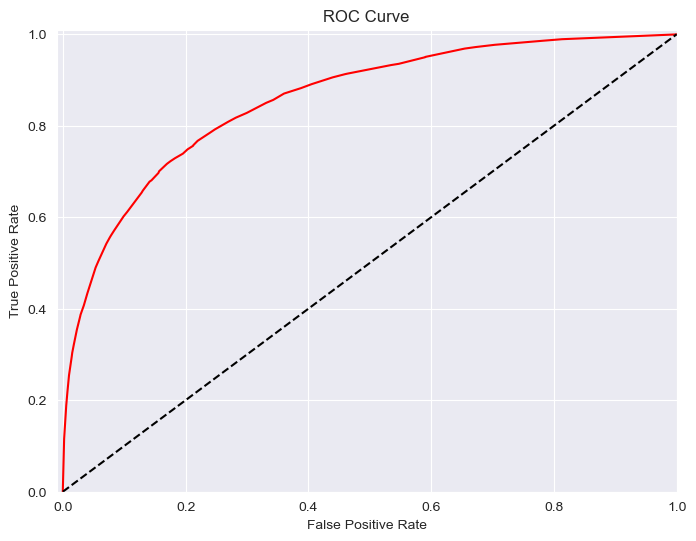

----------------------------------------------------------------------
Precision: 0.4995
Recall: 0.7562
F1 score: 0.6017
ROC-AUC score : 0.8561
----------------------------------------
Train score: 0.7869
Test score: 0.7809
----------------------------------------

Classification Report:
               precision    recall  f1-score   support

           0       0.92      0.79      0.85     28320
           1       0.50      0.76      0.60      7934

    accuracy                           0.78     36254
   macro avg       0.71      0.77      0.73     36254
weighted avg       0.83      0.78      0.79     36254

----------------------------------------------------------------------


In [155]:
results(tree_clf, y_pred, y_pred_proba, X_train, y_train, X_test, y_test)

Increasing the max_depth hyperparameter improves in the F1 score, ROC-AUC score and also precision or recall in both macro and weighted avg, which are universal metrics for classifiers. The results are similar to those obtained in the previous analysis concerning classifiers like Logistic Regression, KNN, Naive Bayes, and SVM.

#### criterion="gini" (default)

In [156]:
tree_clf = DecisionTreeClassifier(criterion="gini", max_depth=6, random_state=0, class_weight=class_weights)

In [157]:
tree_clf.fit(X_train, y_train)

DecisionTreeClassifier(class_weight={0: 0.6397320414805844,
                                     1: 2.289138678223185},
                       max_depth=6, random_state=0)

In [158]:
y_pred = tree_clf.predict(X_test)
y_pred_proba = tree_clf.predict_proba(X_test)

#### criterion="entropy"

In [160]:
tree_clf = DecisionTreeClassifier(criterion="entropy", max_depth=6, random_state=0, class_weight=class_weights)

In [161]:
tree_clf.fit(X_train, y_train)

DecisionTreeClassifier(class_weight={0: 0.6397320414805844,
                                     1: 2.289138678223185},
                       criterion='entropy', max_depth=6, random_state=0)

In [162]:
y_pred = tree_clf.predict(X_test)
y_pred_proba = tree_clf.predict_proba(X_test)

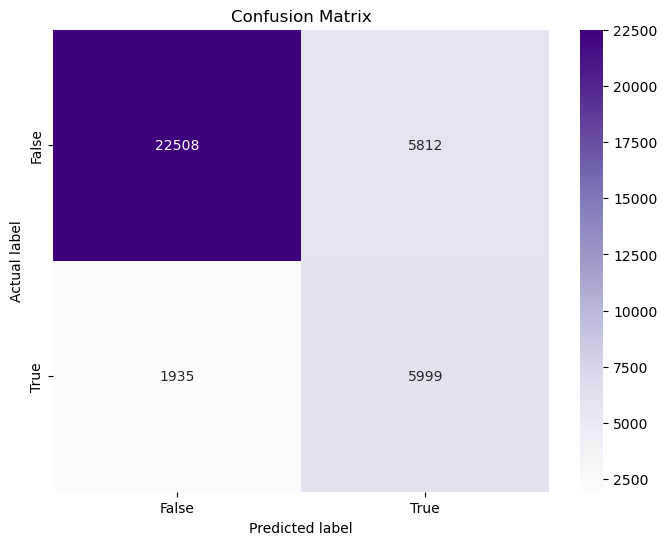

----------------------------------------------------------------------


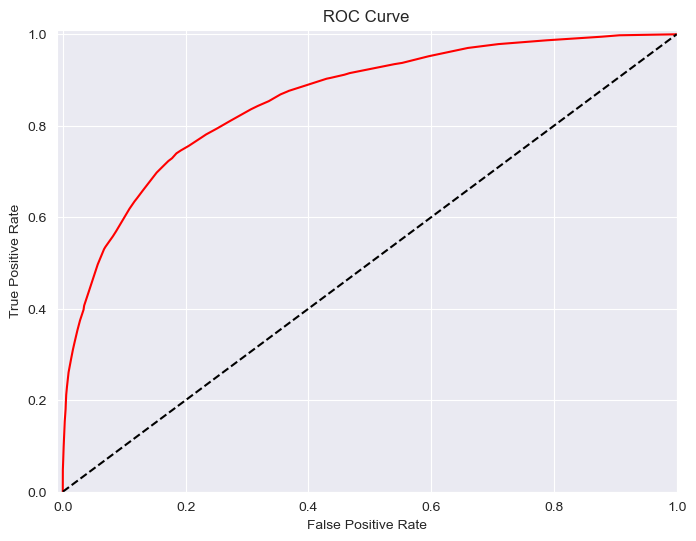

----------------------------------------------------------------------
Precision: 0.5079
Recall: 0.7561
F1 score: 0.6076
ROC-AUC score : 0.8570
----------------------------------------
Train score: 0.7901
Test score: 0.7863
----------------------------------------

Classification Report:
               precision    recall  f1-score   support

           0       0.92      0.79      0.85     28320
           1       0.51      0.76      0.61      7934

    accuracy                           0.79     36254
   macro avg       0.71      0.78      0.73     36254
weighted avg       0.83      0.79      0.80     36254

----------------------------------------------------------------------


In [163]:
results(tree_clf, y_pred, y_pred_proba, X_train, y_train, X_test, y_test)

By altering the 'criterion' parameter (the function to measure the quality of a split), no significant changes in the overall results are observed. Slightly improved results are noted when the model employs the 'entropy' criterion, where in this case it is a measure of impurity used to evaluate the quality of a split. The choice of criterion may influence the model's performance, but in this case, the dataset characteristics may not be strongly impacted by the specific criterion, leading to only marginal improvements.

#### max_leaf_nodes=4

In [164]:
tree_clf = DecisionTreeClassifier(max_leaf_nodes=4, random_state=0, class_weight=class_weights)

In [165]:
tree_clf.fit(X_train, y_train)

DecisionTreeClassifier(class_weight={0: 0.6397320414805844,
                                     1: 2.289138678223185},
                       max_leaf_nodes=4, random_state=0)

In [166]:
y_pred = tree_clf.predict(X_test)
y_pred_proba = tree_clf.predict_proba(X_test)

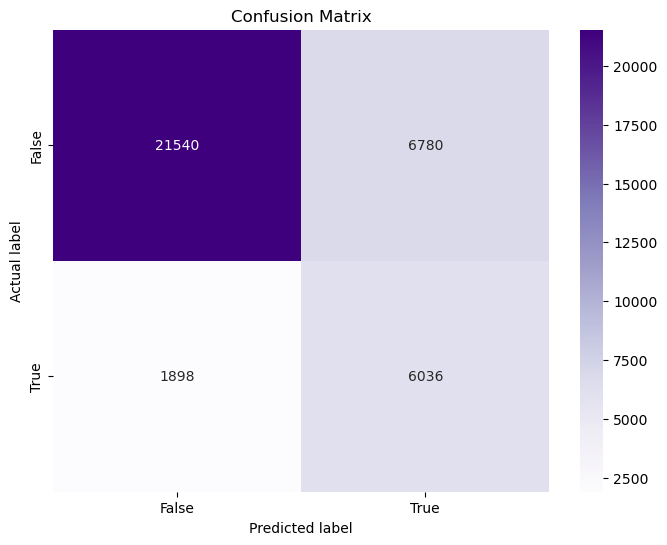

----------------------------------------------------------------------


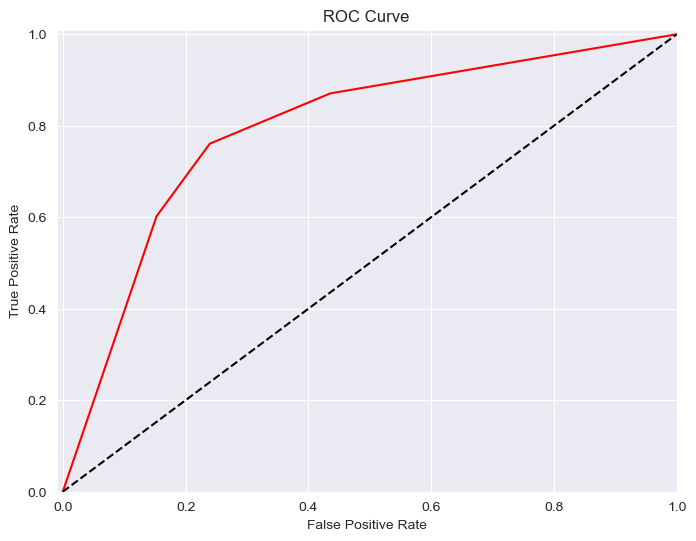

----------------------------------------------------------------------
Precision: 0.4710
Recall: 0.7608
F1 score: 0.5818
ROC-AUC score : 0.7930
----------------------------------------
Train score: 0.7614
Test score: 0.7606
----------------------------------------

Classification Report:
               precision    recall  f1-score   support

           0       0.92      0.76      0.83     28320
           1       0.47      0.76      0.58      7934

    accuracy                           0.76     36254
   macro avg       0.69      0.76      0.71     36254
weighted avg       0.82      0.76      0.78     36254

----------------------------------------------------------------------


In [167]:
results(tree_clf, y_pred, y_pred_proba, X_train, y_train, X_test, y_test)

#### max_leaf_nodes=20

In [168]:
tree_clf = DecisionTreeClassifier(max_leaf_nodes=20, random_state=0, class_weight=class_weights)

In [169]:
tree_clf.fit(X_train, y_train)

DecisionTreeClassifier(class_weight={0: 0.6397320414805844,
                                     1: 2.289138678223185},
                       max_leaf_nodes=20, random_state=0)

In [170]:
y_pred = tree_clf.predict(X_test)
y_pred_proba = tree_clf.predict_proba(X_test)

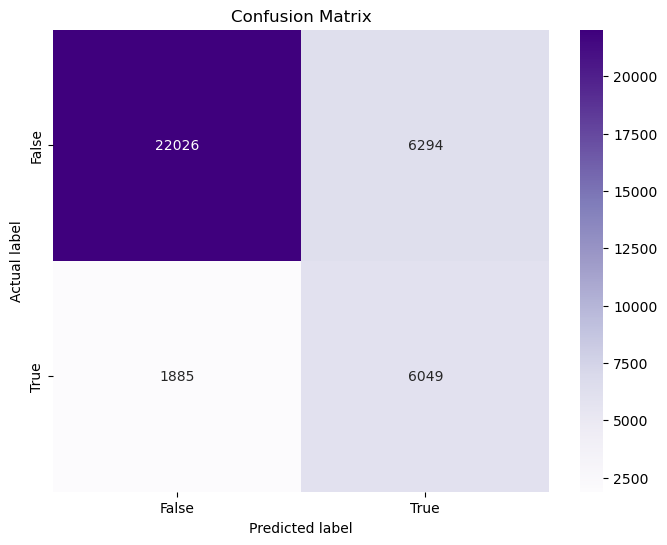

----------------------------------------------------------------------


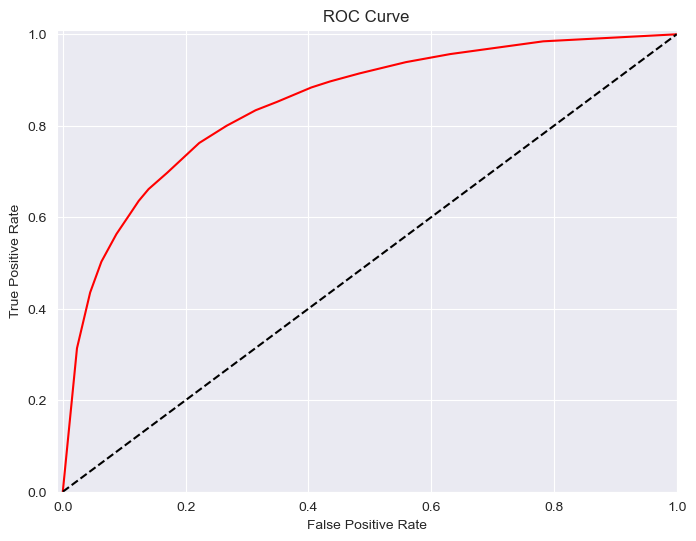

----------------------------------------------------------------------
Precision: 0.4901
Recall: 0.7624
F1 score: 0.5966
ROC-AUC score : 0.8474
----------------------------------------
Train score: 0.7743
Test score: 0.7744
----------------------------------------

Classification Report:
               precision    recall  f1-score   support

           0       0.92      0.78      0.84     28320
           1       0.49      0.76      0.60      7934

    accuracy                           0.77     36254
   macro avg       0.71      0.77      0.72     36254
weighted avg       0.83      0.77      0.79     36254

----------------------------------------------------------------------


In [171]:
results(tree_clf, y_pred, y_pred_proba, X_train, y_train, X_test, y_test)

By increasing the max_leaf_nodes parameter, we observe an improvement in metrics such as F1 score and ROC-AUC score, similar to the effect observed when increasing the depth of a decision tree.

#### min_impurity_decrease=0.01 and max_depth=6

In [172]:
tree_clf = DecisionTreeClassifier(min_impurity_decrease=0.01, max_depth=6, random_state=0, class_weight=class_weights)

In [173]:
tree_clf.fit(X_train, y_train)

DecisionTreeClassifier(class_weight={0: 0.6397320414805844,
                                     1: 2.289138678223185},
                       max_depth=6, min_impurity_decrease=0.01, random_state=0)

In [174]:
y_pred = tree_clf.predict(X_test)
y_pred_proba = tree_clf.predict_proba(X_test)

#### min_impurity_decrease=0.1 and max_depth=6

In [176]:
tree_clf = DecisionTreeClassifier(min_impurity_decrease=0.1, max_depth=6, random_state=0, class_weight=class_weights)

In [177]:
tree_clf.fit(X_train, y_train)

DecisionTreeClassifier(class_weight={0: 0.6397320414805844,
                                     1: 2.289138678223185},
                       max_depth=6, min_impurity_decrease=0.1, random_state=0)

In [178]:
y_pred = tree_clf.predict(X_test)
y_pred_proba = tree_clf.predict_proba(X_test)

### Decision Tree Classifier - Hyperparameters Tuning

In [180]:
tree_clf = DecisionTreeClassifier(random_state=0, class_weight=class_weights)

In [181]:
parameters={"criterion": ["gini", "entropy"],
            "max_depth": [2, 4, 6],
            "min_samples_leaf": [5, 10, 15, 20],
            "splitter": ["best", "random"]
           }

The "criterion" parameter was varied between "gini" and "entropy" to evaluate the impact of different impurity measures on the model's decision-making process.

The "max_depth" parameter was explored with values of 2, 4, and 6 to assess the influence of tree depth on the complexity of the model. Simultaneously, the "min_samples_leaf" parameter was tested with values of 5, 10, 15, and 20, representing the minimum number of samples required to form a leaf node. This parameter helps control overfitting by regulating the minimum size of leaf nodes.

Additionally, the "splitter" parameter was explored with both "best" and "random" values, determining the strategy used to choose the split at each node. This exploration provides insights into the impact of split strategies on the model's performance.

In [182]:
tuning_model = GridSearchCV(tree_clf, param_grid=parameters, 
                            refit="roc_auc", scoring=["f1", "roc_auc"], cv=5, n_jobs=-1)

In [183]:
tuning_model.fit(X_train, y_train)
tuning_model.best_params_

{'criterion': 'entropy',
 'max_depth': 6,
 'min_samples_leaf': 5,
 'splitter': 'best'}

In [184]:
tree_clf_best_model = tuning_model.best_estimator_

In [185]:
y_pred = tree_clf_best_model.predict(X_test)
y_pred_proba = tree_clf_best_model.predict_proba(X_test)

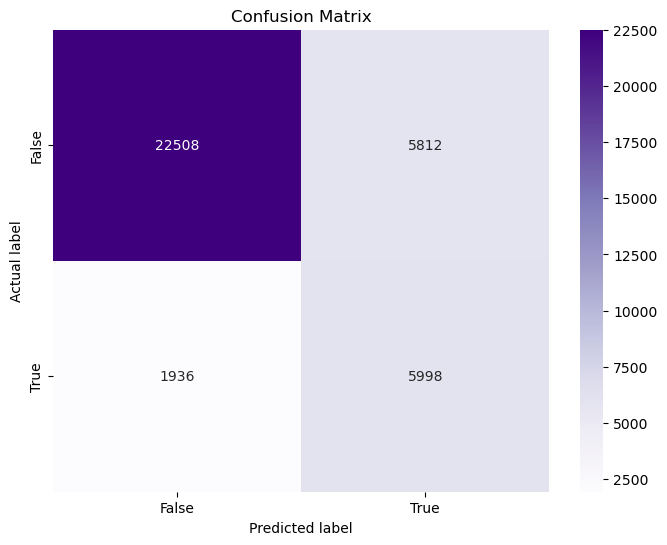

----------------------------------------------------------------------


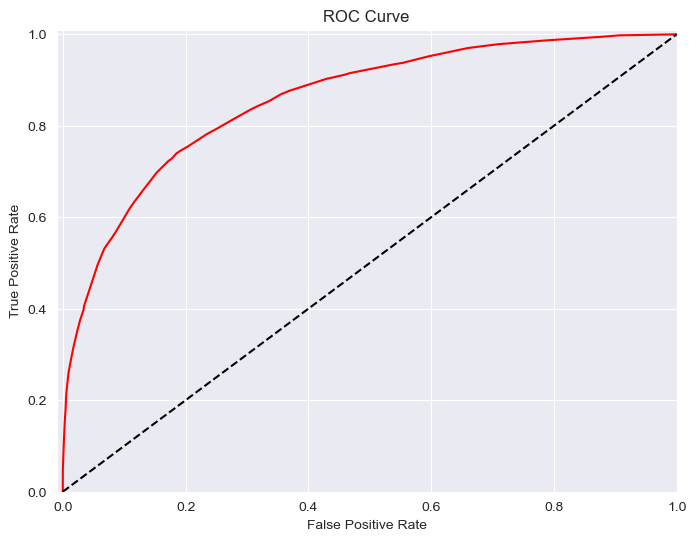

----------------------------------------------------------------------
Precision: 0.5079
Recall: 0.7560
F1 score: 0.6076
ROC-AUC score : 0.8568
----------------------------------------
Train score: 0.7901
Test score: 0.7863
----------------------------------------

Classification Report:
               precision    recall  f1-score   support

           0       0.92      0.79      0.85     28320
           1       0.51      0.76      0.61      7934

    accuracy                           0.79     36254
   macro avg       0.71      0.78      0.73     36254
weighted avg       0.83      0.79      0.80     36254

----------------------------------------------------------------------


In [186]:
results(tree_clf_best_model, y_pred, y_pred_proba, X_train, y_train, X_test, y_test)

Despite the good performance and results of the model, it doesn't differ significantly from those considered earlier. This suggests that decision trees are less sensitive to hyperparameter tuning, but they generalize well, making them a practical choice when a quick classification model is needed for data analysis.

### Decision Tree Classifier - Features Importance - for best tree model

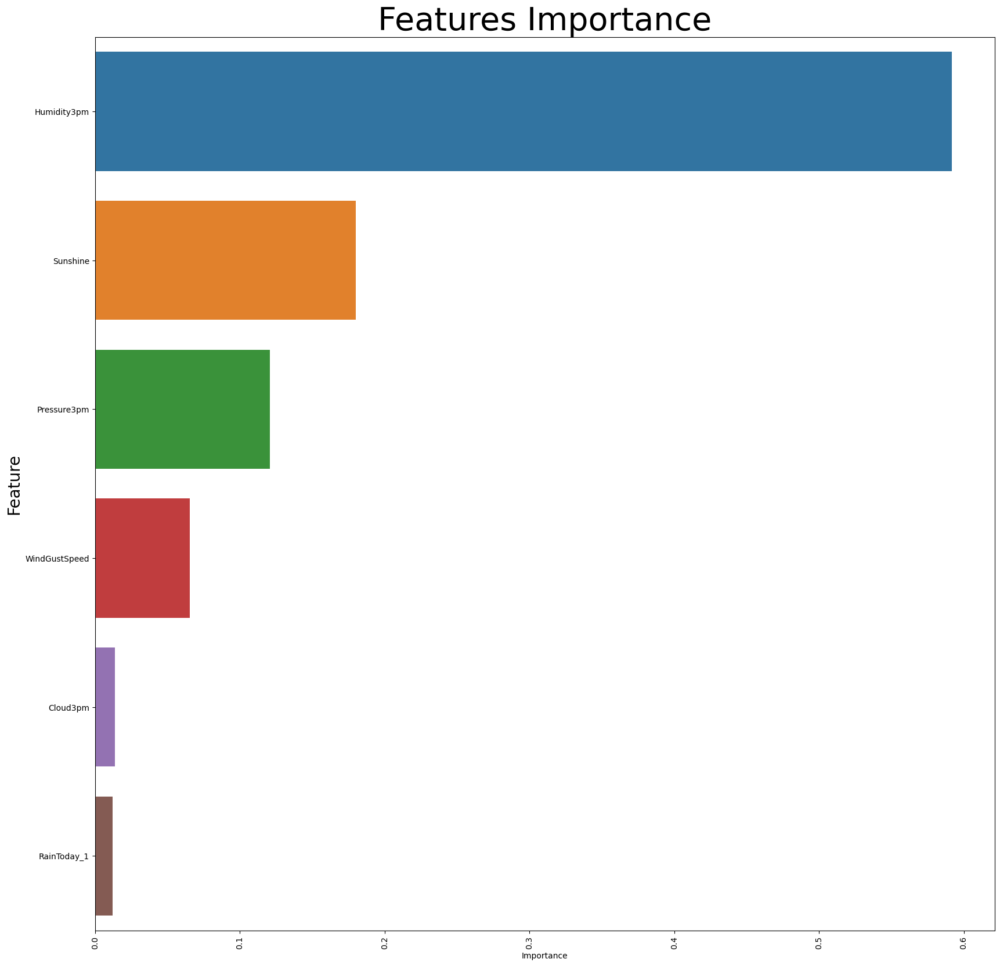

In [187]:
plot_feature_importance(tree_clf_best_model, X_train)

In this case, there are few features with significant importance. The most crucial ones are Humidity at 3pm, Sunshine, and Pressure at 3pm, which is understandable.

---

### Random Forest Classifier 

For the Random Forest classifier, we can start with parameters n_estimators=4 and max_depth=4, and then gradually increase them to observe how the obtained results change.

#### n_estimators=4, max_depth=4

In [188]:
forest_clf = RandomForestClassifier(n_estimators=4, max_depth=4, random_state=0, class_weight=class_weights)

In [189]:
forest_clf.fit(X_train, y_train)

RandomForestClassifier(class_weight={0: 0.6397320414805844,
                                     1: 2.289138678223185},
                       max_depth=4, n_estimators=4, random_state=0)

In [190]:
y_pred = forest_clf.predict(X_test)
y_pred_proba = forest_clf.predict_proba(X_test)

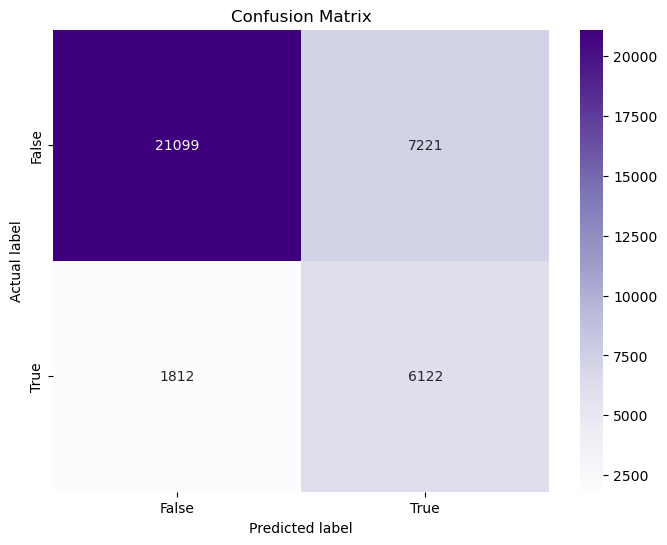

----------------------------------------------------------------------


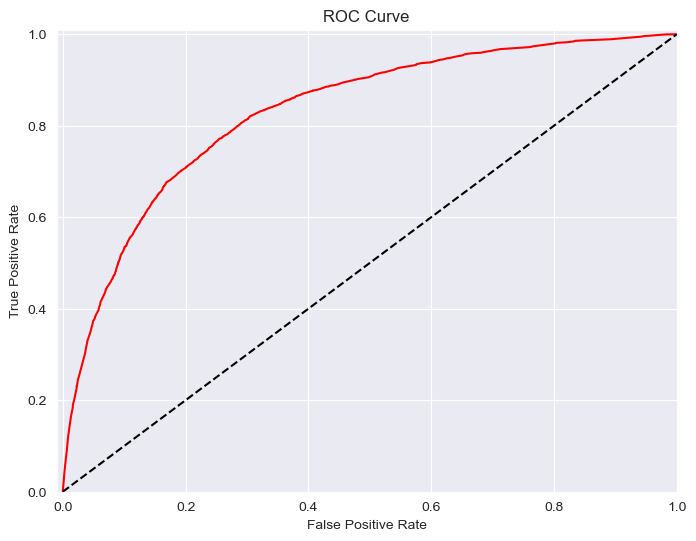

----------------------------------------------------------------------
Precision: 0.4588
Recall: 0.7716
F1 score: 0.5755
ROC-AUC score : 0.8306
----------------------------------------
Train score: 0.7530
Test score: 0.7508
----------------------------------------

Classification Report:
               precision    recall  f1-score   support

           0       0.92      0.75      0.82     28320
           1       0.46      0.77      0.58      7934

    accuracy                           0.75     36254
   macro avg       0.69      0.76      0.70     36254
weighted avg       0.82      0.75      0.77     36254

----------------------------------------------------------------------


In [191]:
results(forest_clf, y_pred, y_pred_proba, X_train, y_train, X_test, y_test)

#### n_estimators=10, max_depth=4

In [192]:
forest_clf = RandomForestClassifier(n_estimators=10, max_depth=4, random_state=0, class_weight=class_weights)

In [193]:
forest_clf.fit(X_train, y_train)

RandomForestClassifier(class_weight={0: 0.6397320414805844,
                                     1: 2.289138678223185},
                       max_depth=4, n_estimators=10, random_state=0)

In [194]:
y_pred = forest_clf.predict(X_test)
y_pred_proba = forest_clf.predict_proba(X_test)

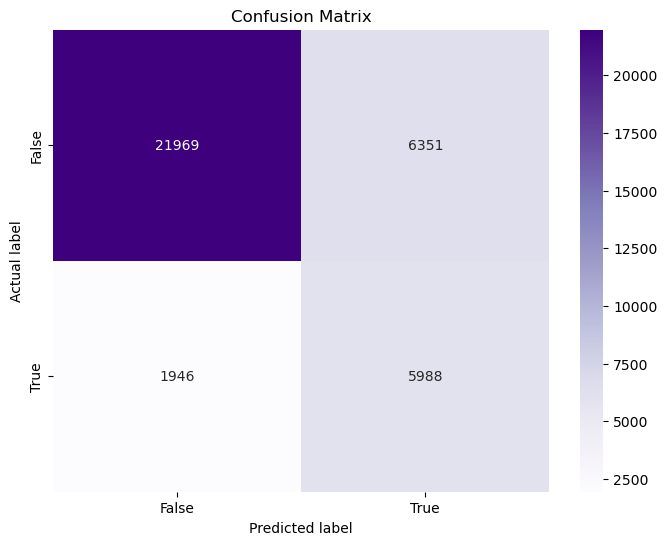

----------------------------------------------------------------------


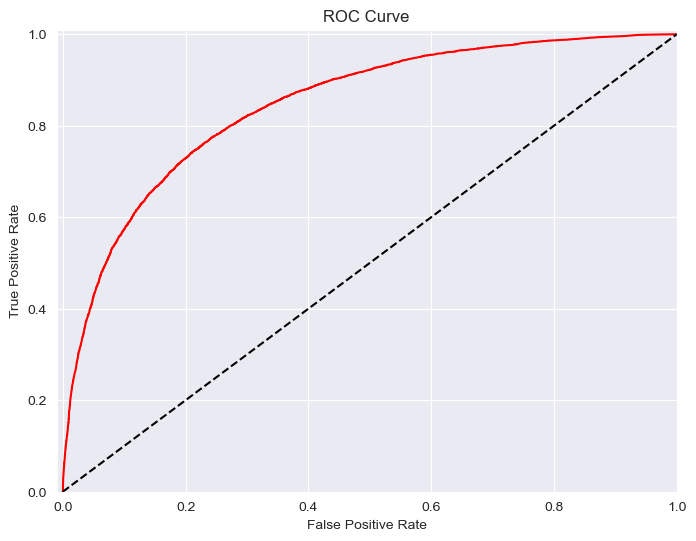

----------------------------------------------------------------------
Precision: 0.4853
Recall: 0.7547
F1 score: 0.5907
ROC-AUC score : 0.8463
----------------------------------------
Train score: 0.7721
Test score: 0.7711
----------------------------------------

Classification Report:
               precision    recall  f1-score   support

           0       0.92      0.78      0.84     28320
           1       0.49      0.75      0.59      7934

    accuracy                           0.77     36254
   macro avg       0.70      0.77      0.72     36254
weighted avg       0.82      0.77      0.79     36254

----------------------------------------------------------------------


In [195]:
results(forest_clf, y_pred, y_pred_proba, X_train, y_train, X_test, y_test)

#### n_estimators=4, max_depth=10

In [196]:
forest_clf = RandomForestClassifier(n_estimators=4, max_depth=10, random_state=0, class_weight=class_weights)

In [197]:
forest_clf.fit(X_train, y_train)

RandomForestClassifier(class_weight={0: 0.6397320414805844,
                                     1: 2.289138678223185},
                       max_depth=10, n_estimators=4, random_state=0)

In [198]:
y_pred = forest_clf.predict(X_test)
y_pred_proba = forest_clf.predict_proba(X_test)

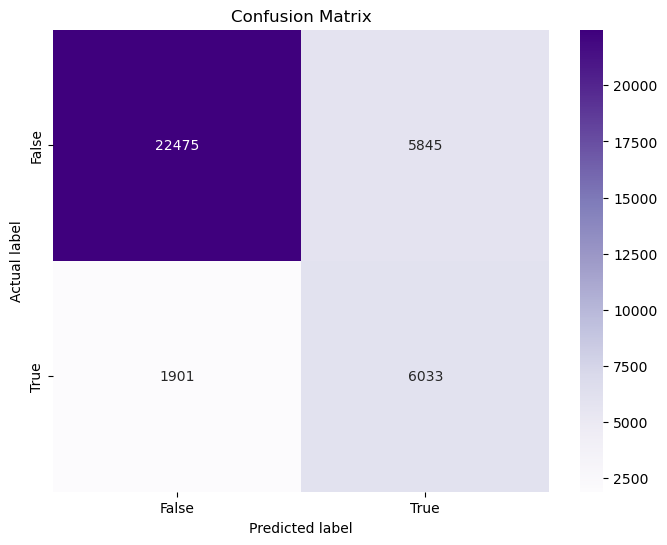

----------------------------------------------------------------------


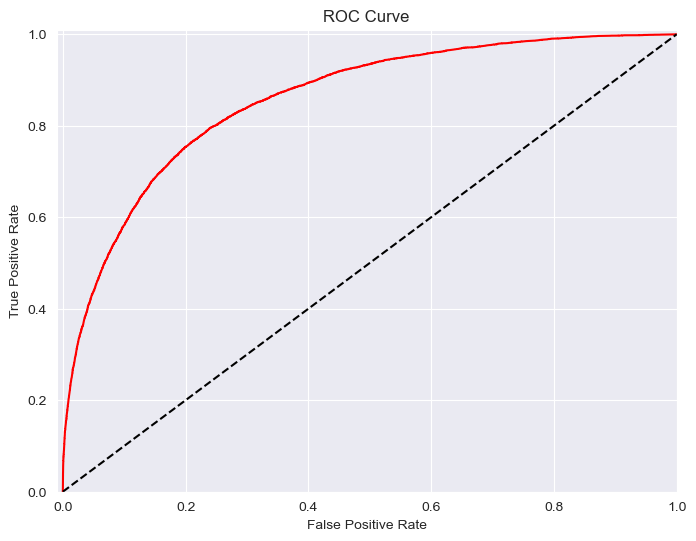

----------------------------------------------------------------------
Precision: 0.5079
Recall: 0.7604
F1 score: 0.6090
ROC-AUC score : 0.8569
----------------------------------------
Train score: 0.8022
Test score: 0.7863
----------------------------------------

Classification Report:
               precision    recall  f1-score   support

           0       0.92      0.79      0.85     28320
           1       0.51      0.76      0.61      7934

    accuracy                           0.79     36254
   macro avg       0.71      0.78      0.73     36254
weighted avg       0.83      0.79      0.80     36254

----------------------------------------------------------------------


In [199]:
results(forest_clf, y_pred, y_pred_proba, X_train, y_train, X_test, y_test)

The impact of increasing the values of estimators and max depth is beneficial for our model, as we observe an improvement in the results.

### Random Forest Classifier - Hyperparameters Tuning

In [200]:
forest_clf = RandomForestClassifier(random_state=0, class_weight=class_weights)

In [201]:
parameters={"bootstrap": [True, False],
            "max_depth": [4, 6, 8],
            "min_samples_leaf": [5, 10, 15],
            "n_estimators": [10, 20, 50]
           }

The "bootstrap" parameter was considered with both "True" and "False" values, allowing the evaluation of the impact of bootstrapping on model performance.

The "max_depth" parameter was explored with values of 4, 6, and 8 to assess the influence of tree depth on the complexity of the model. Simultaneously, the "min_samples_leaf" parameter was tested with values of 5, 10, and 15, representing the minimum number of samples required to form a leaf node. This parameter helps control overfitting by regulating the minimum size of leaf nodes.

Additionally, the "n_estimators" parameter was varied across values of 10, 20, and 50 to evaluate the impact of the number of trees in the ensemble on the model's predictive performance.

In [202]:
tuning_model = GridSearchCV(forest_clf, param_grid=parameters, 
                            refit="roc_auc", scoring=["f1", "roc_auc"], cv=5, n_jobs=-1)

In [203]:
tuning_model.fit(X_train, y_train)
tuning_model.best_params_

{'bootstrap': True, 'max_depth': 8, 'min_samples_leaf': 5, 'n_estimators': 50}

In [204]:
forest_clf_best_model = tuning_model.best_estimator_

In [205]:
y_pred = forest_clf_best_model.predict(X_test)
y_pred_proba = forest_clf_best_model.predict_proba(X_test)

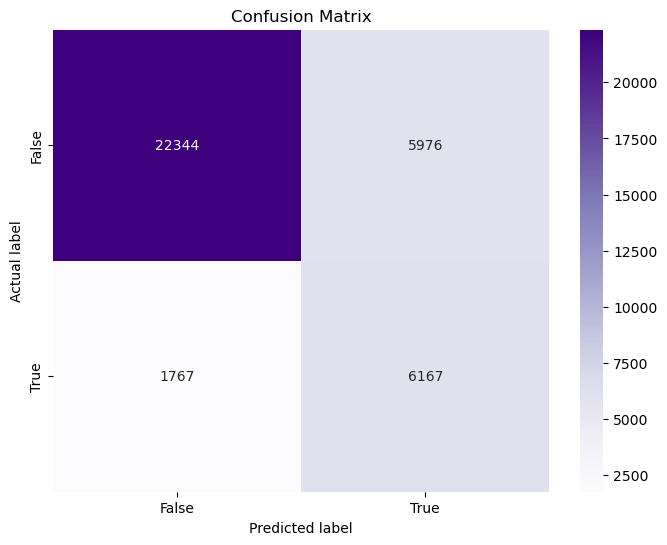

----------------------------------------------------------------------


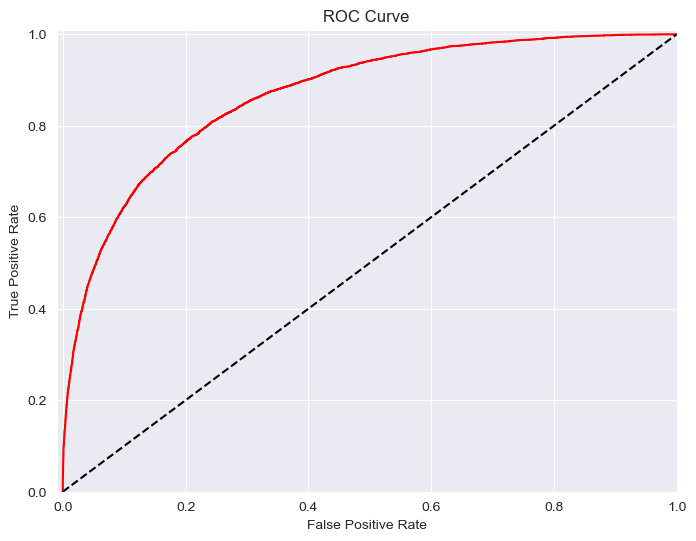

----------------------------------------------------------------------
Precision: 0.5079
Recall: 0.7773
F1 score: 0.6143
ROC-AUC score : 0.8678
----------------------------------------
Train score: 0.7940
Test score: 0.7864
----------------------------------------

Classification Report:
               precision    recall  f1-score   support

           0       0.93      0.79      0.85     28320
           1       0.51      0.78      0.61      7934

    accuracy                           0.79     36254
   macro avg       0.72      0.78      0.73     36254
weighted avg       0.84      0.79      0.80     36254

----------------------------------------------------------------------


In [206]:
results(forest_clf_best_model, y_pred, y_pred_proba, X_train, y_train, X_test, y_test)

### Random Forest Classifier - Features Importance - for best forest model

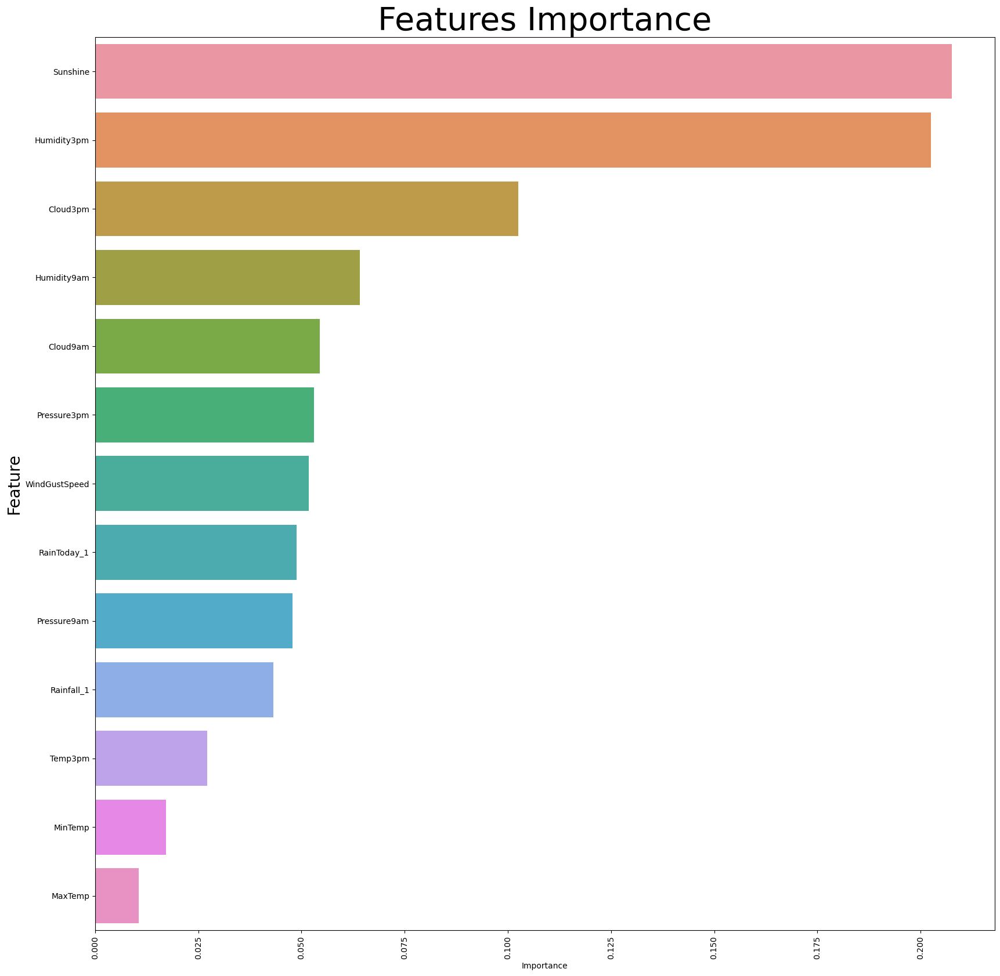

In [207]:
plot_feature_importance(forest_clf_best_model, X_train)

In this case, we observe more features with higher importance compared to the Decision Tree. The most significant features are again Sunshine and Humidity at 3pm, but additionally, Cloud at 3pm, Humidity at 9am, and Wind Gust Speed also exhibit notable importance.

---

### Boosting Classifier 

A LightGBM (LGBM) classifier was employed for boosting due to its efficiency and capability to handle large datasets. LGBM is a gradient boosting framework that uses tree-based learning algorithms, and it is known for its speed and ability to handle categorical features and large datasets with high dimensionality. The algorithm is optimized for parallel and distributed computing, making it well-suited for boosting applications.

#### n_estimators=6, max_depth=6

In [208]:
lgbm_clf = LGBMClassifier(n_estimators=6, max_depth=6, random_state=0, n_jobs=-1)

In [209]:
params = {"verbose": -1}
lgbm_clf.set_params(**params)

LGBMClassifier(max_depth=6, n_estimators=6, random_state=0, verbose=-1)

In [210]:
lgbm_clf.fit(X_train, y_train)

LGBMClassifier(max_depth=6, n_estimators=6, random_state=0, verbose=-1)

In [211]:
y_pred = lgbm_clf.predict(X_test)
y_pred_proba = lgbm_clf.predict_proba(X_test)

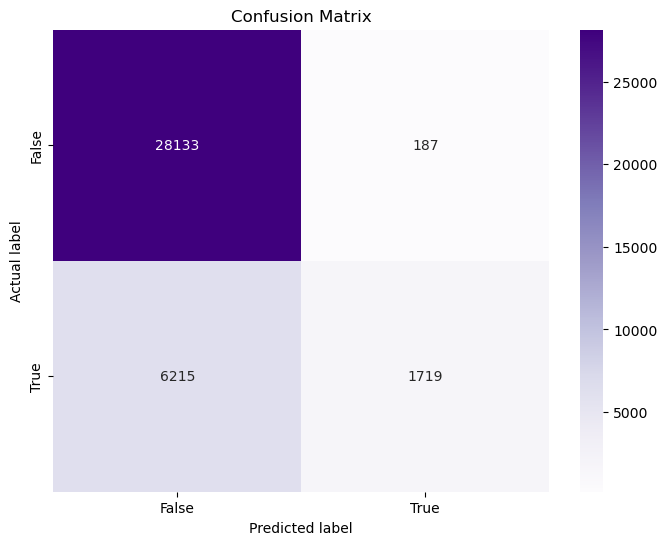

----------------------------------------------------------------------


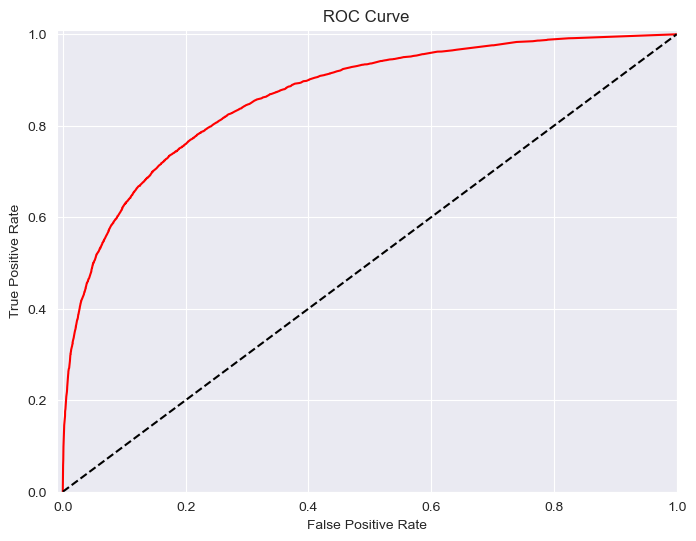

----------------------------------------------------------------------
Precision: 0.9019
Recall: 0.2167
F1 score: 0.3494
ROC-AUC score : 0.8654
----------------------------------------
Train score: 0.8219
Test score: 0.8234
----------------------------------------

Classification Report:
               precision    recall  f1-score   support

           0       0.82      0.99      0.90     28320
           1       0.90      0.22      0.35      7934

    accuracy                           0.82     36254
   macro avg       0.86      0.61      0.62     36254
weighted avg       0.84      0.82      0.78     36254

----------------------------------------------------------------------


In [212]:
results(lgbm_clf, y_pred, y_pred_proba, X_train, y_train, X_test, y_test)

#### n_estimators=20, max_depth=6

In [213]:
lgbm_clf = LGBMClassifier(n_estimators=20, max_depth=6, random_state=0, n_jobs=-1)

In [214]:
params = {"verbose": -1}
lgbm_clf.set_params(**params)

LGBMClassifier(max_depth=6, n_estimators=20, random_state=0, verbose=-1)

In [215]:
lgbm_clf.fit(X_train, y_train)

LGBMClassifier(max_depth=6, n_estimators=20, random_state=0, verbose=-1)

In [216]:
y_pred = lgbm_clf.predict(X_test)
y_pred_proba = lgbm_clf.predict_proba(X_test)

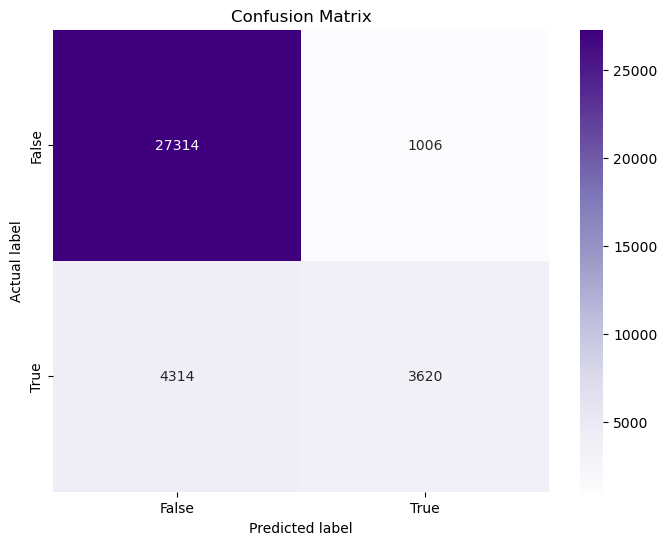

----------------------------------------------------------------------


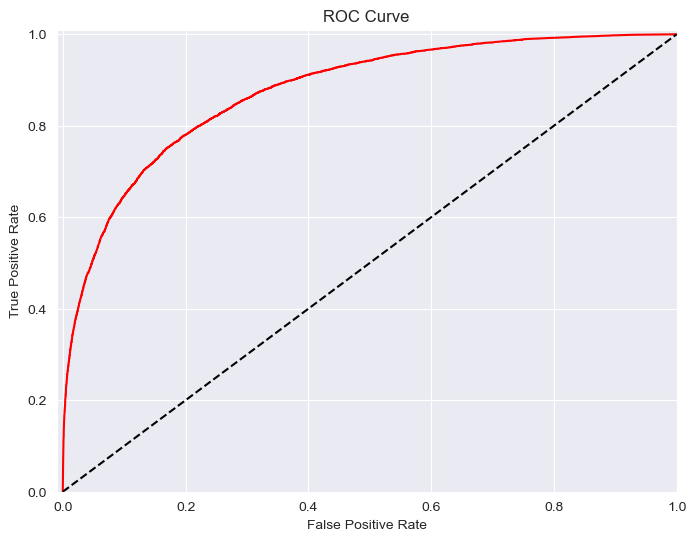

----------------------------------------------------------------------
Precision: 0.7825
Recall: 0.4563
F1 score: 0.5764
ROC-AUC score : 0.8755
----------------------------------------
Train score: 0.8539
Test score: 0.8533
----------------------------------------

Classification Report:
               precision    recall  f1-score   support

           0       0.86      0.96      0.91     28320
           1       0.78      0.46      0.58      7934

    accuracy                           0.85     36254
   macro avg       0.82      0.71      0.74     36254
weighted avg       0.85      0.85      0.84     36254

----------------------------------------------------------------------


In [217]:
results(lgbm_clf, y_pred, y_pred_proba, X_train, y_train, X_test, y_test)

Increasing the number of estimators can slightly improve the model's results.

### LightGBM Classifier - Hyperparameters Tuning

In [218]:
lgbm_clf = LGBMClassifier(random_state=0, class_weight=class_weights, n_jobs=-1)

In [219]:
params = {"verbose": -1}
lgbm_clf.set_params(**params)

LGBMClassifier(class_weight={0: 0.6397320414805844, 1: 2.289138678223185},
               random_state=0, verbose=-1)

In [220]:
parameters={"n_estimators": [50, 100],
            "max_depth": [2, 3, 4],
            "learning_rate": [0.01, 0.05, 0.1],
            "min_samples_leaf": [10, 15]
           }

The "n_estimators" parameter was varied between 50 and 100 to assess the impact of the number of boosting rounds on the model's predictive performance.

The "max_depth" parameter was explored with values of 2, 3, and 4, providing insights into the influence of tree depth on the complexity of the model. Simultaneously, the "learning_rate" hyperparameter was tested with values of 0.01, 0.05, and 0.1, representing the step size shrinkage at each boosting iteration. This helps analyze the trade-off between model training speed and accuracy.

Additionally, the "min_samples_leaf" parameter was explored with values of 10 and 15, indicating the minimum number of samples required to form a leaf node. This parameter contributes to controlling overfitting by ensuring a minimum amount of data is present in each leaf.

In [221]:
tuning_model = GridSearchCV(lgbm_clf, param_grid=parameters, 
                            refit="roc_auc", scoring=["f1", "roc_auc"], cv=5, n_jobs=-1)

In [222]:
tuning_model.fit(X_train, y_train)
tuning_model.best_params_

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=10, min_child_samples=20 will be ignored. Current value: min_data_in_

{'learning_rate': 0.05,
 'max_depth': 4,
 'min_samples_leaf': 15,
 'n_estimators': 50}

In [223]:
lgbm_clf_best_model = tuning_model.best_estimator_

In [224]:
y_pred = lgbm_clf_best_model.predict(X_test)
y_pred_proba = lgbm_clf_best_model.predict_proba(X_test)

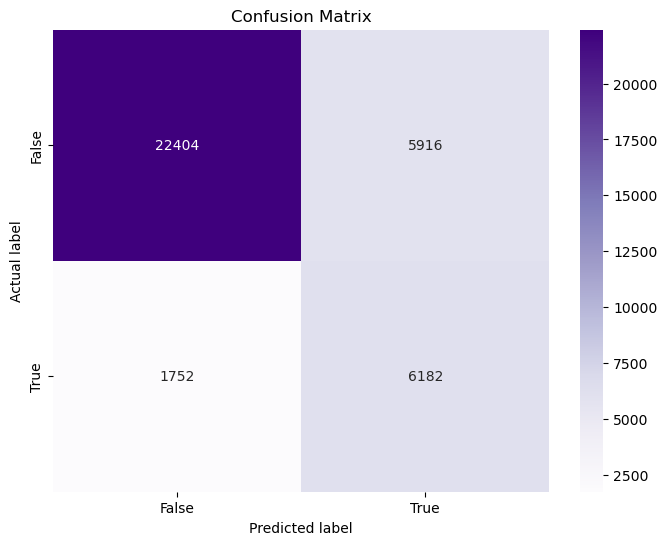

----------------------------------------------------------------------


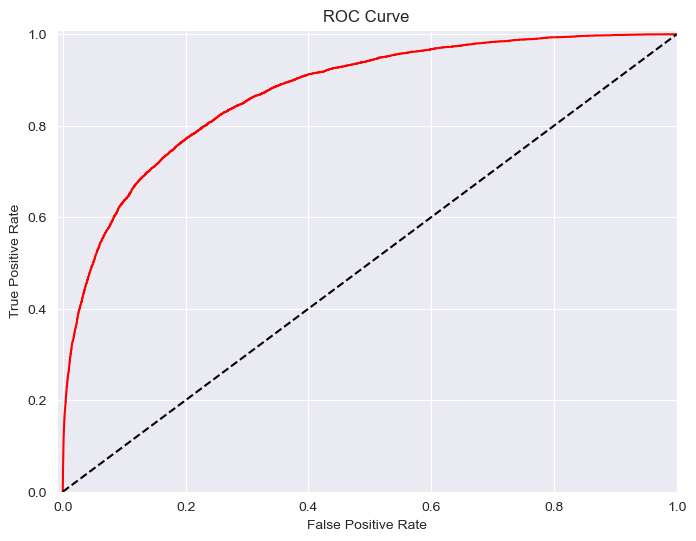

----------------------------------------------------------------------
Precision: 0.5110
Recall: 0.7792
F1 score: 0.6172
ROC-AUC score : 0.8726
----------------------------------------
Train score: 0.7927
Test score: 0.7885
----------------------------------------

Classification Report:
               precision    recall  f1-score   support

           0       0.93      0.79      0.85     28320
           1       0.51      0.78      0.62      7934

    accuracy                           0.79     36254
   macro avg       0.72      0.79      0.74     36254
weighted avg       0.84      0.79      0.80     36254

----------------------------------------------------------------------


In [225]:
results(lgbm_clf_best_model, y_pred, y_pred_proba, X_train, y_train, X_test, y_test)

A slightly better ROC-AUC result can be observed compared to some of the previous classification models.

### LightGBM Classifier - Features Importance - for best lgbm model

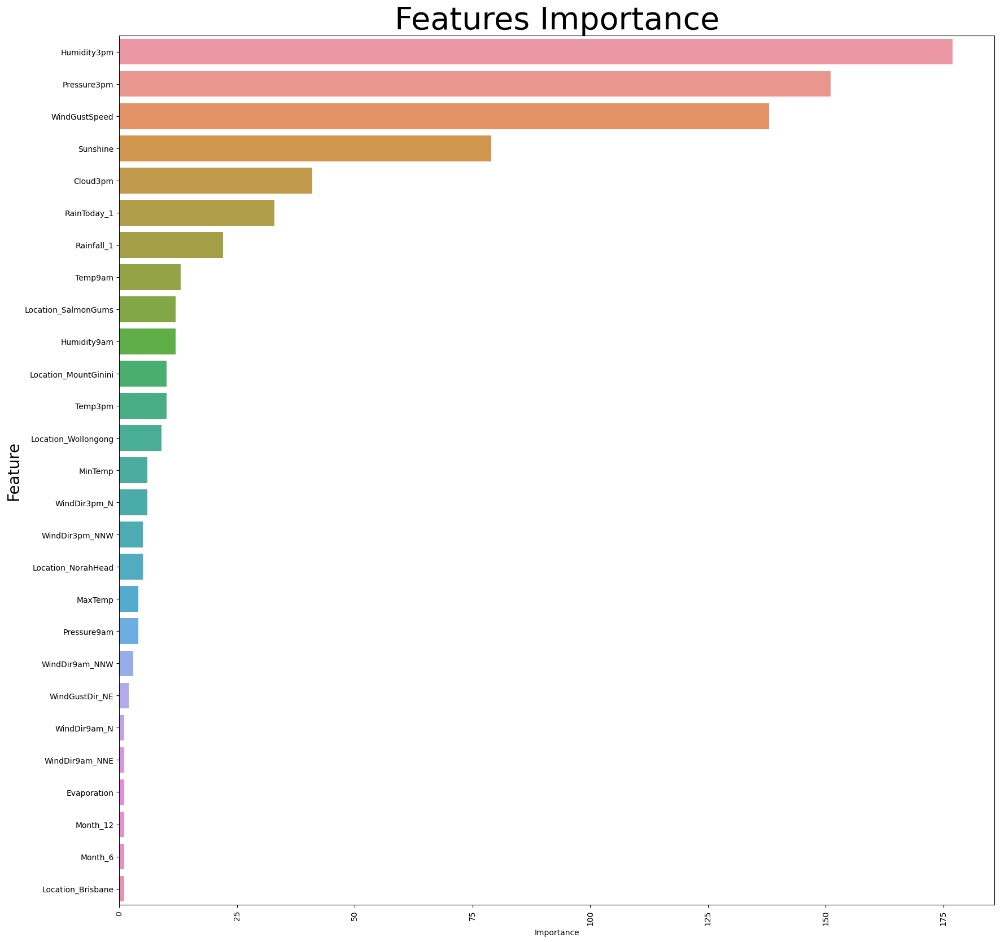

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=10, min_child_samples=20 will be ignored. Current value: min_data_in_

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=15, min_child_samples=20 will be ignored. Current value: min_data_in_

In [226]:
plot_feature_importance(lgbm_clf_best_model, X_train)

The majority of parameters have a significant impact on shaping the model to some extent.

---

## Models comparisons - from classification task and current tree-based models

In the realm of classification, nearly every model, whether from a previous classification task or the current analysis, achieved similar results. This can be attributed to the versatility of models in such datasets. Differences primarily arise in terms of execution time for certain algorithms; hence, classifiers based on decision trees or random forests prove to be much more efficient compared to, for instance, KNN or SVM. Probably the best choice remains Logistic Regression, given its highest ROC-AUC score and f1 score. Another strong contender is the Random Forest classifier, with a ROC-AUC score approaching 0.87, which ranks among the highest obtained values.